<a href="https://colab.research.google.com/github/shoreey/Air-Quality-Analysis-for-Local-Government/blob/main/air_quality_in_local_government.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analysis of Bradford Air Quality Data - Winter 2024/25

In [ ]:
# Task Overview:
# The goal was to analyze air quality data from Bradford, specifically focusing on PM2.5 and PM10 levels across multiple sites.
# The task included data cleaning, handling negative and missing values, and performing air quality analysis to provide insights for Bradford Council.

# I. Data Loading and Initial Exploration:
# - Loaded the Excel file into a pandas DataFrame.
# - Displayed the first few rows to get an overview of the data.
# - Checked the data types of each column to identify any issues (e.g., incorrect data types, missing values).

# II. Handling Negative Values (Data Cleaning):
# - Identified rows where PM2.5 or PM10 values were negative.
# - Analyzed negative value patterns by frequency across sites (Keighley, Tong Street, Treadwell Mills).
# - Investigated if negative values correlated with specific times or other variables (e.g., temperature).
# - Replaced all negative PM2.5 and PM10 values with 0, as negative values are physically impossible and the approach is conservative.
# - Analyzed instances where PM2.5 values were greater than PM10, isolated them, and investigated if these were measurement errors.

# III. Handling Missing Values:
# - Checked for missing data in PM2.5 and PM10 columns.
# - Examined the patterns of missing data, particularly for specific time periods or locations.
# - Developed an imputation strategy:
#   - For Keighley, used linear interpolation to impute missing values.
#   - For Tong Street, did not impute data between December 29th and January 3rd due to a known equipment removal.
#   - For Treadwell Mills, took into account that the device became operational after December 21st and adjusted the dataset accordingly.

# IV. Air Quality Analysis:
# - Analyzed PM10 exceedances based on air quality regulations (50 µg/m³ threshold for a 24-hour period).
#   - Identified and reported exceedances, with a focus on the spike observed on January 16th at Keighley and Treadwell Mills.
# - Analyzed PM2.5 levels, compared average concentrations at each site, and evaluated them against current and future regulatory targets (below 20 µg/m³, target below 12 µg/m³ by 2028).
# - Compared the PM10 and PM2.5 concentrations across the three monitoring sites and discussed notable differences.
# - Defined exposure categories (Low, Moderate, High) based on PM10/PM2.5 concentrations.
#   - Calculated the percentage of time people were exposed to each category at each site and presented the exposure statistics clearly.

# V. Summary of Findings:
# - Provided a summary of key insights:
#   - Data quality issues addressed (negative and missing values).
#   - PM10 exceedances and PM2.5 levels were compared to regulatory limits.
#   - Discussed site comparisons and exposure analysis results.

# VI. Further Analysis (If You Had More Time):
# - Suggested further analyses that could be performed with more time:
#   - Correlating air quality data with meteorological factors (e.g., temperature, wind speed).
#   - Investigating potential pollution sources in Bradford.
#   - Performing time series analysis to identify trends and seasonality.
#   - Developing predictive models for future air quality forecasts.



In [ ]:
# Step 1: Import Required Libraries

# Data manipulation and analysis
import pandas as pd  # pandas is used for working with data in a tabular form, performing operations like filtering, grouping, merging, etc.
import numpy as np   # numpy is used for numerical computations and handling arrays. It complements pandas when dealing with large numerical datasets.

# Data visualization
import matplotlib.pyplot as plt  # matplotlib is the fundamental library for creating static, interactive, and animated visualizations. We use it to create charts and plots.
import seaborn as sns  # seaborn is built on top of matplotlib and provides a high-level interface for creating attractive and informative visualizations. It's more user-friendly for advanced plots.
from matplotlib.ticker import FuncFormatter
import matplotlib.dates as mdates
import matplotlib as mpl
from matplotlib.dates import DateFormatter, WeekdayLocator, MO
# For handling missing data and outliers
from sklearn.impute import SimpleImputer  # SimpleImputer from sklearn is used for filling missing data (e.g., replacing missing values with the mean, median, etc.).

from scipy import stats  # scipy is a library used for scientific computations. We use it for statistical tests and handling outliers, among other tasks.

# To work with date and time
import datetime  # datetime helps in manipulating date and time data. It will be useful when we need to convert timestamps or extract specific date-related information.

# For managing warnings (if needed)
import warnings  # warnings library helps in managing warning messages. It can be used to suppress non-critical warnings that can clutter the output.
warnings.filterwarnings('ignore')  # This will suppress warnings in the notebook, keeping the output clean.

# For creating pie charts
from matplotlib.patches import Patch  # Used for customizing the pie chart (e.g., adding custom legend and styling).


In [ ]:
# Step 2: Importing the Dataset

# Loading the dataset from a local drive using pandas
# The 'read_excel' function is used to load data from an Excel file (.xlsx format).
# Here, we're reading the air quality data for Bradford from the specified file path.

bradford = pd.read_excel("air_quality_bradford.xlsx")

# Explanation:
# 'pd.read_excel' is a pandas function that reads an Excel file into a pandas DataFrame.
# A DataFrame is like a table, and it's the main data structure used in pandas for handling structured data.
# You need to provide the full path to the file (in this case, "bradford.xlsx").
# Ensure that the file path is correct and the file is accessible from the location you are running the code.
# In case you're using a Jupyter notebook, it's often better to provide a relative path if the dataset is within the project folder.


In [ ]:
# Step 3: Verifying the Dataset Import

# Check the first few rows of the dataset to ensure it has been loaded correctly
# We use the 'head()' function to display the top 5 rows of the dataset

bradford.head()

# Explanation:
# 'bradford.head()' returns the first 5 rows of the dataset (DataFrame).
# This is a useful method to quickly preview the structure and contents of the data to make sure it has been loaded correctly.
# It gives you a glimpse of the column names, the first few data entries, and helps confirm the file was imported properly.
# If the dataset is large, you can also specify a number to display more rows (e.g., 'head(10)' will show the first 10 rows).

# You can also use the 'info()' method to get a summary of the dataset including column names, data types, and number of non-null entries.
bradford.info()

# Explanation of 'info()':
# 'bradford.info()' provides a concise summary of the dataset.
# It tells you:
# 1. The column names.
# 2. The number of non-null entries (i.e., how many values are missing).
# 3. The data type of each column (e.g., integer, float, string).
# This is helpful for detecting missing data or any unexpected data types in the dataset.


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1848 entries, 0 to 1847
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Date Time                       1848 non-null   object 
 1   Bradford Keighley PM10          1793 non-null   float64
 2   Bradford Keighley PM2.5         1802 non-null   float64
 3   Bradford Tong Street PM10       1466 non-null   float64
 4   Bradford Tong Street PM2.5      1438 non-null   float64
 5   Bradford Treadwell Mills PM10   648 non-null    float64
 6   Bradford Treadwell Mills PM2.5  648 non-null    float64
dtypes: float64(6), object(1)
memory usage: 101.2+ KB


In [ ]:
# Step 4: Creating a backup of the original data frame for safety

# Create a copy of the original DataFrame before making changes
bradford_original = bradford.copy()

# Explanation:
# We are creating a backup (bradford_original) to preserve the original dataset.
# This allows us to revert any changes if something goes wrong during data processing.

# Step 5: Replace '24:00' with '00:00' and increment the date

# Split 'Date Time' into 'Time' and 'Date'
bradford[['Time', 'Date']] = bradford['Date Time'].str.split(' ', expand=True)

# Identify rows where time is '24:00'
mask = bradford['Time'] == '24:00'

# Replace '24:00' with '00:00'
bradford.loc[mask, 'Time'] = '00:00'

# Increment the date for affected rows
bradford.loc[mask, 'Date'] = (pd.to_datetime(bradford.loc[mask, 'Date'], format='%d/%m/%Y') + pd.Timedelta(days=1)).dt.strftime('%d/%m/%Y')

# Merge 'Time' and 'Date' back into 'Date Time'
bradford['Date Time'] = bradford['Time'] + ' ' + bradford['Date']

# Convert 'Date Time' to datetime format
bradford['Date Time'] = pd.to_datetime(bradford['Date Time'], format='%H:%M %d/%m/%Y', errors='coerce')

# Drop temporary 'Time' and 'Date' columns
bradford.drop(columns=['Time', 'Date'], inplace=True)

# Check data types
print(bradford.dtypes)

# Show the first few rows
print(bradford.head())


Date Time                         datetime64[ns]
Bradford Keighley PM10                   float64
Bradford Keighley PM2.5                  float64
Bradford Tong Street PM10                float64
Bradford Tong Street PM2.5               float64
Bradford Treadwell Mills PM10            float64
Bradford Treadwell Mills PM2.5           float64
dtype: object
            Date Time  Bradford Keighley PM10  Bradford Keighley PM2.5  \
0 2024-11-01 01:00:00                     6.2                      5.2   
1 2024-11-01 02:00:00                     1.0                     -0.9   
2 2024-11-01 03:00:00                     6.1                      4.6   
3 2024-11-01 04:00:00                     5.8                      4.2   
4 2024-11-01 05:00:00                     2.8                      1.0   

   Bradford Tong Street PM10  Bradford Tong Street PM2.5  \
0                       10.2                         5.8   
1                        2.1                        -1.3   
2                 

In [ ]:
# Step 6: Calculate descriptive statistics for the numeric columns in the 'bradford' DataFrame

# Select only the numeric columns (excluding non-numeric ones like 'Date' and 'Time')
numeric_columns = bradford.select_dtypes(include=[np.number])

# Calculate basic statistics (mean, std, min, max, and percentiles)
# This provides a summary of the distribution of each numeric column (e.g., air quality metrics like PM2.5, PM10)
bradford_stats = numeric_columns.describe()

# Skewness: Measures the asymmetry of the distribution of the data
# Positive skew indicates the tail of the distribution is to the right, while negative skew means it's to the left
# Skewness near 0 suggests a symmetric distribution.
skewness = numeric_columns.skew()

# Kurtosis: Measures the "tailedness" of the distribution
# Kurtosis > 3 suggests heavy tails or more outliers (leptokurtic distribution), and kurtosis < 3 suggests light tails (platykurtic distribution)
kurtosis_vals = numeric_columns.kurtosis()

# Calculate percentiles: These help understand how the data is spread across different thresholds
# We calculate the 25th, 50th (median), 75th, 90th, 95th, and 99th percentiles
# Percentiles help understand the spread of the data and can reveal the presence of extreme values.
percentiles = numeric_columns.quantile([0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

# Step 6.1: Combine the results into one summary DataFrame for easy comparison and reporting
summary_stats = pd.DataFrame({
    'Mean': bradford_stats.loc['mean'],                 # The average of the values in each column
    'Standard Deviation': bradford_stats.loc['std'],    # The spread or variability of the data
    'Min': bradford_stats.loc['min'],                   # The smallest value in the data
    '25th Percentile': percentiles.loc[0.25],           # The 25th percentile (lower quartile)
    '50th Percentile (Median)': percentiles.loc[0.5],   # The median or the 50th percentile (middle value)
    '75th Percentile': percentiles.loc[0.75],           # The 75th percentile (upper quartile)
    '90th Percentile': percentiles.loc[0.9],            # The 90th percentile
    '95th Percentile': percentiles.loc[0.95],           # The 95th percentile
    '99th Percentile': percentiles.loc[0.99],           # The 99th percentile (almost at the top of the distribution)
    'Max': bradford_stats.loc['max'],                   # The largest value in the data
    'Skewness': skewness,                               # Asymmetry of the distribution
    'Kurtosis': kurtosis_vals                           # Tailedness of the distribution
})

# Step 6.2: Display the summary statistics
# This summary gives us an overview of the data's distribution, including central tendency, spread, and shape.
# It helps us understand the overall structure of the data and can highlight potential issues like skewness or outliers.
print(summary_stats)


                                     Mean  Standard Deviation  Min  \
Bradford Keighley PM10          13.660067           15.789277 -4.0   
Bradford Keighley PM2.5          9.294395            9.814140 -3.9   
Bradford Tong Street PM10       13.475102           13.935066 -3.3   
Bradford Tong Street PM2.5       7.224687           10.239078 -4.7   
Bradford Treadwell Mills PM10   15.077623           25.076011  0.3   
Bradford Treadwell Mills PM2.5   8.868827            9.482111  0.3   

                                25th Percentile  50th Percentile (Median)  \
Bradford Keighley PM10                    5.500                       9.9   
Bradford Keighley PM2.5                   3.000                       6.2   
Bradford Tong Street PM10                 5.225                       9.6   
Bradford Tong Street PM2.5                1.800                       4.5   
Bradford Treadwell Mills PM10             4.700                       8.9   
Bradford Treadwell Mills PM2.5            2.800

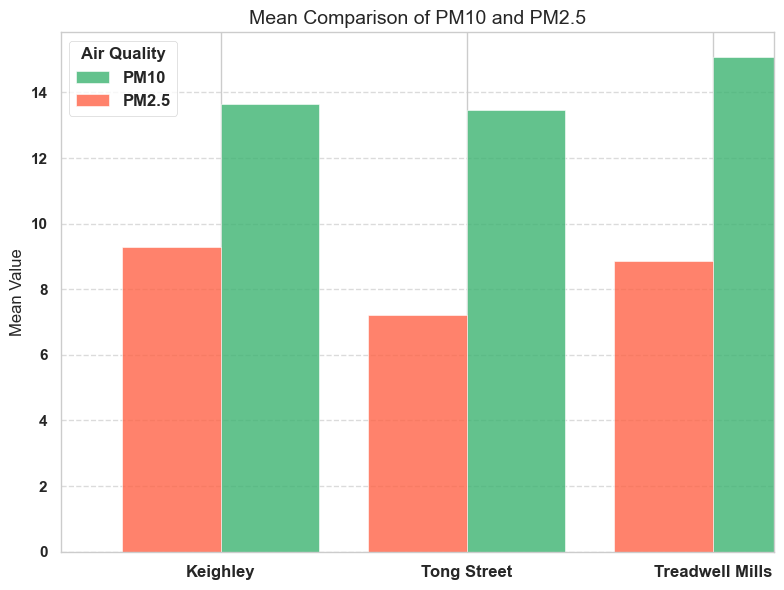

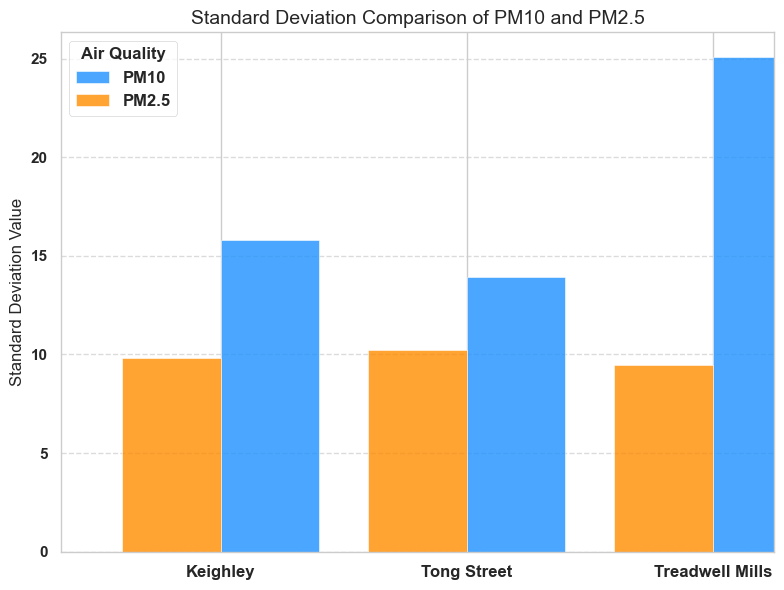

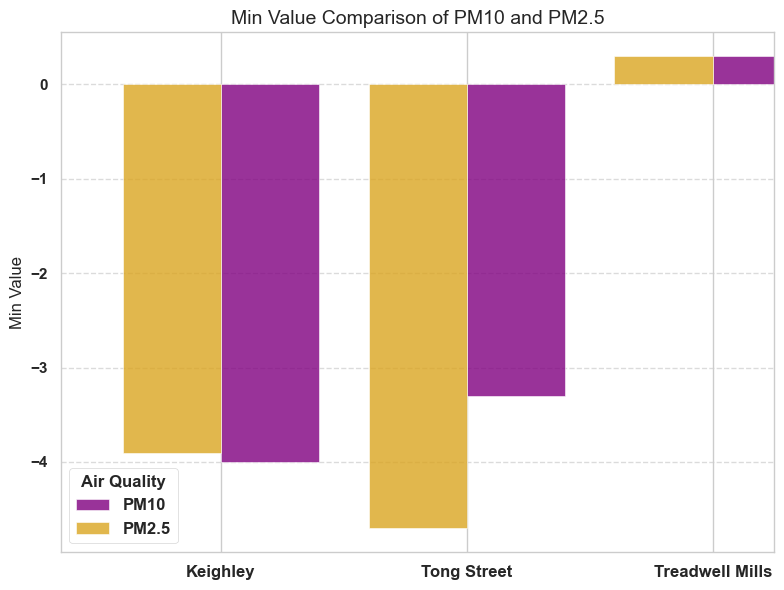

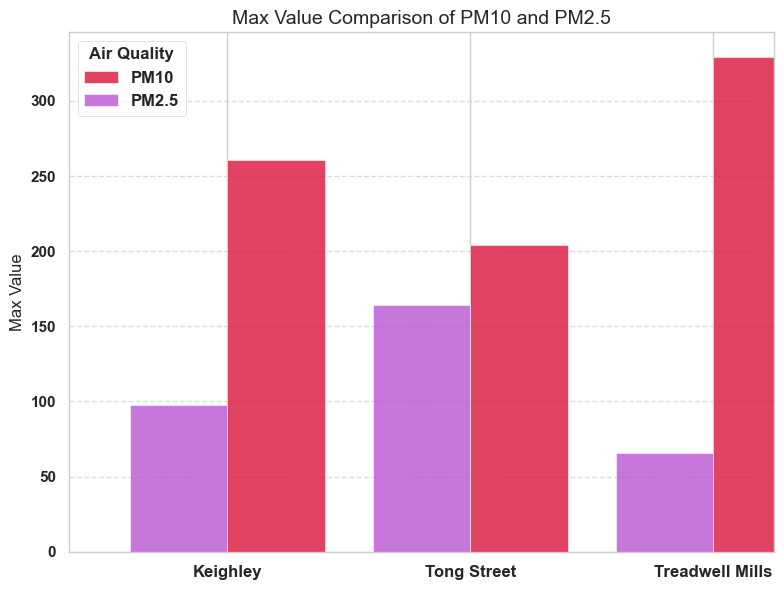

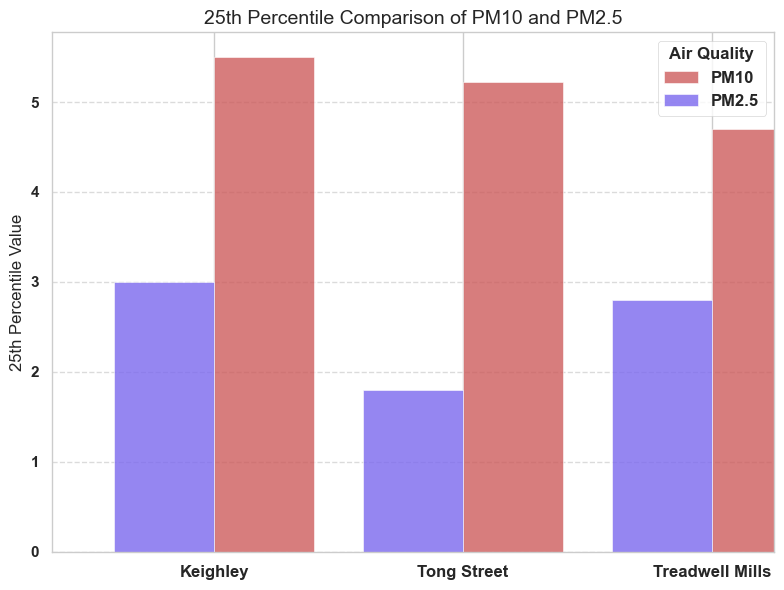

...

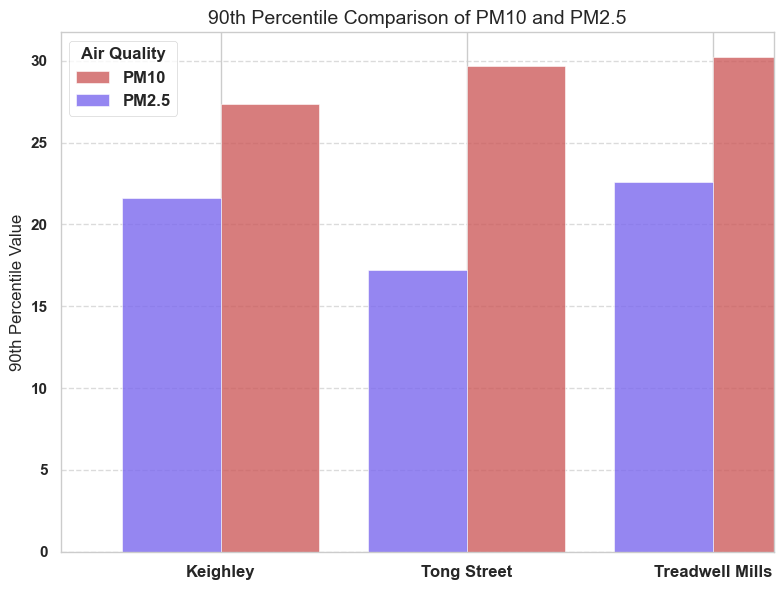

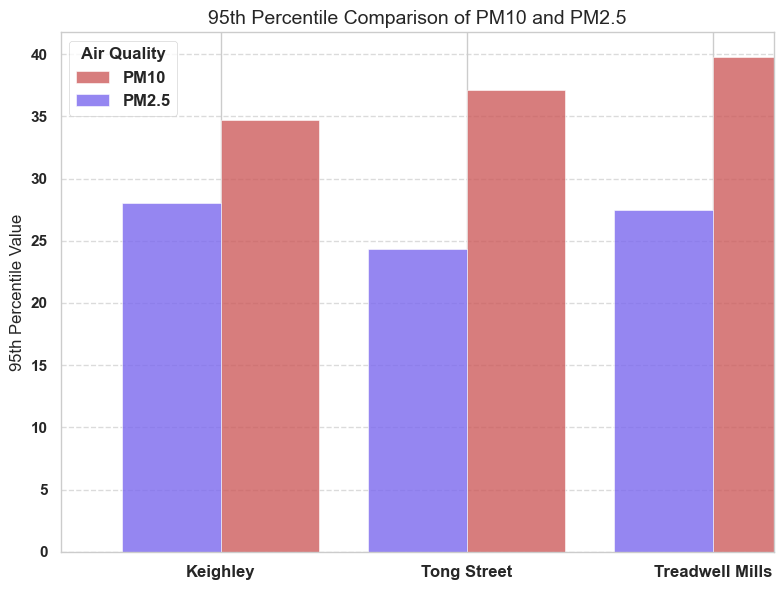

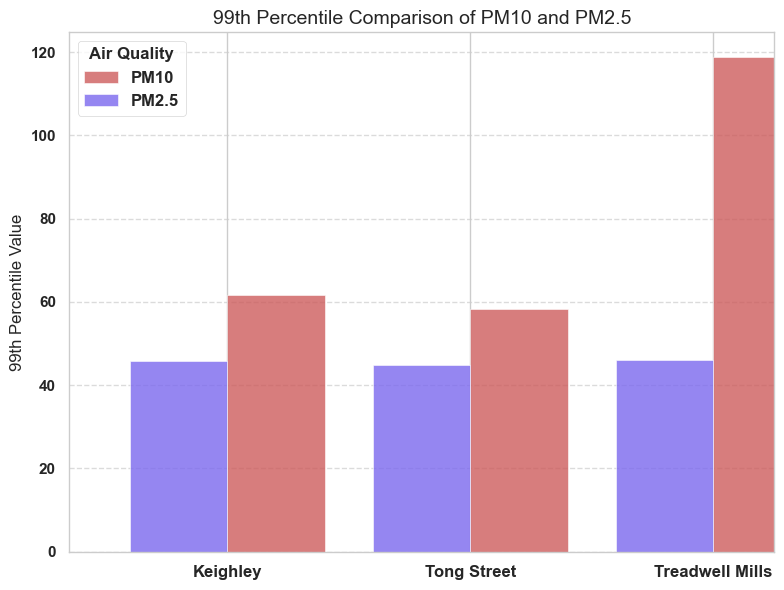

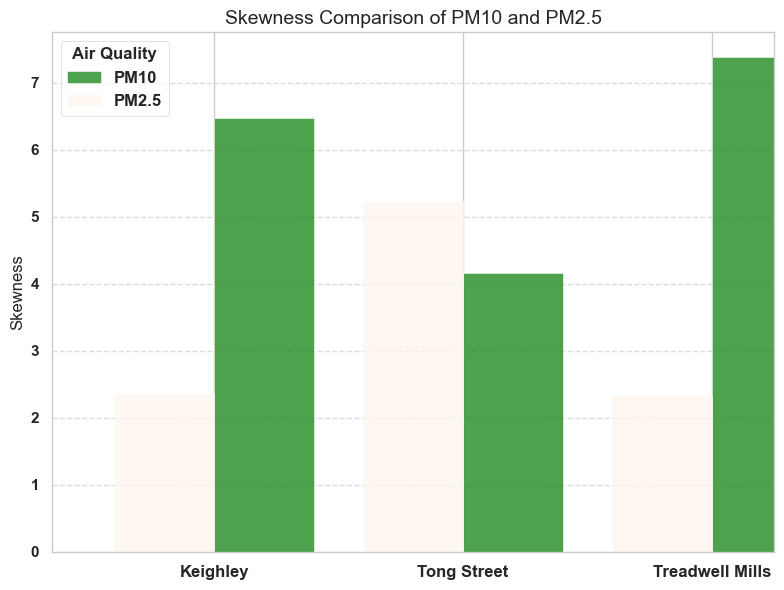

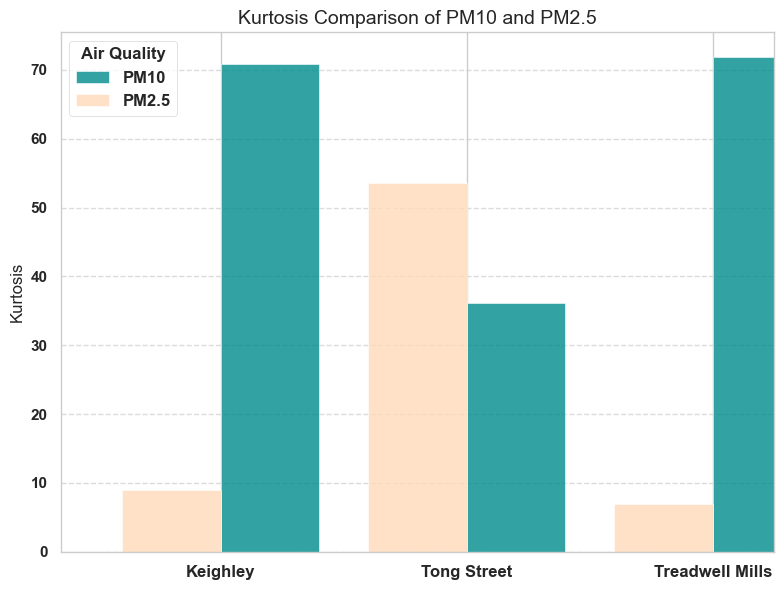

In [ ]:
# Step 7 : Plotting the Stats Results for better understanding
# Set style for better visuals
# 'whitegrid' style provides a clean grid layout for better readability of plots
sns.set_style("whitegrid")

# Define the columns for PM10 and PM2.5 statistics
# These are the specific columns representing PM10 and PM2.5 data from different locations
pm10_columns = ['Bradford Keighley PM10', 'Bradford Tong Street PM10', 'Bradford Treadwell Mills PM10']
pm25_columns = ['Bradford Keighley PM2.5', 'Bradford Tong Street PM2.5', 'Bradford Treadwell Mills PM2.5']

# Extracting the relevant summary statistics for PM10 and PM2.5
# We select summary statistics (like mean, standard deviation, etc.) for PM10 and PM2.5 from the precomputed summary_stats DataFrame
pm10_stats = summary_stats.loc[pm10_columns, ['Mean', 'Standard Deviation', 'Min', 'Max',
                                               '25th Percentile', '50th Percentile (Median)', '75th Percentile',
                                               '90th Percentile', '95th Percentile', '99th Percentile',
                                               'Skewness', 'Kurtosis']]

pm25_stats = summary_stats.loc[pm25_columns, ['Mean', 'Standard Deviation', 'Min', 'Max',
                                               '25th Percentile', '50th Percentile (Median)', '75th Percentile',
                                               '90th Percentile', '95th Percentile', '99th Percentile',
                                               'Skewness', 'Kurtosis']]

# Create a list of locations for x-axis labeling in the bar plots
# This list will be used to label the x-axis of each bar plot
locations = ['Keighley', 'Tong Street', 'Treadwell Mills']

# Now, let's break down the steps of visualizing the summary statistics for PM10 and PM2.5

# Step 7.1: Plot Mean Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# Plotting the Mean comparison for PM10 and PM2.5 with different colors
# PM10 is plotted in 'mediumseagreen', PM2.5 in 'tomato' for clear distinction
pm10_stats['Mean'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='mediumseagreen')
pm25_stats['Mean'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='tomato')
# Set the title and labels
plt.title("Mean Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Mean Value", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()  # Ensures the layout is optimized and not cropped
plt.show()  # Display the plot

# Step 7.2: Plot Standard Deviation Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# PM10 standard deviation is plotted in 'dodgerblue', PM2.5 in 'darkorange'
pm10_stats['Standard Deviation'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='dodgerblue')
pm25_stats['Standard Deviation'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='darkorange')
# Title and labels for this plot
plt.title("Standard Deviation Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Standard Deviation Value", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Step 7.3: Plot Min Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# PM10 min value is plotted in 'purple', PM2.5 in 'goldenrod'
pm10_stats['Min'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='purple')
pm25_stats['Min'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='goldenrod')
# Title and labels
plt.title("Min Value Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Min Value", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Step 7.4: Plot Max Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# PM10 max value is plotted in 'crimson', PM2.5 in 'mediumorchid'
pm10_stats['Max'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='crimson')
pm25_stats['Max'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='mediumorchid')
# Title and labels
plt.title("Max Value Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Max Value", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Step 7.5: Plot Percentiles (25th, 50th, 75th, 90th, 95th, 99th) Comparison
percentiles = ['25th Percentile', '50th Percentile (Median)', '75th Percentile', '90th Percentile', '95th Percentile', '99th Percentile']
for percentile in percentiles:
    plt.figure(figsize=(8, 6))
    # PM10 percentiles are plotted in 'indianred', PM2.5 in 'mediumslateblue'
    pm10_stats[percentile].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='indianred')
    pm25_stats[percentile].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='mediumslateblue')
    # Title and labels for each percentile plot
    plt.title(f"{percentile} Comparison of PM10 and PM2.5", fontsize=14)
    plt.ylabel(f"{percentile} Value", fontsize=12)
    plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
    plt.legend(title="Air Quality", fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Step 7.6: Plot Skewness Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# PM10 skewness is plotted in 'forestgreen', PM2.5 in 'seashell'
pm10_stats['Skewness'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='forestgreen')
pm25_stats['Skewness'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='seashell')
# Title and labels
plt.title("Skewness Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Skewness", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Step 7.7: Plot Kurtosis Comparison for PM10 vs PM2.5
plt.figure(figsize=(8, 6))
# PM10 kurtosis is plotted in 'darkcyan', PM2.5 in 'peachpuff'
pm10_stats['Kurtosis'].plot(kind='bar', position=0, width=0.4, alpha=0.8, label='PM10', color='darkcyan')
pm25_stats['Kurtosis'].plot(kind='bar', position=1, width=0.4, alpha=0.8, label='PM2.5', color='peachpuff')
# Title and labels
plt.title("Kurtosis Comparison of PM10 and PM2.5", fontsize=14)
plt.ylabel("Kurtosis", fontsize=12)
plt.xticks(np.arange(len(locations)), locations, rotation=0, fontsize=12)
plt.legend(title="Air Quality", fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
# **Negative Values in Minimum (Min) Column**:
# We observe negative values in the minimum column for PM10 and PM2.5 in several locations:
#   - Bradford Keighley PM10: -4.0
#   - Bradford Keighley PM2.5: -3.9
#   - Bradford Tong Street PM10: -3.3
#   - Bradford Tong Street PM2.5: -4.7
# These negative values are not realistic in the context of air quality measurements, as pollution levels (PM10, PM2.5) cannot be negative.
# These negative values might indicate data entry errors, measurement issues, or incorrect handling of missing values (e.g., using -999 or similar placeholders).
# Action: Address these negative values:
#   Option 1: Replace negative values with NaN (if they represent missing data).
#   Option 2: Set negative values to zero, if they are erroneous but should still be treated as zero.
#   Option 3: Check if these are placeholders for missing data and deal with them accordingly.

# **Treadwell Mills Clarification**:
# For the Treadwell Mills dataset, it is important to note that there were **no negative values found** in either PM10 or PM2.5.
# This means that the issue with negative values does not apply to this particular location, which could be an indication of better data quality or handling at this monitoring station.

# **Handling Missing Values**:
# The missing values identified might also be placeholders like -999. We need to handle these carefully, possibly through imputation or removal.
# Options include:
#   - Imputing missing values using techniques like mean, median, or regression imputation.
#   - Removing rows with missing data, but making sure not to lose too much critical information.

# **Skewness and Kurtosis**:
# High skewness (values above 1) indicates that PM10 data is more skewed than PM2.5 data, likely due to outliers.
# High kurtosis values indicate heavy tails, suggesting that there are extreme outliers influencing the dataset.
# In Treadwell Mills, the kurtosis for PM10 is very high (71.86), which suggests extreme outliers in this dataset as well.
# Potential actions to address skewness and kurtosis include applying log transformations or capping outliers.

# **Percentiles**:
# Significant gaps between the 75th and 99th percentiles for PM10 at various stations, including Treadwell Mills, highlight the presence of extreme values.
# We need to evaluate whether these outliers are actual events or errors and decide whether to keep or adjust them.


In [ ]:
# Step 8.1: Filter rows where either PM10 or PM2.5 values are negative for Bradford Keighley
# The goal is to identify any rows where PM10 or PM2.5 have negative values, which are not valid for air quality measurements.
# We are selecting rows where PM10 or PM2.5 is less than 0.
negative_values_keighley = bradford[
    (bradford['Bradford Keighley PM10'] < 0) |  # Check for negative PM10 values
    (bradford['Bradford Keighley PM2.5'] < 0)   # Check for negative PM2.5 values
].copy()  # Use .copy() to avoid the "SettingWithCopyWarning" in pandas when modifying the dataframe

# Step 8.2: Select relevant columns (Date Time and pollutant values)
# We only need the 'Date Time', 'Bradford Keighley PM10', and 'Bradford Keighley PM2.5' columns for analysis.
# This helps to keep our data focused on the issue of negative pollutant values.
negative_values_keighley = negative_values_keighley[['Date Time', 'Bradford Keighley PM10', 'Bradford Keighley PM2.5']]

# Step 8.3: Convert 'Date Time' column to datetime format
# The 'Date Time' column may not be in the datetime format, so we convert it to ensure it's usable for further time-based analysis.
# We use 'errors='coerce'' to handle invalid date formats by converting them to NaT (Not a Time).
negative_values_keighley['Date Time'] = pd.to_datetime(negative_values_keighley['Date Time'], errors='coerce')

# Step 8.4: Count negative PM10 values
# We filter the data where PM10 is less than 0 and then group by the 'Date Time' column (by day) to get the count for each date.
negative_pm10_count = negative_values_keighley[negative_values_keighley['Bradford Keighley PM10'] < 0].groupby(negative_values_keighley['Date Time'].dt.date).size()
print(f"Negative PM10 Count: \n{negative_pm10_count}\n")

# Step 8.5: Count negative PM2.5 values
# Similarly, we filter the data where PM2.5 is less than 0 and group by date to count the number of negative PM2.5 values for each day.
negative_pm25_count = negative_values_keighley[negative_values_keighley['Bradford Keighley PM2.5'] < 0].groupby(negative_values_keighley['Date Time'].dt.date).size()
print(f"Negative PM2.5 Count: \n{negative_pm25_count}\n")

# Step 8.6: Count where both PM10 and PM2.5 are negative together
# We filter rows where both PM10 and PM2.5 are less than 0 and group by 'Date Time' to see how often this occurs.
negative_both_count = negative_values_keighley[
    (negative_values_keighley['Bradford Keighley PM10'] < 0) &  # Both PM10 and PM2.5 must be negative
    (negative_values_keighley['Bradford Keighley PM2.5'] < 0)
].groupby(negative_values_keighley['Date Time'].dt.date).size()
print(f"Count of Both PM10 and PM2.5 Negative Together: \n{negative_both_count}\n")

# Step 8.7: Combine the counts into a summary DataFrame
# Here we combine the counts of negative PM10, negative PM2.5, and both negative in one DataFrame.
# We use .fillna(0) to ensure any missing values are filled with 0, indicating no negative values for that date.
summary = pd.DataFrame({
    'Negative PM10': negative_pm10_count,
    'Negative PM2.5': negative_pm25_count,
    'Both Negative': negative_both_count
}).fillna(0)  # Fill missing values with 0
print("Summary DataFrame:")
print(summary)

# Step 8.8: Calculate the total negative values in PM10 and PM2.5
# Here, we count how many total negative values there are for PM10 and PM2.5 in the entire dataset.
negative_pm10_total = (bradford['Bradford Keighley PM10'] < 0).sum()  # Count negative PM10 values
negative_pm25_total = (bradford['Bradford Keighley PM2.5'] < 0).sum()  # Count negative PM2.5 values

print(f"Total Negative Values in PM10: {negative_pm10_total}")
print(f"Total Negative Values in PM2.5: {negative_pm25_total}")

# Step 8.9: Find the most negative values (max negative)
# We extract the most negative value (i.e., minimum value) for both PM10 and PM2.5, which helps in identifying the worst-case scenario for the negative readings.
max_negative_pm10 = negative_values_keighley['Bradford Keighley PM10'].min()  # Most negative value in PM10
max_negative_pm25 = negative_values_keighley['Bradford Keighley PM2.5'].min()  # Most negative value in PM2.5

# Find the least negative values (i.e., closest to zero)
min_negative_pm10 = negative_values_keighley[negative_values_keighley['Bradford Keighley PM10'] < 0]['Bradford Keighley PM10'].max()  # Closest to zero in PM10
min_negative_pm25 = negative_values_keighley[negative_values_keighley['Bradford Keighley PM2.5'] < 0]['Bradford Keighley PM2.5'].max()  # Closest to zero in PM2.5

print(f"Maximum Negative PM10 Value: {max_negative_pm10}")
print(f"Minimum Negative PM10 Value (closest to zero): {min_negative_pm10}")
print(f"Maximum Negative PM2.5 Value: {max_negative_pm25}")
print(f"Minimum Negative PM2.5 Value (closest to zero): {min_negative_pm25}")

# Step 8.10: Count how many times both PM10 and PM2.5 had negative values simultaneously
# Finally, we count how many times both PM10 and PM2.5 were negative in the same row. This is useful for identifying concurrent measurement issues.
both_negative_count = len(negative_values_keighley[
    (negative_values_keighley['Bradford Keighley PM10'] < 0) &  # Both must be negative
    (negative_values_keighley['Bradford Keighley PM2.5'] < 0)
])

print(f"Times Both PM10 and PM2.5 Had Negative Values Simultaneously: {both_negative_count}")


Negative PM10 Count: 
Date Time
2024-11-24    2
2024-12-01    1
2024-12-05    1
2024-12-07    3
2024-12-08    2
2024-12-15    3
2024-12-19    1
2024-12-25    2
2025-01-01    1
2025-01-03    1
2025-01-05    7
2025-01-06    5
2025-01-08    1
dtype: int64

Negative PM2.5 Count: 
Date Time
2024-11-01    1
2024-11-15    1
2024-11-16    3
2024-11-17    4
2024-11-19    1
2024-11-22    1
2024-11-24    4
2024-11-26    1
2024-12-02    2
2024-12-05    2
2024-12-07    5
2024-12-08    2
2024-12-10    2
2024-12-11    1
2024-12-12    2
2024-12-15    5
2024-12-16    3
2024-12-18    3
2024-12-19    1
2024-12-20    1
2024-12-21    2
2024-12-22    2
2024-12-25    3
2024-12-29    3
2024-12-30    3
2024-12-31    4
2025-01-01    2
2025-01-03    1
2025-01-05    6
2025-01-06    5
2025-01-07    4
2025-01-08    1
dtype: int64

Count of Both PM10 and PM2.5 Negative Together: 
Date Time
2024-11-24    2
2024-12-05    1
2024-12-07    2
2024-12-15    2
2024-12-25    2
2025-01-01    1
2025-01-03    1
2025-01-05    5


Times and Dates when Both PM10 and PM2.5 Had Negative Values Simultaneously:
               Date Time  Bradford Keighley PM10  Bradford Keighley PM2.5
558  2024-11-24 07:00:00                    -0.7                     -1.4
561  2024-11-24 10:00:00                    -0.6                     -1.9
832  2024-12-05 17:00:00                    -0.6                     -1.6
874  2024-12-07 11:00:00                    -0.5                     -1.6
875  2024-12-07 12:00:00                    -1.3                     -1.5
1066 2024-12-15 11:00:00                    -0.8                     -1.2
1068 2024-12-15 13:00:00                    -0.1                     -1.2
1310 2024-12-25 15:00:00                    -1.0                     -1.6
1318 2024-12-25 23:00:00                    -0.1                     -0.4
1481 2025-01-01 18:00:00                    -0.3                     -0.7
1516 2025-01-03 05:00:00                    -0.1                     -2.1
1565 2025-01-05 06:00:00           

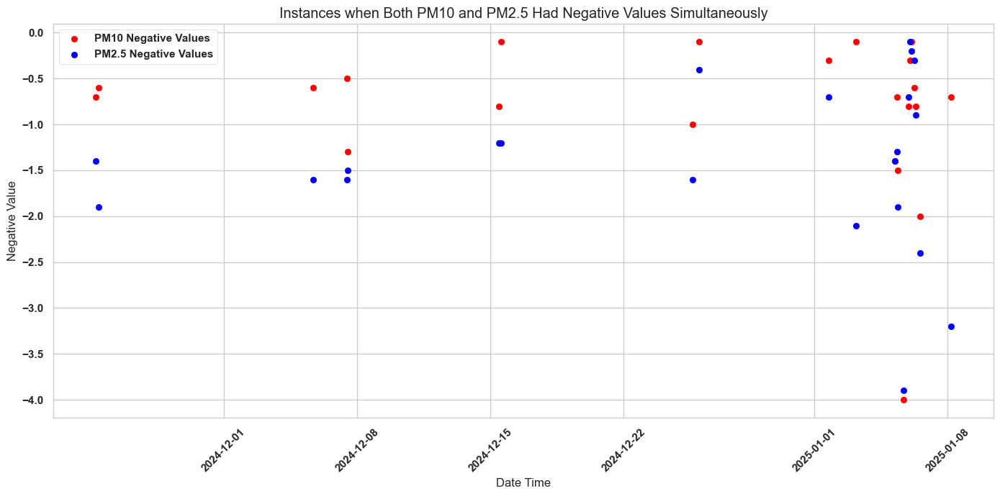

In [ ]:
#Step:9
# We found instances where PM10 and PM2.5 showed negative values in Bradford Keighley.
# The negative values represent erroneous or unexpected readings for both PM10 and PM2.5.
# These negative values might indicate sensor calibration issues, data logging errors, or anomalies.
# We have already identified the dates and instances when these negative values occurred.
# We found that:
# - PM10 has a total of 30 negative readings.
# - PM2.5 has a total of 81 negative readings.
# - On some occasions, both pollutants had negative values simultaneously, occurring 22 times in the data.
#
# This analysis is crucial because it indicates data quality issues that require attention.
# Such occurrences of negative values might distort the analysis of air quality, leading to misleading conclusions.
#
# The following data also shows the specific times and dates when both pollutants had negative values simultaneously:

print("Times and Dates when Both PM10 and PM2.5 Had Negative Values Simultaneously:")
print(both_negative_instances[['Date Time', 'Bradford Keighley PM10', 'Bradford Keighley PM2.5']])

# Now that we have identified these problematic instances, we need to visualize these occurrences
# to better understand their distribution over time.

# Scatter plot for the instances where both PM10 and PM2.5 had negative values
plt.figure(figsize=(14, 7))

# Scatter plot for PM10 negative values
plt.scatter(both_negative_instances['Date Time'], both_negative_instances['Bradford Keighley PM10'], label='PM10 Negative Values', color='red', marker='o')

# Scatter plot for PM2.5 negative values
plt.scatter(both_negative_instances['Date Time'], both_negative_instances['Bradford Keighley PM2.5'], label='PM2.5 Negative Values', color='blue', marker='o')

# Labels and title
plt.xlabel('Date Time')
plt.ylabel('Negative Value')
plt.title('Instances when Both PM10 and PM2.5 Had Negative Values Simultaneously')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend()
plt.tight_layout()

# Show the plot
plt.show()

# **Next Step Hint:**
# After visualizing the problematic instances, we will focus on investigating potential causes for these negative readings.
# Possible next steps could involve:
# - Investigating sensor calibration or maintenance records for anomalies.
# - Looking for patterns in weather, equipment malfunction, or other conditions that may have caused these data issues.
# - Attempting to correct these values (e.g., replacing them with imputed values or removing them) for a cleaner dataset.
# # Plot the distribution of hours when PM10 and PM2.5 had negative values for Keighley


Negative values in each column:
Bradford Keighley PM10: 30
Bradford Keighley PM2.5: 81
Bradford Tong Street PM10: 41
Bradford Tong Street PM2.5: 170

Minimum values for each column:
Bradford Keighley PM10: -4.0
Bradford Keighley PM2.5: -3.9
Bradford Tong Street PM10: -3.3
Bradford Tong Street PM2.5: -4.7

Negative PM10 and PM2.5 values for Keighley together: 22

Negative PM10 and PM2.5 values for Tong Street together: 30

Negative PM10 and PM2.5 values across all locations: 3


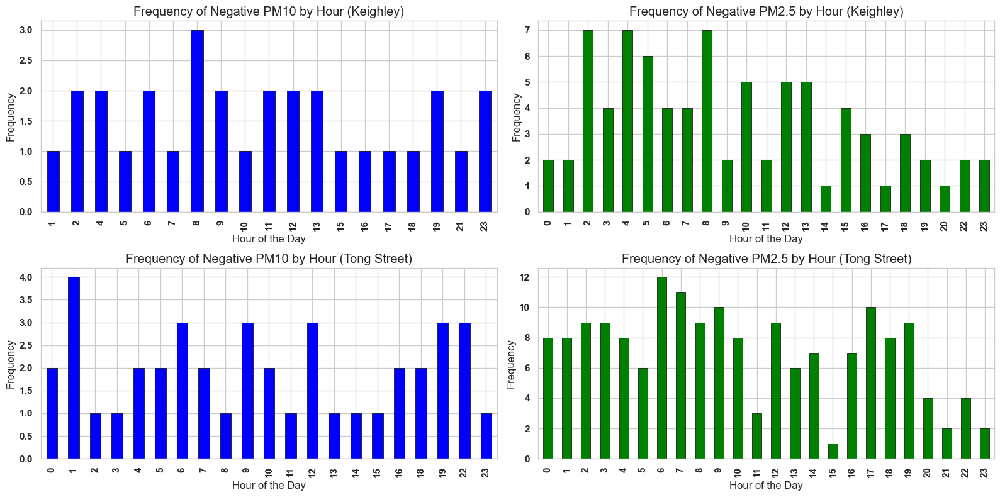

In [ ]:

#Step:10
# Assuming the data is loaded into a DataFrame 'bradford'
# bradford = pd.read_csv('path_to_your_data.csv')

# 1. Convert 'Date Time' to datetime format if it's not already
bradford['Date Time'] = pd.to_datetime(bradford['Date Time'])

# 2. Extract the hour from the 'Date Time' column
bradford['Hour'] = bradford['Date Time'].dt.hour

# 3. Count negative values in each column for all locations
negative_pm10_keighley = bradford[bradford['Bradford Keighley PM10'] < 0]
negative_pm2_5_keighley = bradford[bradford['Bradford Keighley PM2.5'] < 0]
negative_pm10_tong_street = bradford[bradford['Bradford Tong Street PM10'] < 0]
negative_pm2_5_tong_street = bradford[bradford['Bradford Tong Street PM2.5'] < 0]

# Count the negative values in each column
negative_counts = {
    'Bradford Keighley PM10': len(negative_pm10_keighley),
    'Bradford Keighley PM2.5': len(negative_pm2_5_keighley),
    'Bradford Tong Street PM10': len(negative_pm10_tong_street),
    'Bradford Tong Street PM2.5': len(negative_pm2_5_tong_street)
}

print("Negative values in each column:")
for col, count in negative_counts.items():
    print(f"{col}: {count}")

# 4. Identify minimum values in each column for all locations
min_values = {
    'Bradford Keighley PM10': bradford['Bradford Keighley PM10'].min(),
    'Bradford Keighley PM2.5': bradford['Bradford Keighley PM2.5'].min(),
    'Bradford Tong Street PM10': bradford['Bradford Tong Street PM10'].min(),
    'Bradford Tong Street PM2.5': bradford['Bradford Tong Street PM2.5'].min()
}

print("\nMinimum values for each column:")
for col, min_val in min_values.items():
    print(f"{col}: {min_val}")

# 5. Check how many times in a day there are negative values, grouped by hour
# Count negative values by hour for each location
negative_by_hour_keighley_pm10 = negative_pm10_keighley.groupby('Hour').size()
negative_by_hour_keighley_pm2_5 = negative_pm2_5_keighley.groupby('Hour').size()
negative_by_hour_tong_street_pm10 = negative_pm10_tong_street.groupby('Hour').size()
negative_by_hour_tong_street_pm2_5 = negative_pm2_5_tong_street.groupby('Hour').size()

# 6. Compare negative values in PM10 and PM2.5 for Keighley together
negative_keighley_combined = bradford[(bradford['Bradford Keighley PM10'] < 0) & (bradford['Bradford Keighley PM2.5'] < 0)]
print(f"\nNegative PM10 and PM2.5 values for Keighley together: {len(negative_keighley_combined)}")

# 7. Compare negative values in PM10 and PM2.5 for Tong Street together
negative_tong_street_combined = bradford[(bradford['Bradford Tong Street PM10'] < 0) & (bradford['Bradford Tong Street PM2.5'] < 0)]
print(f"\nNegative PM10 and PM2.5 values for Tong Street together: {len(negative_tong_street_combined)}")

# 8. Check for any negative values for PM10 and PM2.5 across all locations together
negative_all_combined = bradford[
    (bradford['Bradford Keighley PM10'] < 0) &
    (bradford['Bradford Keighley PM2.5'] < 0) &
    (bradford['Bradford Tong Street PM10'] < 0) &
    (bradford['Bradford Tong Street PM2.5'] < 0)
]
print(f"\nNegative PM10 and PM2.5 values across all locations: {len(negative_all_combined)}")

# 9. Frequency of negative values by hour for all locations
plt.figure(figsize=(16, 8))

# Keighley PM10
plt.subplot(2, 2, 1)
negative_by_hour_keighley_pm10.plot(kind='bar', color='blue', edgecolor='black')
plt.title('Frequency of Negative PM10 by Hour (Keighley)')
plt.xlabel('Hour of the Day')
plt.ylabel('Frequency')

# Keighley PM2.5
plt.subplot(2, 2, 2)
negative_by_hour_keighley_pm2_5.plot(kind='bar', color='green', edgecolor='black')
plt.title('Frequency of Negative PM2.5 by Hour (Keighley)')
plt.xlabel('Hour of the Day')
plt.ylabel('Frequency')

# Tong Street PM10
plt.subplot(2, 2, 3)
negative_by_hour_tong_street_pm10.plot(kind='bar', color='blue', edgecolor='black')
plt.title('Frequency of Negative PM10 by Hour (Tong Street)')
plt.xlabel('Hour of the Day')
plt.ylabel('Frequency')

# Tong Street PM2.5
plt.subplot(2, 2, 4)
negative_by_hour_tong_street_pm2_5.plot(kind='bar', color='green', edgecolor='black')
plt.title('Frequency of Negative PM2.5 by Hour (Tong Street)')
plt.xlabel('Hour of the Day')
plt.ylabel('Frequency')

# Show all plots
plt.tight_layout()
plt.show()


In [ ]:
#Step 11: # Analysis of negative values for PM10 and PM2.5

#The presence of negative values for PM10 and PM2.5 in the data is a clear indication of a data quality issue. These values are physically impossible for pollutant concentrations, so they must be errors.

#Key findings and their implications:

#1. **PM2.5 is the primary culprit**: Negative readings are significantly more frequent for PM2.5 than PM10 at both Keighley and Tong Street. This strongly suggests that the problem lies within the PM2.5 measurement system (sensor, data logger, etc.) rather than a general issue affecting both pollutants.

#2. **Time-of-day patterns are crucial**: The errors are not random; they exhibit clear time-of-day patterns. For both locations, negative PM2.5 readings are concentrated in the overnight and early morning hours, though the precise timing of peak errors differs slightly between Keighley and Tong Street. This strongly suggests a link to daily environmental cycles or instrument operation schedules.

#3. **Temperature sensitivity is a strong possibility**: Given the timing of the errors (overnight/early morning), temperature fluctuations are a prime suspect. Lower temperatures, rapid temperature changes, or even condensation could be affecting the PM2.5 instruments or the data logging system.

#4. **Other potential causes need consideration**: While temperature is a strong candidate, other possibilities include:
  # - Humidity changes
  # - Electrical fluctuations or power supply issues
  # - Automated calibration or maintenance cycles of the instruments

#5. **Investigation is paramount**: The priority should be a thorough investigation into the root cause of these negative readings. This should involve:
  # - Checking instrument calibration and maintenance logs.
  # - Examining the data logging system for errors or temperature-related bugs.
  # - Reviewing temperature and humidity data for correlations.
  # - Comparing data with nearby monitoring stations (if available).

#6. **Data correction is essential**: The negative values must be addressed before any meaningful air quality analysis can be performed. Simply removing the erroneous data points might introduce bias. A suitable imputation method, justified by the investigation findings, should be used.

#7. **Impact on analysis**: These data quality issues could severely compromise the reliability of any air quality analysis if left unaddressed. Any conclusions drawn from the data in its current state would be highly suspect.


# Printing the analysis of negative values
print(negative_values_analysis)

# Rest of your code for analysis
negative_by_hour_keighley_pm10 = negative_pm10_keighley.groupby('Hour').size()
negative_by_hour_keighley_pm2_5 = negative_pm2_5_keighley.groupby('Hour').size()
negative_by_hour_tong_street_pm10 = negative_pm10_tong_street.groupby('Hour').size()
negative_by_hour_tong_street_pm2_5 = negative_pm2_5_tong_street.groupby('Hour').size()

# Printing the counts of negative values by hour for each location
print("Negative Values by Hour for Keighley PM10:\n", negative_by_hour_keighley_pm10)
print("Negative Values by Hour for Keighley PM2.5:\n", negative_by_hour_keighley_pm2_5)
print("Negative Values by Hour for Tong Street PM10:\n", negative_by_hour_tong_street_pm10)
print("Negative Values by Hour for Tong Street PM2.5:\n", negative_by_hour_tong_street_pm2_5)



The presence of negative values for PM10 and PM2.5 in the data is a clear indication of a data quality issue. These values are physically impossible for pollutant concentrations, so they must be errors.

Key findings and their implications:

1. **PM2.5 is the primary culprit**: Negative readings are significantly more frequent for PM2.5 than PM10 at both Keighley and Tong Street. This strongly suggests that the problem lies within the PM2.5 measurement system (sensor, data logger, etc.) rather than a general issue affecting both pollutants.

2. **Time-of-day patterns are crucial**: The errors are not random; they exhibit clear time-of-day patterns. For both locations, negative PM2.5 readings are concentrated in the overnight and early morning hours, though the precise timing of peak errors differs slightly between Keighley and Tong Street. This strongly suggests a link to daily environmental cycles or instrument operation schedules.

3. **Temperature sensitivity is a strong possibilit

Percentage of cases where PM2.5 is less than PM10 in Keighley: 93.46%
Percentage of cases where PM2.5 is less than PM10 in Tong Street: 99.19%
Percentage of cases where PM2.5 is greater than PM10 in Keighley: 5.29%
Percentage of cases where PM2.5 is greater than PM10 in Tong Street: 0.51%


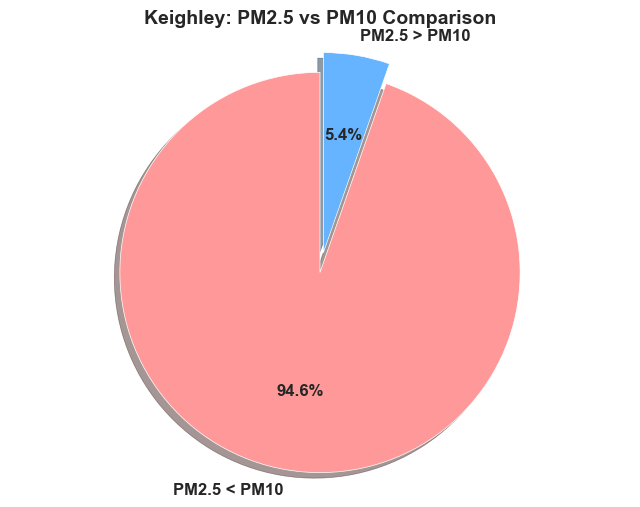

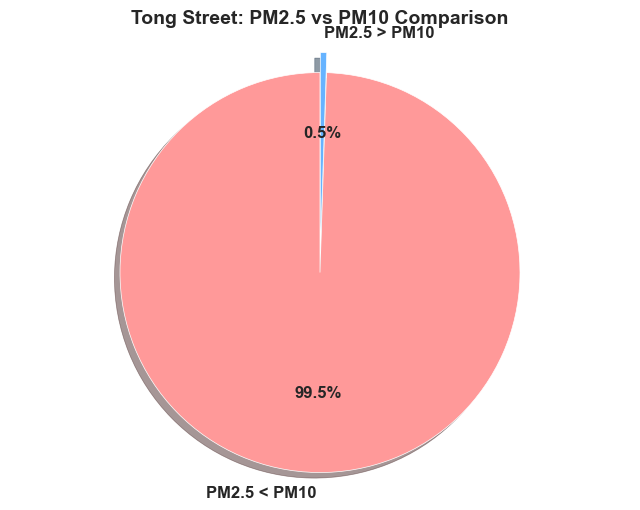

In [ ]:
#step 12 # Drop rows with missing values (NaN) for the relevant columns
# We don't want missing data to affect our analysis, so we'll exclude them before making the comparisons.
bradford_cleaned = bradford.dropna(subset=['Bradford Keighley PM2.5', 'Bradford Keighley PM10',
                                           'Bradford Tong Street PM2.5', 'Bradford Tong Street PM10'])
# Explanation: We drop the rows with missing values in the PM2.5 and PM10 columns for both Keighley and Tong Street.
# This ensures that our analysis is based only on rows with complete data to avoid incorrect results.

# Compare PM2.5 and PM10 for both Keighley and Tong Street
# Count how many times PM2.5 is less than PM10 for Keighley
keighley_less_than = (bradford_cleaned['Bradford Keighley PM2.5'] < bradford_cleaned['Bradford Keighley PM10']).sum()
# Explanation: Here we compare the PM2.5 values against the PM10 values for Keighley.
# This comparison checks how many times PM2.5 is less than PM10. We sum the `True` values, which represent the cases where PM2.5 is less than PM10.

# Count how many times PM2.5 is less than PM10 for Tong Street
tong_less_than = (bradford_cleaned['Bradford Tong Street PM2.5'] < bradford_cleaned['Bradford Tong Street PM10']).sum()
# Explanation: Similarly, we perform the comparison for Tong Street and count how many times PM2.5 is less than PM10.

# Total number of rows after dropping missing values
total_rows = len(bradford_cleaned)
# Explanation: We calculate the total number of rows after cleaning the data. This helps us compute the percentages in relation to the total number of valid rows.

# Calculate the percentage of cases where PM2.5 is less than PM10 in Keighley
keighley_percentage = (keighley_less_than / total_rows) * 100
# Explanation: The percentage is calculated by dividing the count of cases where PM2.5 is less than PM10 by the total number of valid rows.
# Then, we multiply by 100 to express it as a percentage.

# Calculate the percentage of cases where PM2.5 is less than PM10 in Tong Street
tong_percentage = (tong_less_than / total_rows) * 100
# Explanation: We calculate the percentage for Tong Street in the same way as we did for Keighley.

# Print the calculated percentages for cases where PM2.5 is less than PM10
print(f"Percentage of cases where PM2.5 is less than PM10 in Keighley: {keighley_percentage:.2f}%")
print(f"Percentage of cases where PM2.5 is less than PM10 in Tong Street: {tong_percentage:.2f}%")
# Explanation: We print the percentages for both Keighley and Tong Street to show how often PM2.5 is less than PM10.

# Now, let's analyze the opposite case: when PM2.5 is greater than PM10.
# Count how many times PM2.5 is greater than PM10 for Keighley
keighley_greater_than = (bradford_cleaned['Bradford Keighley PM2.5'] > bradford_cleaned['Bradford Keighley PM10']).sum()
# Explanation: We now calculate the number of times PM2.5 is greater than PM10 for Keighley.
# This step is the reverse comparison of the previous one.

# Count how many times PM2.5 is greater than PM10 for Tong Street
tong_greater_than = (bradford_cleaned['Bradford Tong Street PM2.5'] > bradford_cleaned['Bradford Tong Street PM10']).sum()
# Explanation: Similarly, we perform the greater-than comparison for Tong Street.

# Calculate the percentage of cases where PM2.5 is greater than PM10 in Keighley
keighley_percentage_greater = (keighley_greater_than / total_rows) * 100
# Explanation: We calculate the percentage of times PM2.5 is greater than PM10 in Keighley in the same way as before.

# Calculate the percentage of cases where PM2.5 is greater than PM10 in Tong Street
tong_percentage_greater = (tong_greater_than / total_rows) * 100
# Explanation: We calculate the percentage for Tong Street, too.

# Print the calculated percentages for cases where PM2.5 is greater than PM10
print(f"Percentage of cases where PM2.5 is greater than PM10 in Keighley: {keighley_percentage_greater:.2f}%")
print(f"Percentage of cases where PM2.5 is greater than PM10 in Tong Street: {tong_percentage_greater:.2f}%")
# Explanation: We print the percentages for both locations, showing how often PM2.5 is greater than PM10.

# Now let's create more presentable pie charts for the results

# Pie chart for Keighley
keighley_labels = ['PM2.5 < PM10', 'PM2.5 > PM10']
keighley_sizes = [keighley_percentage, keighley_percentage_greater]
# Explanation: We create labels and sizes for the pie chart based on the previously calculated percentages.
# These represent the categories of cases where PM2.5 is less than PM10 and where PM2.5 is greater than PM10.

# Create the pie chart for Keighley
plt.figure(figsize=(8, 6))  # Set the figure size for better clarity
# Explanation: We set the figure size to make the chart clearer and more readable.

plt.pie(keighley_sizes, labels=keighley_labels, autopct='%1.1f%%', startangle=90,
        colors=['#ff9999','#66b3ff'], explode=(0.1, 0), shadow=True, textprops={'fontsize': 12})
# Explanation: We create the pie chart with the following customizations:
# - `autopct='%1.1f%%'`: Display percentages on the chart with one decimal point.
# - `startangle=90`: Start the pie chart from 90 degrees for better orientation.
# - `colors=['#ff9999','#66b3ff']`: Set custom colors for the slices.
# - `explode=(0.1, 0)`: Make the first slice slightly larger to highlight it.
# - `shadow=True`: Add a shadow effect for a 3D look.
# - `textprops={'fontsize': 12}`: Set the font size for the text to make it readable.

plt.title('Keighley: PM2.5 vs PM10 Comparison', fontsize=14, fontweight='bold')  # Title of the pie chart
# Explanation: We add a title to the chart and set the font size and weight for emphasis.

plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
# Explanation: We set the axis to 'equal' to ensure the pie chart is circular, not oval.

plt.show()  # Display the chart
# Explanation: We display the pie chart for Keighley.

# Pie chart for Tong Street
tong_labels = ['PM2.5 < PM10', 'PM2.5 > PM10']
tong_sizes = [tong_percentage, tong_percentage_greater]
# Explanation: We create labels and sizes for the pie chart based on the calculated percentages for Tong Street.

# Create the pie chart for Tong Street
plt.figure(figsize=(8, 6))  # Set the figure size for better clarity
# Explanation: Again, we set the figure size to ensure the chart is clear and legible.

plt.pie(tong_sizes, labels=tong_labels, autopct='%1.1f%%', startangle=90,
        colors=['#ff9999','#66b3ff'], explode=(0.1, 0), shadow=True, textprops={'fontsize': 12})
# Explanation: We create the pie chart with similar customizations as for Keighley.

plt.title('Tong Street: PM2.5 vs PM10 Comparison', fontsize=14, fontweight='bold')  # Title of the pie chart
# Explanation: We add a title to the chart with bold font for emphasis.

plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
# Explanation: Ensures the pie chart for Tong Street is circular.

plt.show()  # Display the chart
# Explanation: Finally, we display the pie chart for Tong Street.


In [ ]:
# Explanation of the results
"""
These percentages provide further valuable insight into the relationship between PM2.5 and PM10 levels at Keighley and Tong Street, and they reinforce the data quality issues we've already identified.

Here's a breakdown of what these percentages tell us:

1. **PM2.5 generally lower than PM10:**
   - In the vast majority of cases (over 93% at Keighley and over 99% at Tong Street), PM2.5 concentrations are lower than PM10 concentrations. This is expected and normal. PM2.5 particles are a subset of PM10 particles, so there should generally be fewer of them.

2. **PM2.5 greater than PM10 - Data Anomaly:**
   - The fact that there are instances (5.29% at Keighley and 0.51% at Tong Street) where PM2.5 concentrations are higher than PM10 is a red flag. This is not physically plausible and strongly points to measurement errors. Since PM2.5 particles are included within PM10, you should never have more PM2.5 than PM10.

3. **Implications for Your Investigation:**
   - **Confirms Measurement Issues:** These percentages provide strong evidence that there are measurement problems affecting either the PM2.5 or PM10 readings (or both). The fact that PM2.5 is sometimes reported as higher than PM10 definitively rules out environmental factors as the cause and points directly to the measurement equipment or data logging.
   - **Supports Hypothesis of PM2.5 Problem:** The much higher percentage of "impossible" readings for PM2.5 at Keighley (5.29%) compared to Tong Street (0.51%) further reinforces the idea that the PM2.5 measurement system is the primary source of the data quality problems.

4. **Focus on Relative Magnitudes:**
   - The relative magnitudes of PM2.5 and PM10 are important. The fact that you're seeing physically impossible relationships is more important than the absolute values of PM2.5 or PM10.

5. **Data Correction Strategy:**
   - These percentages highlight the need for a careful data correction strategy. Simply removing the problematic data points might introduce bias. A more sophisticated approach, perhaps involving imputation of the erroneous values based on the expected relationship between PM2.5 and PM10 (i.e., PM2.5 should always be less than or equal to PM10), might be necessary.
"""

'\nThese percentages provide further valuable insight into the relationship between PM2.5 and PM10 levels at Keighley and Tong Street, and they reinforce the data quality issues we\'ve already identified.\n\nHere\'s a breakdown of what these percentages tell us:\n\n1. **PM2.5 generally lower than PM10:**\n   - In the vast majority of cases (over 93% at Keighley and over 99% at Tong Street), PM2.5 concentrations are lower than PM10 concentrations. This is expected and normal. PM2.5 particles are a subset of PM10 particles, so there should generally be fewer of them.\n   \n2. **PM2.5 greater than PM10 - Data Anomaly:**\n   - The fact that there are instances (5.29% at Keighley and 0.51% at Tong Street) where PM2.5 concentrations are higher than PM10 is a red flag. This is not physically plausible and strongly points to measurement errors. Since PM2.5 particles are included within PM10, you should never have more PM2.5 than PM10.\n\n3. **Implications for Your Investigation:**\n   - **Conf

In [ ]:
# Step 13: Handling Negative Values and Physically Impossible Data Points

# We encountered negative values for PM2.5 and PM10, which are physically impossible for air quality measurements.
# Such negative values indicate measurement errors, possibly due to sensor malfunction or data logging issues.

# To address this, we replace all negative values with zero. This is a conservative approach because:
# - It minimizes the risk of introducing artificial patterns into the data.
# - It avoids biasing the dataset with arbitrary positive values.
# - Although it might slightly underestimate true pollution levels during these error periods, it prioritizes the reliability of the remaining data for analysis.

# Convert negative values to zero for Keighley and update the Bradford dataset
bradford['Bradford Keighley PM10'] = bradford['Bradford Keighley PM10'].apply(lambda x: 0 if x < 0 else x)
bradford['Bradford Keighley PM2.5'] = bradford['Bradford Keighley PM2.5'].apply(lambda x: 0 if x < 0 else x)

# Convert negative values to zero for Tong Street and update the Bradford dataset
bradford['Bradford Tong Street PM10'] = bradford['Bradford Tong Street PM10'].apply(lambda x: 0 if x < 0 else x)
bradford['Bradford Tong Street PM2.5'] = bradford['Bradford Tong Street PM2.5'].apply(lambda x: 0 if x < 0 else x)

# Create a new dataframe with the updated values
bradford_Negatives_handled = bradford.copy()

# Verify the update
print(f"\nNumber of Negative PM10 Values for Keighley (After Conversion): {len(bradford_Negatives_handled[bradford_Negatives_handled['Bradford Keighley PM10'] < 0])}")
print(f"Number of Negative PM2.5 Values for Keighley (After Conversion): {len(bradford_Negatives_handled[bradford_Negatives_handled['Bradford Keighley PM2.5'] < 0])}")
print(f"\nNumber of Negative PM10 Values for Tong Street (After Conversion): {len(bradford_Negatives_handled[bradford_Negatives_handled['Bradford Tong Street PM10'] < 0])}")
print(f"Number of Negative PM2.5 Values for Tong Street (After Conversion): {len(bradford_Negatives_handled[bradford_Negatives_handled['Bradford Tong Street PM2.5'] < 0])}")

# Optionally, save the updated dataframe if needed
# bradford_Negatives_handled.to_csv('bradford_Negatives_handled.csv', index=False)


Number of Negative PM10 Values for Keighley (After Conversion): 0
Number of Negative PM2.5 Values for Keighley (After Conversion): 0

Number of Negative PM10 Values for Tong Street (After Conversion): 0
Number of Negative PM2.5 Values for Tong Street (After Conversion): 0


In [ ]:
# Step 14.1: Select Numeric Columns
# We only want to calculate statistics for numeric data (e.g., PM2.5 and PM10 concentrations).
# This filters out any non-numeric columns that might exist in the dataset.
numeric_columns_handled = bradford_Negatives_handled.select_dtypes(include=[np.number])

# Step 14.2: Basic Summary Statistics
# Using the describe() function provides key statistical measures:
# Count, Mean, Standard Deviation (std), Min, 25th, 50th (Median), 75th percentiles, and Max.
bradford_stats_handled = numeric_columns_handled.describe()

# Step 14.3: Calculate Skewness
# Skewness measures the asymmetry of the data distribution.
# A skewness of 0 indicates a perfectly symmetrical distribution.
# Positive skew means the tail on the right side is longer; negative skew means the left tail is longer.
skewness_handled = numeric_columns_handled.skew()

# Step 14.4: Calculate Kurtosis
# Kurtosis measures the "tailedness" of the data distribution.
# Higher kurtosis indicates more outliers (heavy tails), while lower kurtosis suggests fewer outliers.
kurtosis_vals_handled = numeric_columns_handled.kurtosis()

# Step 14.5: Calculate Specific Percentiles
# Percentiles help understand the spread of the data beyond just the mean and standard deviation.
# Here, we calculate key percentiles: 25th, 50th (median), 75th, 90th, 95th, and 99th.
percentiles_handled = numeric_columns_handled.quantile([0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

# Step 14.6: Organize the Summary Statistics into a DataFrame for Comparison
# This DataFrame consolidates all the key statistics, including mean, std, min, and percentiles.
summary_stats_handled = pd.DataFrame({
    'Mean': bradford_stats_handled.loc['mean'],
    'Standard Deviation': bradford_stats_handled.loc['std'],
    'Min': bradford_stats_handled.loc['min'],
    '25th Percentile': percentiles_handled.loc[0.25],
    '50th Percentile (Median)': percentiles_handled.loc[0.5],
    '75th Percentile': percentiles_handled.loc[0.75],
    '90th Percentile': percentiles_handled.loc[0.9],
    '95th Percentile': percentiles_handled.loc[0.95],
    '99th Percentile': percentiles_handled.loc[0.99],
    'Skewness': skewness_handled,
    'Kurtosis': kurtosis_vals_handled
})

# Display the final summary statistics for the handled dataset
summary_stats_handled

,Mean,Standard Deviation,Min,25th Percentile,50th Percentile (Median),75th Percentile,90th Percentile,95th Percentile,99th Percentile,Skewness,Kurtosis
Bradford Keighley PM10,13.674735,15.775807,0.0,5.500,9.9,17.200,27.38,34.740,61.672,6.494801,71.128158
Bradford Keighley PM2.5,9.335405,9.772056,0.0,3.000,6.2,12.500,21.60,27.995,45.796,2.404663,9.042868
Bradford Tong Street PM10,13.507094,13.902034,0.0,5.225,9.6,17.575,29.70,37.150,58.310,4.184448,36.429009
Bradford Tong Street PM2.5,7.396801,10.096966,0.0,1.800,4.5,9.300,17.23,24.315,44.812,5.437753,56.464059
Bradford Treadwell Mills PM10,15.077623,25.076011,0.3,4.700,8.9,16.800,30.23,39.765,118.809,7.383669,71.855100
Bradford Treadwell Mills PM2.5,8.868827,9.482111,0.3,2.800,5.4,10.800,22.59,27.430,46.030,2.322248,6.978571
Hour,11.500000,6.924060,0.0,5.750,11.5,17.250,21.00,22.000,23.000,0.000000,-1.204185


In [ ]:
print(summary_stats_handled)

                                     Mean  Standard Deviation  Min  \
Bradford Keighley PM10          13.674735           15.775807  0.0   
Bradford Keighley PM2.5          9.335405            9.772056  0.0   
Bradford Tong Street PM10       13.507094           13.902034  0.0   
Bradford Tong Street PM2.5       7.396801           10.096966  0.0   
Bradford Treadwell Mills PM10   15.077623           25.076011  0.3   
Bradford Treadwell Mills PM2.5   8.868827            9.482111  0.3   
Hour                            11.500000            6.924060  0.0   

                                25th Percentile  50th Percentile (Median)  \
Bradford Keighley PM10                    5.500                       9.9   
Bradford Keighley PM2.5                   3.000                       6.2   
Bradford Tong Street PM10                 5.225                       9.6   
Bradford Tong Street PM2.5                1.800                       4.5   
Bradford Treadwell Mills PM10             4.700       

In [ ]:
# After handling the negative values, the following changes were observed:

# 1. **Mean**:
#    - The mean values slightly increased after replacing the negative values with 0.
#    - Example (Keighley PM10): Old mean = 13.660067, New mean = 13.674735 (+0.014668).
#    - This change occurred because the negative values were pulling the average down.

# 2. **Standard Deviation**:
#    - The standard deviation slightly decreased in most cases after handling the negatives.
#    - Example (Keighley PM10): Old standard deviation = 15.789277, New standard deviation = 15.775807 (-0.01347).
#    - This reduction in standard deviation occurred as replacing negative values with 0 reduced the overall variation in the data.

# 3. **Min (Minimum Value)**:
#    - The minimum values changed significantly after replacing negative values with 0.
#    - Example (Keighley PM10): Old min = -4.0, New min = 0.0 (+4.0).
#    - The negative values were replaced, making the minimum value 0 instead of a negative value.

# 4. **Percentiles**:
#    - The 25th, 50th, 75th, 90th, 95th, and 99th percentiles remained unchanged.
#    - This shows that the central distribution of data wasn't impacted by the negative value corrections.
#    - The percentiles indicated no change as only extreme negative outliers were removed.

# 5. **Skewness**:
#    - Skewness values slightly increased after handling the negative values.
#    - Example (Keighley PM10): Old skewness = 6.478624, New skewness = 6.494801 (+0.016177).
#    - The increase in skewness suggests that the negative values had been pulling the distribution towards the left, and their removal led to a slight increase in asymmetry.

# 6. **Kurtosis**:
#    - Kurtosis values also increased slightly after replacing the negative values.
#    - Example (Keighley PM10): Old kurtosis = 70.902538, New kurtosis = 71.128158 (+0.22562).
#    - This indicates that the removal of negative values made the distribution slightly more peaked.

# 7. **Treadwell Mills**:
#    - No change was observed in Treadwell Mills, as there were no negative values to correct in the dataset.

# Key takeaways:
# - The most significant changes were observed in the minimum values, where negative values were replaced by 0.
# - The mean and standard deviation showed slight changes due to the removal of negative values.
# - The percentiles remained unaffected, indicating that the central data distribution wasn't impacted by the change in the negative values.
# - Skewness and kurtosis values increased slightly, indicating a slight shift towards a more asymmetrical and peaked distribution.


                                Missing Count  Missing Percentage
Date Time                                   0            0.000000
Bradford Keighley PM10                     55            2.976190
Bradford Keighley PM2.5                    46            2.489177
Bradford Tong Street PM10                 382           20.670996
Bradford Tong Street PM2.5                410           22.186147
Bradford Treadwell Mills PM10            1200           64.935065
Bradford Treadwell Mills PM2.5           1200           64.935065


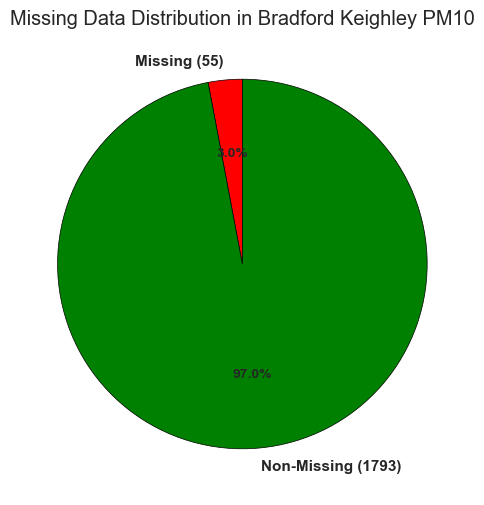

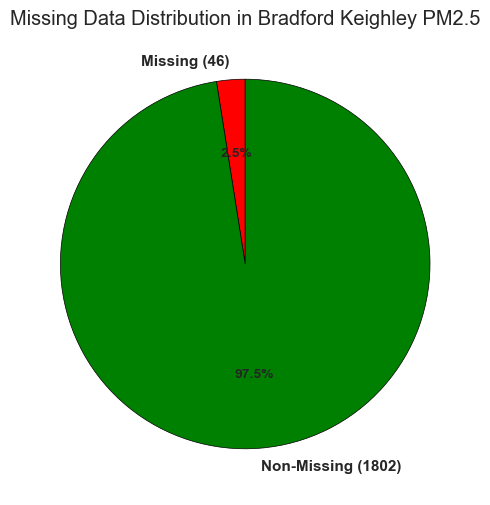

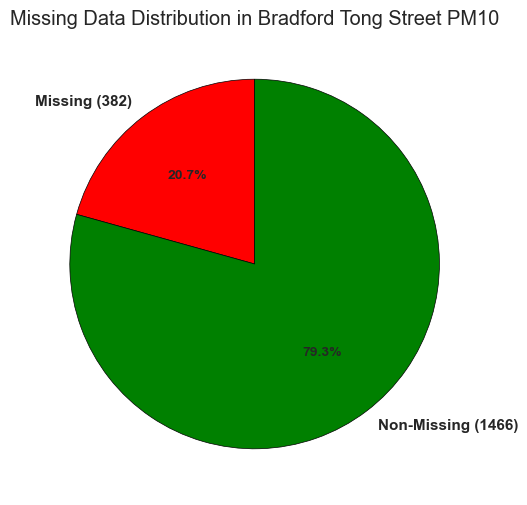

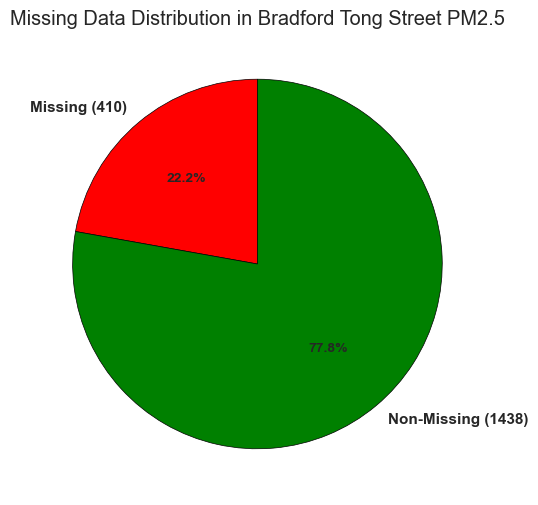

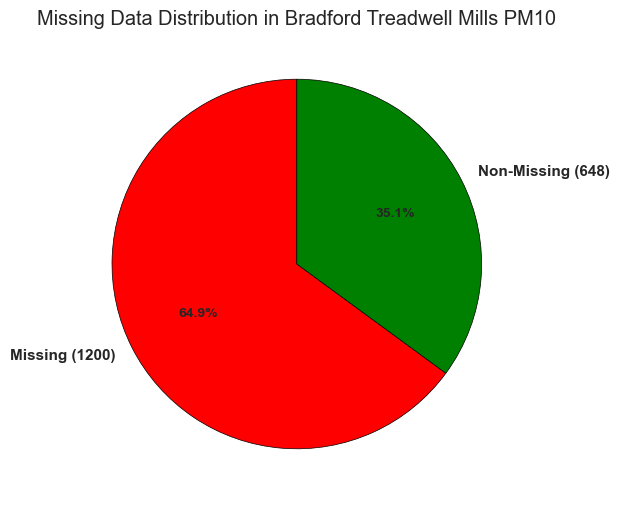

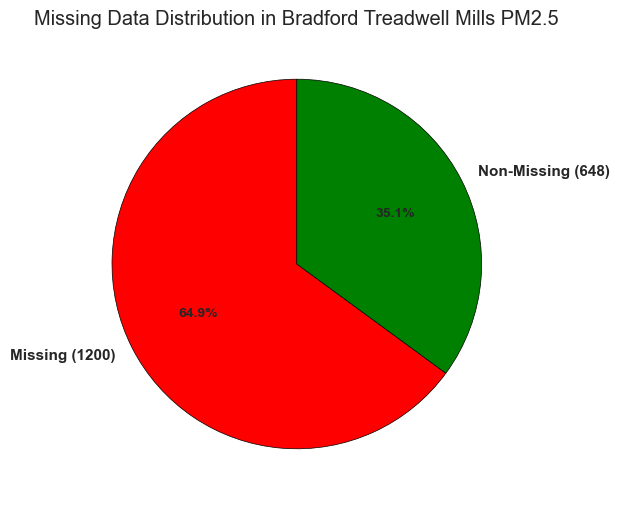

In [ ]:
import matplotlib.pyplot as plt

# Step 15: Handling Missing Values

# Now that we have taken care of the negative values, the next critical step is to address the missing values in the dataset.
# Missing values can significantly impact our analysis, so it’s essential to understand their distribution and extent before proceeding with imputation or removal.

# Count missing values for each column
missing_values_count = bradford_Negatives_handled.isnull().sum()

# Calculate the percentage of missing values for each column
missing_percentage = (missing_values_count / len(bradford_Negatives_handled)) * 100

# Create a DataFrame to show both the count and percentage of missing values
missing_data_summary = pd.DataFrame({
    'Missing Count': missing_values_count,
    'Missing Percentage': missing_percentage
})

# Print the missing data summary
print(missing_data_summary)

# Filter out the columns with missing values (only columns that have missing data)
missing_data_summary = missing_data_summary[missing_data_summary['Missing Count'] > 0]

# Create a pie chart for each column with missing values
for column in missing_data_summary.index:
    missing_count = missing_data_summary.loc[column, 'Missing Count']
    missing_percent = missing_data_summary.loc[column, 'Missing Percentage']

    # Pie chart data
    labels = [f'Missing ({missing_count})', f'Non-Missing ({len(bradford_Negatives_handled) - missing_count})']
    sizes = [missing_count, len(bradford_Negatives_handled) - missing_count]
    colors = ['red', 'green']

    # Plot the pie chart
    plt.figure(figsize=(6,6))
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90, wedgeprops={'edgecolor': 'black'})
    plt.title(f'Missing Data Distribution in {column}')

    # Show the chart
    plt.show()

# Explanation:
# - **missing_values_count**: This line calculates the total count of missing (NaN) values in each column after handling the negative values. It gives us insight into which columns have incomplete data.
# - **missing_percentage**: This calculation converts the missing value count into a percentage relative to the total number of rows in the dataset. Understanding this percentage allows us to assess the proportion of missing data per column.
# - **missing_data_summary**: This DataFrame combines both the count and the percentage of missing values for each column, providing a comprehensive view of missing data in the dataset.
# - **Pie charts for each column**: For each column that has missing data, a pie chart is generated to show the proportion of missing and non-missing data in that column.
#   - **Red slice**: Represents missing data in that column.
#   - **Green slice**: Represents non-missing data in that column.
#   - The **autopct='%1.1f%%'** ensures that the chart shows the percentage of missing and non-missing data.

# Why it's important:
# - Understanding the extent of missing data per column (both by count and percentage) allows us to make informed decisions on how to handle these gaps. For some columns, we may decide to impute missing values, and for others, we may remove the column or use other techniques.



Total Missing Values Count:
 PM10_missing     55
PM2.5_missing    46
Both_Missing     20
dtype: int64

Missing Values by Timestamp:
                Date Time  PM10_missing  PM2.5_missing  Both_Missing
238  2024-11-10 23:00:00             0              1             0
420  2024-11-18 13:00:00             1              1             1
421  2024-11-18 14:00:00             1              1             1
461  2024-11-20 06:00:00             0              1             0
505  2024-11-22 02:00:00             1              1             1
...                  ...           ...            ...           ...
1316 2024-12-25 21:00:00             1              1             1
1399 2024-12-29 08:00:00             0              1             0
1448 2024-12-31 09:00:00             0              1             0
1461 2024-12-31 22:00:00             1              0             0
1815 2025-01-15 16:00:00             1              0             0

[81 rows x 4 columns]

Days with More than One Mi

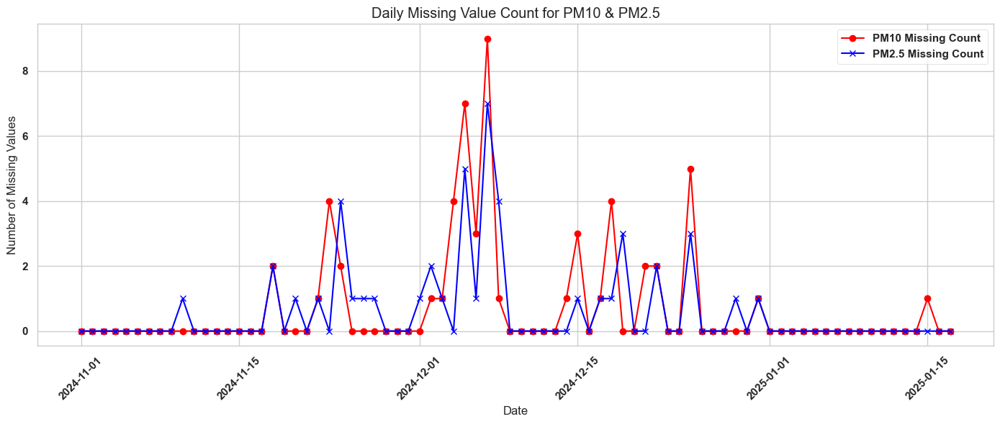

In [ ]:
# Step 16: Investigating Missing Values in Bradford Keighley PM10 and PM2.5

# Create a copy of relevant columns to focus on missing values in Bradford Keighley PM10 and PM2.5
keighley_missing = bradford_Negatives_handled[['Date Time', 'Bradford Keighley PM10', 'Bradford Keighley PM2.5']].copy()

# Create missing value indicators
# 'PM10_missing' is 1 if 'Bradford Keighley PM10' is missing, else 0
keighley_missing['PM10_missing'] = keighley_missing['Bradford Keighley PM10'].isnull().astype(int)

# 'PM2.5_missing' is 1 if 'Bradford Keighley PM2.5' is missing, else 0
keighley_missing['PM2.5_missing'] = keighley_missing['Bradford Keighley PM2.5'].isnull().astype(int)

# 'Both_Missing' is 1 if both 'PM10_missing' and 'PM2.5_missing' are 1 (i.e., both values are missing for a timestamp)
keighley_missing['Both_Missing'] = (keighley_missing['PM10_missing'] & keighley_missing['PM2.5_missing'])

# Count total missing values for each column ('PM10_missing', 'PM2.5_missing', 'Both_Missing')
missing_count = keighley_missing[['PM10_missing', 'PM2.5_missing', 'Both_Missing']].sum()
print("\nTotal Missing Values Count:\n", missing_count)

# Count missing values per timestamp by summing the 'PM10_missing' and 'PM2.5_missing' columns across each row
# If a timestamp has missing data for either PM10 or PM2.5, the sum will be > 0
keighley_missing['Missing_Total'] = keighley_missing[['PM10_missing', 'PM2.5_missing']].sum(axis=1)

# Filter rows where the 'Missing_Total' is greater than 0 (indicating that at least one of the columns is missing data)
missing_rows = keighley_missing[keighley_missing['Missing_Total'] > 0]
print("\nMissing Values by Timestamp:\n", missing_rows[['Date Time', 'PM10_missing', 'PM2.5_missing', 'Both_Missing']])

# Aggregate missing values by day by extracting the date part from 'Date Time'
keighley_missing['Date'] = keighley_missing['Date Time'].dt.date

# Group the data by 'Date' and sum the missing values for 'PM10_missing', 'PM2.5_missing', and 'Both_Missing' for each day
daily_missing = keighley_missing.groupby('Date')[['PM10_missing', 'PM2.5_missing', 'Both_Missing']].sum()

# Calculate the total missing values for each day by summing 'PM10_missing' and 'PM2.5_missing' for each day
daily_missing['Total_Missing'] = daily_missing[['PM10_missing', 'PM2.5_missing']].sum(axis=1)

# Filter days where there are more than one missing value across PM10 and PM2.5 columns combined
high_missing_days = daily_missing[daily_missing['Total_Missing'] > 1]
print("\nDays with More than One Missing Value:\n", high_missing_days)

# Detect unusual missing value patterns within a day
# We group by both 'Date' and 'Date Time' to check the missing values for each timestamp during the day
daily_timestamps = keighley_missing.groupby(['Date', 'Date Time'])[['PM10_missing', 'PM2.5_missing']].sum()

# Filter the timestamps where the sum of missing values for both PM10 and PM2.5 is greater than 1 (indicating both values are missing)
unusual_patterns = daily_timestamps[daily_timestamps.sum(axis=1) > 1]
print("\nUneven Missing Value Patterns Within a Day:\n", unusual_patterns)

# Plot daily missing values for PM10 and PM2.5
# This graph will show the daily count of missing values for both PM10 and PM2.5 to visualize trends
plt.figure(figsize=(14, 6))

# Plot the missing values for PM10
# The red line shows the count of missing values for 'PM10_missing' over time (daily)
plt.plot(daily_missing.index, daily_missing['PM10_missing'], label="PM10 Missing Count", color='red', marker='o')

# Plot the missing values for PM2.5
# The blue line shows the count of missing values for 'PM2.5_missing' over time (daily)
plt.plot(daily_missing.index, daily_missing['PM2.5_missing'], label="PM2.5 Missing Count", color='blue', marker='x')

# Add title and labels to the plot
plt.title("Daily Missing Value Count for PM10 & PM2.5")
plt.xlabel("Date")
plt.ylabel("Number of Missing Values")

# Show legend to differentiate between the two lines
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Adjust layout to ensure no content is cut off
plt.tight_layout()

# Show the plot
plt.show()


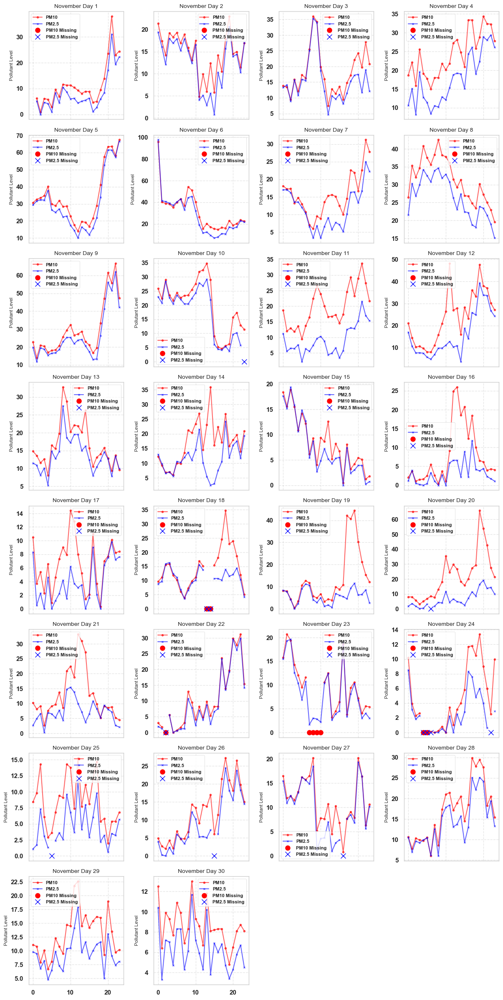

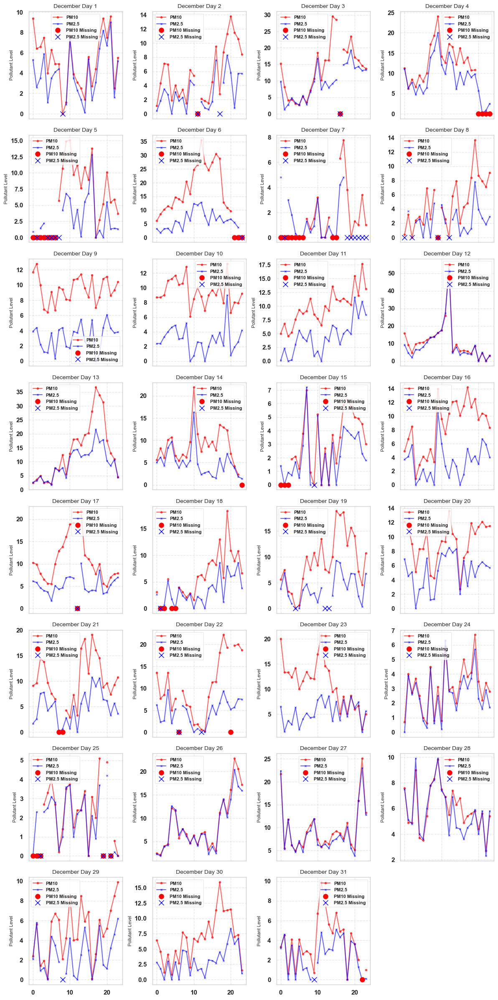

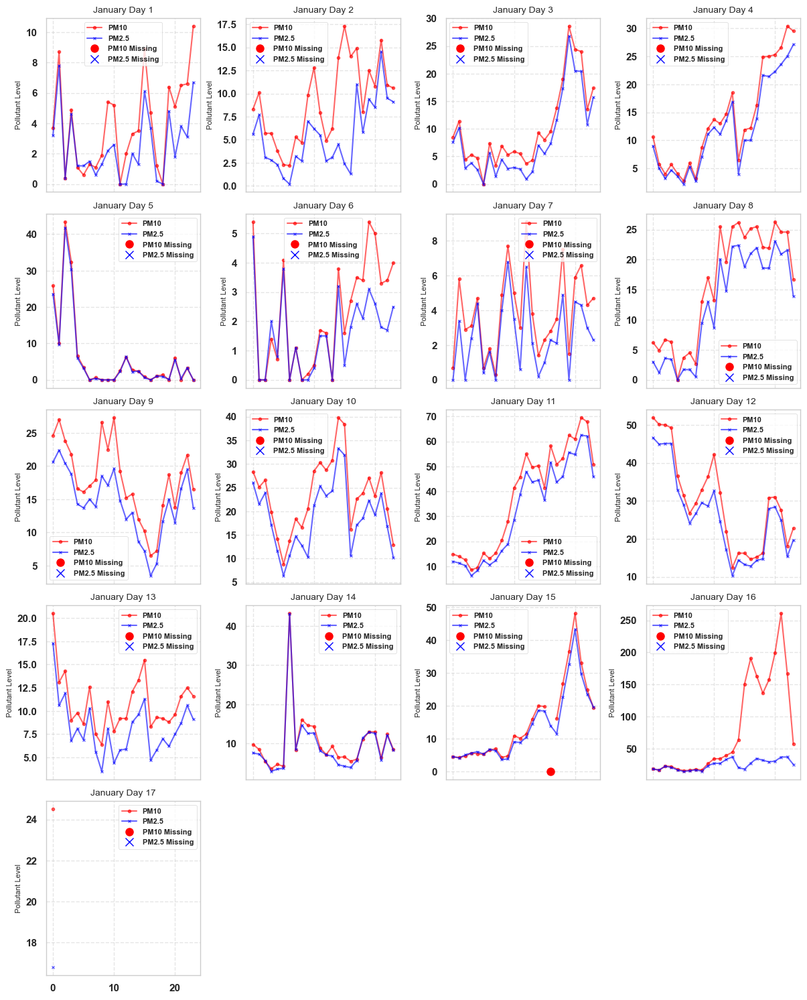

In [ ]:
# Step 18: Filtering and plotting hourly data for each day of November, December, and January.

# Filter only November data from bradford_Negatives_handled
november_data = bradford_Negatives_handled[bradford_Negatives_handled['Date Time'].dt.month == 11]

# Check if there's data for November
if november_data.empty:
    print("Warning: No data available for November")
else:
    # Get unique days in November
    november_days = sorted(november_data['Date Time'].dt.day.unique())

    # Calculate the number of rows and columns for subplots (4 columns per row)
    num_columns = 4
    num_rows = (len(november_days) + num_columns - 1) // num_columns  # Round up to fit all plots

    # Create subplots with 4 columns and adjusted number of rows for visualization
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 3), sharex=True)

    # Flatten the axes array for easier indexing
    axes = axes.flatten()

    # Iterate through each day and plot hourly data
    for i, day in enumerate(november_days):
        ax = axes[i]

        # Get data for this specific day
        day_data = november_data[november_data['Date Time'].dt.day == day]
        hours = day_data['Date Time'].dt.hour

        # Plot PM10 and PM2.5 data, handling missing values as flat lines
        ax.plot(hours, day_data['Bradford Keighley PM10'], label='PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax.plot(hours, day_data['Bradford Keighley PM2.5'], label='PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)

        # Handle missing data by marking it with distinct markers
        pm10_missing = day_data['Bradford Keighley PM10'].isna()
        pm2_5_missing = day_data['Bradford Keighley PM2.5'].isna()

        # Plot missing data points as flat lines
        ax.plot(hours[pm10_missing], [0] * pm10_missing.sum(), color='red', marker='o', markersize=8, linestyle='None', label='PM10 Missing', alpha=1)
        ax.plot(hours[pm2_5_missing], [0] * pm2_5_missing.sum(), color='blue', marker='x', markersize=8, linestyle='None', label='PM2.5 Missing', alpha=1)

        # Set the title and labels for each subplot
        ax.set_title(f"November Day {day}", fontsize=10)
        ax.set_ylabel("Pollutant Level", fontsize=8)
        ax.legend(fontsize=8)
        ax.grid(True, linestyle='--', alpha=0.5)

    # Hide unused subplots if there are fewer days than columns
    for i in range(len(november_days), len(axes)):
        axes[i].axis('off')

    # Set the x-axis label for all subplots
    plt.xlabel("Hour of the Day", fontsize=8)
    plt.tight_layout(pad=1.0)
    plt.show()

# Repeat similar steps for December data

# Filter only December data from bradford_Negatives_handled
december_data = bradford_Negatives_handled[bradford_Negatives_handled['Date Time'].dt.month == 12]

# Check if there's data for December
if december_data.empty:
    print("Warning: No data available for December")
else:
    # Get unique days in December
    december_days = sorted(december_data['Date Time'].dt.day.unique())

    # Calculate the number of rows and columns for subplots
    num_columns = 4
    num_rows = (len(december_days) + num_columns - 1) // num_columns  # Round up to fit all plots

    # Create subplots
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 3), sharex=True)
    axes = axes.flatten()

    # Iterate through each day in December
    for i, day in enumerate(december_days):
        ax = axes[i]
        day_data = december_data[december_data['Date Time'].dt.day == day]
        hours = day_data['Date Time'].dt.hour

        # Plot the PM10 and PM2.5 levels, handling missing values
        ax.plot(hours, day_data['Bradford Keighley PM10'], label='PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax.plot(hours, day_data['Bradford Keighley PM2.5'], label='PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)

        # Handle missing data
        pm10_missing = day_data['Bradford Keighley PM10'].isna()
        pm2_5_missing = day_data['Bradford Keighley PM2.5'].isna()

        # Mark missing values with distinct markers
        ax.plot(hours[pm10_missing], [0] * pm10_missing.sum(), color='red', marker='o', markersize=8, linestyle='None', label='PM10 Missing', alpha=1)
        ax.plot(hours[pm2_5_missing], [0] * pm2_5_missing.sum(), color='blue', marker='x', markersize=8, linestyle='None', label='PM2.5 Missing', alpha=1)

        # Set the title and labels for each subplot
        ax.set_title(f"December Day {day}", fontsize=10)
        ax.set_ylabel("Pollutant Level", fontsize=8)
        ax.legend(fontsize=8)
        ax.grid(True, linestyle='--', alpha=0.5)

    # Hide unused subplots
    for i in range(len(december_days), len(axes)):
        axes[i].axis('off')

    # Set the x-axis label for all subplots
    plt.xlabel("Hour of the Day", fontsize=8)
    plt.tight_layout(pad=1.0)
    plt.show()

# Repeat similar steps for January data

# Filter only January data from bradford_Negatives_handled
january_data = bradford_Negatives_handled[bradford_Negatives_handled['Date Time'].dt.month == 1]

# Check if there's data for January
if january_data.empty:
    print("Warning: No data available for January")
else:
    # Get unique days in January
    january_days = sorted(january_data['Date Time'].dt.day.unique())

    # Calculate the number of rows and columns for subplots
    num_columns = 4
    num_rows = (len(january_days) + num_columns - 1) // num_columns  # Round up to fit all plots

    # Create subplots
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 3), sharex=True)
    axes = axes.flatten()

    # Iterate through each day in January
    for i, day in enumerate(january_days):
        ax = axes[i]
        day_data = january_data[january_data['Date Time'].dt.day == day]
        hours = day_data['Date Time'].dt.hour

        # Plot the PM10 and PM2.5 levels, handling missing values
        ax.plot(hours, day_data['Bradford Keighley PM10'], label='PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax.plot(hours, day_data['Bradford Keighley PM2.5'], label='PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)

        # Handle missing data
        pm10_missing = day_data['Bradford Keighley PM10'].isna()
        pm2_5_missing = day_data['Bradford Keighley PM2.5'].isna()

        # Mark missing values with distinct markers
        ax.plot(hours[pm10_missing], [0] * pm10_missing.sum(), color='red', marker='o', markersize=8, linestyle='None', label='PM10 Missing', alpha=1)
        ax.plot(hours[pm2_5_missing], [0] * pm2_5_missing.sum(), color='blue', marker='x', markersize=8, linestyle='None', label='PM2.5 Missing', alpha=1)

        # Set the title and labels for each subplot
        ax.set_title(f"January Day {day}", fontsize=10)
        ax.set_ylabel("Pollutant Level", fontsize=8)
        ax.legend(fontsize=8)
        ax.grid(True, linestyle='--', alpha=0.5)

    # Hide unused subplots
    for i in range(len(january_days), len(axes)):
        axes[i].axis('off')

    # Set the x-axis label for all subplots
    plt.xlabel("Hour of the Day", fontsize=8)
    plt.tight_layout(pad=1.0)
    plt.show()


In [ ]:
#Step 19
# Brief Overview:
# I chose a linear trend-based imputation method for handling missing values in your PM10 and PM2.5 data.
# This method is more sophisticated than simple mean or median imputation because it considers the trend of the data when filling in the gaps.
#
# Why Trend-Based Imputation?
# Air quality data often exhibits trends and patterns over time. Simple imputation methods (like filling with the mean or median) can distort these trends,
# especially if there are longer sequences of missing values. Trend-based imputation attempts to preserve the local trend of the data when filling gaps,
# leading to a more realistic and accurate representation of air quality variations.

# Function to handle trend-based imputation considering missing value sequences and trend changes
def trend_based_imputation(data, column_name):
    # Start by initializing the index (i) to 0 to begin processing from the first row
    i = 0

    # We loop through the dataset until we reach the end
    while i < len(data):

        # Check if the current value in the specified column is missing (NaN)
        # This check was necessary earlier in the analysis to identify where the missing values were
        if pd.isna(data[column_name].iloc[i]):

            # Mark the starting index of the missing values sequence
            start_idx = i

            # Look ahead to find the end of the missing sequence
            while i < len(data) and pd.isna(data[column_name].iloc[i]):
                i += 1
            # Mark the ending index of the missing sequence
            end_idx = i

            # We check if there is data before and after the missing sequence to impute the values
            if start_idx > 0 and end_idx < len(data):

                # Get the last known value before the gap (for trend reference)
                prev_value = data[column_name].iloc[start_idx - 1]

                # Get the first known value after the gap (for trend reference)
                next_value = data[column_name].iloc[end_idx]

                # Check if the trend is increasing (next value is larger than previous value)
                if prev_value < next_value:
                    # If the trend is increasing, perform linear interpolation between the missing values
                    # This ensures a gradual increase from previous to next value
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value + (next_value - prev_value) * (j - start_idx) / (end_idx - start_idx)

                # Check if the trend is decreasing (next value is smaller than previous value)
                elif prev_value > next_value:
                    # If the trend is decreasing, perform linear interpolation with a negative slope
                    # This ensures a gradual decrease from previous to next value
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value - (prev_value - next_value) * (j - start_idx) / (end_idx - start_idx)

                else:
                    # If the trend is flat (previous value equals next value), just fill the missing values with the previous value
                    # This makes sense as the trend is stable and no change is expected
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value
            else:
                # If no data is available before or after the missing sequence, we cannot perform imputation for this gap
                # Thus, we simply skip over this sequence of missing values
                i += 1
        else:
            # If the current value is not missing, just move to the next index
            i += 1

    # Once all missing values are filled, return the modified dataset
    return data

# Create a copy of the original dataset to preserve the original data while working on imputations
bradford_missing_values = bradford_Negatives_handled.copy()

# Apply the trend-based imputation function to the 'Bradford Keighley PM10' column
# This is because 'PM10' has identified missing values that need to be handled using trend-based imputation
bradford_missing_values = trend_based_imputation(bradford_missing_values, 'Bradford Keighley PM10')

# Apply the trend-based imputation function to the 'Bradford Keighley PM2.5' column
# This is because 'PM2.5' also contains missing values, and we want to ensure consistent imputation using trends
bradford_missing_values = trend_based_imputation(bradford_missing_values, 'Bradford Keighley PM2.5')

# Print the first few rows of the modified dataset to check if the missing values have been imputed
print(bradford_missing_values.head())


            Date Time  Bradford Keighley PM10  Bradford Keighley PM2.5  \
0 2024-11-01 01:00:00                     6.2                      5.2   
1 2024-11-01 02:00:00                     1.0                      0.0   
2 2024-11-01 03:00:00                     6.1                      4.6   
3 2024-11-01 04:00:00                     5.8                      4.2   
4 2024-11-01 05:00:00                     2.8                      1.0   

   Bradford Tong Street PM10  Bradford Tong Street PM2.5  \
0                       10.2                         5.8   
1                        2.1                         0.0   
2                        7.3                         4.3   
3                       11.6                         7.8   
4                        2.4                         0.0   

   Bradford Treadwell Mills PM10  Bradford Treadwell Mills PM2.5  
0                            NaN                             NaN  
1                            NaN                            

In [ ]:
# Check if there are any missing values remaining after the trend-based imputation process
# This will help us verify if the imputation method has successfully filled all missing values.

# Count the number of missing values (NaNs) in the 'Bradford Keighley PM10' column
# 'isna().sum()' counts how many NaN values are present in the specified column
missing_pm10 = bradford_missing_values['Bradford Keighley PM10'].isna().sum()

# Count the number of missing values (NaNs) in the 'Bradford Keighley PM2.5' column
missing_pm25 = bradford_missing_values['Bradford Keighley PM2.5'].isna().sum()

# Print out the number of missing values for both columns (PM10 and PM2.5)
# This gives us a clear idea of how well the imputation has worked
print(f"Missing values for Bradford Keighley PM10: {missing_pm10}")

# Print out the number of missing values for the PM2.5 column
# If the number of missing values is 0, it means all gaps were successfully filled
print(f"Missing values for Bradford Keighley PM2.5: {missing_pm25}")

# Now, let's generate summary statistics for both PM10 and PM2.5 columns
# 'describe()' computes key summary statistics like count, mean, standard deviation, min, max, and percentiles for each column

# Summary statistics for PM10
pm10_stats = bradford_missing_values['Bradford Keighley PM10'].describe()

# Summary statistics for PM2.5
pm25_stats = bradford_missing_values['Bradford Keighley PM2.5'].describe()

# Print summary statistics for PM10
print("\nSummary Statistics for PM10:")
print(pm10_stats)

# Print summary statistics for PM2.5
print("\nSummary Statistics for PM2.5:")
print(pm25_stats)


Missing values for Bradford Keighley PM10: 0
Missing values for Bradford Keighley PM2.5: 0

Summary Statistics for PM10:
count    1848.000000
mean       13.486499
std        15.603548
min         0.000000
25%         5.400000
50%         9.800000
75%        16.925000
max       261.000000
Name: Bradford Keighley PM10, dtype: float64

Summary Statistics for PM2.5:
count    1848.000000
mean        9.198782
std         9.697713
min         0.000000
25%         3.000000
50%         6.100000
75%        12.225000
max        97.500000
Name: Bradford Keighley PM2.5, dtype: float64



Total Missing Values Count for Bradford Tong Street:
 PM10_missing     382
PM2.5_missing    410
Both_Missing     376
dtype: int64

Missing Values by Timestamp for Bradford Tong Street:
                Date Time  PM10_missing  PM2.5_missing  Both_Missing
9    2024-11-01 10:00:00             0              1             0
10   2024-11-01 11:00:00             0              1             0
11   2024-11-01 12:00:00             0              1             0
13   2024-11-01 14:00:00             0              1             0
15   2024-11-01 16:00:00             0              1             0
...                  ...           ...            ...           ...
1843 2025-01-16 20:00:00             1              1             1
1844 2025-01-16 21:00:00             1              1             1
1845 2025-01-16 22:00:00             1              1             1
1846 2025-01-16 23:00:00             1              1             1
1847 2025-01-17 00:00:00             1              1            

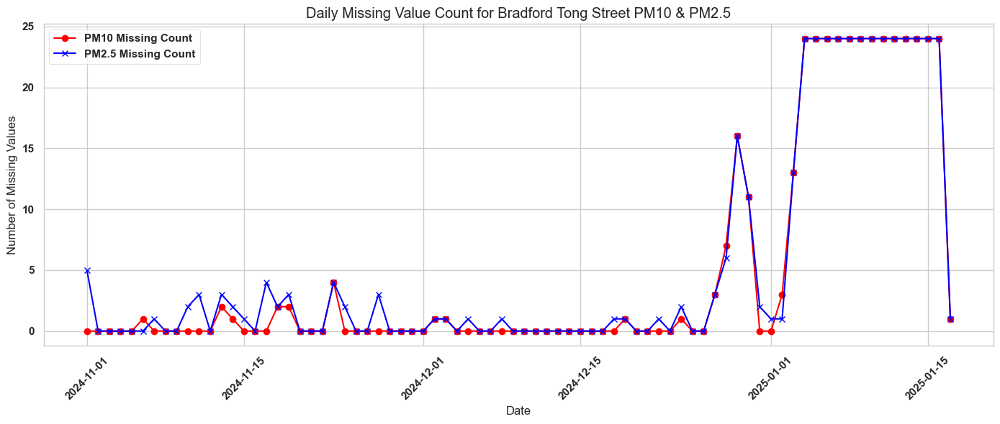

In [ ]:
# Step 20 : Doing the Same Procedure for Tong Street

# Create a copy of relevant columns for Bradford Tong Street
# We create a copy to avoid modifying the original dataset and focus only on the specific columns we need.
tong_street_missing = bradford_Negatives_handled[['Date Time', 'Bradford Tong Street PM10', 'Bradford Tong Street PM2.5']].copy()

# Create missing value indicators for both PM10 and PM2.5
# The 'isnull()' function checks for missing (NaN) values in the columns,
# and 'astype(int)' converts the Boolean result (True/False) into integers (1 for missing, 0 for not missing).
tong_street_missing['PM10_missing'] = tong_street_missing['Bradford Tong Street PM10'].isnull().astype(int)
tong_street_missing['PM2.5_missing'] = tong_street_missing['Bradford Tong Street PM2.5'].isnull().astype(int)

# Create a column that indicates when both PM10 and PM2.5 are missing simultaneously
# The '&' operator checks for both conditions being true (i.e., both columns are missing for a given row).
tong_street_missing['Both_Missing'] = (tong_street_missing['PM10_missing'] & tong_street_missing['PM2.5_missing'])

# Count missing values in the dataset for PM10, PM2.5, and when both are missing
# '.sum()' calculates the total number of missing values (1’s) for each column.
missing_count = tong_street_missing[['PM10_missing', 'PM2.5_missing', 'Both_Missing']].sum()

# Print the missing values count for PM10, PM2.5, and both
print("\nTotal Missing Values Count for Bradford Tong Street:\n", missing_count)

# Count missing values per timestamp (Date Time)
# The 'sum(axis=1)' function sums the missing values for each row, indicating the total number of missing values (for PM10 and PM2.5) at each timestamp.
tong_street_missing['Missing_Total'] = tong_street_missing[['PM10_missing', 'PM2.5_missing']].sum(axis=1)

# Filter rows with missing values (those where 'Missing_Total' is greater than 0)
# This step identifies the rows with at least one missing value in either PM10 or PM2.5
missing_rows = tong_street_missing[tong_street_missing['Missing_Total'] > 0]

# Print the missing values for each timestamp (date and time) for Bradford Tong Street
print("\nMissing Values by Timestamp for Bradford Tong Street:\n", missing_rows[['Date Time', 'PM10_missing', 'PM2.5_missing', 'Both_Missing']])

# Aggregate missing counts by day (group by the date)
# 'dt.date' extracts just the date (without time) from the 'Date Time' column.
tong_street_missing['Date'] = tong_street_missing['Date Time'].dt.date

# Group the data by date and calculate the sum of missing values for PM10, PM2.5, and both on each day.
daily_missing_tong = tong_street_missing.groupby('Date')[['PM10_missing', 'PM2.5_missing', 'Both_Missing']].sum()

# Identify days with clustered missing values
# Sum the missing counts for each day. If the total number of missing values for that day exceeds 1, it suggests clustered missing data.
daily_missing_tong['Total_Missing'] = daily_missing_tong[['PM10_missing', 'PM2.5_missing']].sum(axis=1)

# Filter days where more than one missing value was recorded for that day
high_missing_days_tong = daily_missing_tong[daily_missing_tong['Total_Missing'] > 1]

# Print the days with clustered missing values
print("\nDays with More than One Missing Value for Bradford Tong Street:\n", high_missing_days_tong)

# Detect uneven missing value patterns within a single day (e.g., missing values at different times within the same day)
# We group by both the date and timestamp and sum the missing values for each timepoint.
daily_timestamps_tong = tong_street_missing.groupby(['Date', 'Date Time'])[['PM10_missing', 'PM2.5_missing']].sum()

# Filter rows where more than one missing value was recorded at the same timestamp (within the same day).
unusual_patterns_tong = daily_timestamps_tong[daily_timestamps_tong.sum(axis=1) > 1]

# Print unusual missing value patterns detected within the same day
print("\nUneven Missing Value Patterns Within a Day for Bradford Tong Street:\n", unusual_patterns_tong)

# Plot daily missing values for Bradford Tong Street
# The plot helps visualize how missing values change over time for PM10 and PM2.5 on a daily basis.
plt.figure(figsize=(14, 6))  # Set figure size for better readability

# Plot PM10 missing count with a red line and 'o' markers
plt.plot(daily_missing_tong.index, daily_missing_tong['PM10_missing'], label="PM10 Missing Count", color='red', marker='o')

# Plot PM2.5 missing count with a blue line and 'x' markers
plt.plot(daily_missing_tong.index, daily_missing_tong['PM2.5_missing'], label="PM2.5 Missing Count", color='blue', marker='x')

# Add a title to the plot
plt.title("Daily Missing Value Count for Bradford Tong Street PM10 & PM2.5")

# Label the x-axis (Date)
plt.xlabel("Date")

# Label the y-axis (Number of Missing Values)
plt.ylabel("Number of Missing Values")

# Add a legend to differentiate between PM10 and PM2.5 missing values
plt.legend()

# Rotate x-axis labels for better readability (if there are many dates)
plt.xticks(rotation=45)

# Tighten the layout to avoid overlapping elements
plt.tight_layout()

# Show the plot
plt.show()


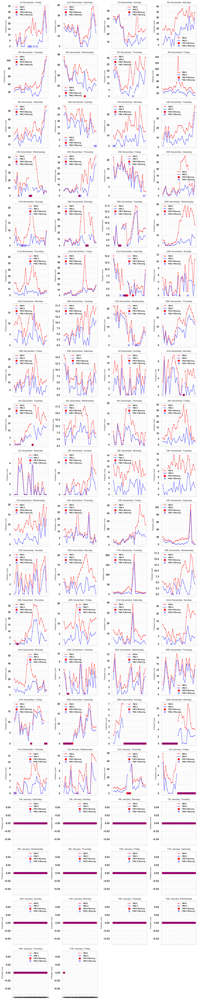

In [ ]:
#Step : 21# This script processes and visualizes air quality data (specifically PM10 and PM2.5 levels)
# for the months of November, December, and January. For each day in these months, it
# plots pollutant levels for each hour of the day. The graphs are displayed with proper
# titles (including ordinal suffixes for the day) and missing data is marked clearly on the
# plots with distinct markers. It handles missing values and adjusts the layout for readability.

# Function to get the ordinal suffix for the day of the month
def get_ordinal_suffix(day):
    # Check if the day is between 10 and 20 (inclusive), which always uses 'th' as suffix
    if 10 <= day <= 20:
        suffix = 'th'
    else:
        # For days outside 10-20, we use 'st', 'nd', 'rd' for 1st, 2nd, 3rd, etc.
        # The dictionary handles these mappings and returns 'th' for all others
        suffix = {1: 'st', 2: 'nd', 3: 'rd'}.get(day % 10, 'th')
    return suffix

# Now, filter the data for the months of November, December, and January.
months_to_filter = [11, 12, 1]  # November (11), December (12), January (1)
filtered_data = bradford_missing_values[bradford_missing_values['Date Time'].dt.month.isin(months_to_filter)]

# Check if we have any data for the selected months (November, December, January)
if filtered_data.empty:
    print("Warning: No data available for November, December, and January")
else:
    # Get all unique days present in the filtered data, sorted by date
    unique_days = sorted(filtered_data['Date Time'].dt.date.unique())

    # Calculate the number of rows needed to accommodate all graphs in the subplot grid
    num_columns = 4  # We want 4 plots per row
    num_rows = (len(unique_days) + num_columns - 1) // num_columns  # Round up to ensure all plots fit

    # Create a subplot figure with the necessary number of rows and columns
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 3), sharex=True)

    # Flatten the axes array to make it easier to loop over
    axes = axes.flatten()

    # Iterate through each day, and create a plot for each day's data
    for i, day in enumerate(unique_days):
        ax = axes[i]  # Get the current axis for the plot

        # Filter the data for the current day
        day_data = filtered_data[filtered_data['Date Time'].dt.date == day]
        hours = day_data['Date Time'].dt.hour  # Extract the hour of the day

        # Plot the pollutants PM10 and PM2.5 for the current day
        # Use distinct colors and markers to differentiate between the two pollutants
        ax.plot(hours, day_data['Bradford Tong Street PM10'], label='PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax.plot(hours, day_data['Bradford Tong Street PM2.5'], label='PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)

        # Identify where data is missing (NaN) for both pollutants
        pm10_missing = day_data['Bradford Tong Street PM10'].isna()  # Missing PM10 data
        pm2_5_missing = day_data['Bradford Tong Street PM2.5'].isna()  # Missing PM2.5 data

        # Plot missing values as flat lines at 0, marking them clearly on the plot
        ax.plot(hours[pm10_missing], [0] * pm10_missing.sum(), color='red', marker='o', markersize=8, linestyle='None', label='PM10 Missing', alpha=1)
        ax.plot(hours[pm2_5_missing], [0] * pm2_5_missing.sum(), color='blue', marker='x', markersize=8, linestyle='None', label='PM2.5 Missing', alpha=1)

        # Format the day into a readable string with ordinal suffix (e.g., "1st December, Monday")
        day_num = day.day  # Get the numeric day of the month (1, 2, 3, etc.)
        month_name = day.strftime('%B')  # Get the full month name (e.g., "December")
        weekday_name = day.strftime('%A')  # Get the full name of the weekday (e.g., "Monday")

        # Combine the day number, month name, and weekday name into a formatted title
        title = f"{day_num}{get_ordinal_suffix(day_num)} {month_name}, {weekday_name}"

        # Set the title, axis labels, and legend for the plot
        ax.set_title(title, fontsize=10)  # Title now includes the formatted date with day, month, and weekday
        ax.set_ylabel("Pollutant Level", fontsize=8)  # Label for the y-axis
        ax.legend(fontsize=8)  # Add legend with smaller font size
        ax.grid(True, linestyle='--', alpha=0.5)  # Add a grid to make the plot more readable

        # Set x-axis ticks for each hour (0:00, 1:00, 2:00, etc.) even though time is not being displayed
        ax.set_xticks(range(0, 24, 1))  # Set ticks for every hour
        ax.set_xticklabels([f"{hour}:00" for hour in range(0, 24, 1)], fontsize=8)  # Label the ticks with hour values

    # Hide any empty subplots that don't contain any data
    for i in range(len(unique_days), len(axes)):
        axes[i].axis('off')  # Turn off the axes for any unused plots

    # Set x-axis label for the entire plot and adjust layout for better readability
    plt.xlabel("Hour of the Day", fontsize=8)
    plt.tight_layout(pad=1.0)  # Adjust spacing between plots to prevent overlap
    plt.show()  # Show the final plot with all the subplots


In [ ]:
# Step 22: Trend-Based Imputation to Handle Missing Values
# In this step, we are implementing a trend-based imputation technique to fill in missing values
# in time-series data. The approach assumes that the trend in the data (increasing or decreasing)
# can be used to interpolate values in the missing sequence. This is useful in cases where data has
# missing values but the surrounding values indicate a clear upward or downward trend.

# Function to handle trend-based imputation considering missing value sequences and trend changes
def trend_based_imputation(data, column_name):
    i = 0  # Initialize the index pointer to start iterating through the data
    while i < len(data):  # Loop through each row of the dataset
        # Check if the current value in the specified column is missing (NaN)
        if pd.isna(data[column_name].iloc[i]):
            start_idx = i  # Mark the start index of the missing sequence
            # Find the end of the missing sequence by continuing until non-missing data is found
            while i < len(data) and pd.isna(data[column_name].iloc[i]):
                i += 1
            end_idx = i  # End index of the missing sequence

            # If there's data before and after the missing sequence, we can impute (fill) the gap
            if start_idx > 0 and end_idx < len(data):
                prev_value = data[column_name].iloc[start_idx - 1]  # Last known value before the missing range
                next_value = data[column_name].iloc[end_idx]  # First known value after the missing range

                # Check if the trend is increasing or decreasing between the previous and next values
                if prev_value < next_value:
                    # If the trend is increasing, perform linear interpolation to fill missing values
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value + (next_value - prev_value) * (j - start_idx) / (end_idx - start_idx)
                elif prev_value > next_value:
                    # If the trend is decreasing, perform linear interpolation but with a negative slope
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value - (prev_value - next_value) * (j - start_idx) / (end_idx - start_idx)
                else:
                    # If the trend is flat (i.e., previous and next values are the same), impute with the previous value
                    for j in range(start_idx, end_idx):
                        data.loc[j, column_name] = prev_value
            else:
                # If there's no data before or after the missing sequence, we cannot impute and will skip this gap
                i += 1  # Move to the next row to continue searching for missing values
        else:
            # If the current value is not missing, just move to the next row
            i += 1

    return data  # Return the updated dataset with imputed values

# Step 2: Prepare the data for imputation
# Ensure the 'Date Time' column is in datetime format to facilitate filtering and time-based operations
bradford_missing_values['Date Time'] = pd.to_datetime(bradford_missing_values['Date Time'])

# Step 3: Apply trend-based imputation up to a specific filter date (no data deletion after the date)
filter_date = pd.Timestamp('2025-01-02 23:00:00')  # Define the cutoff date for imputation

# Step 4: Filter the data to only include rows up to the specified filter date for imputation
bradford_missing_values_before_date = bradford_missing_values[bradford_missing_values['Date Time'] <= filter_date].copy()

# Step 5: Apply the trend-based imputation function on the filtered data (up to the filter date)
# Apply imputation to the 'PM10' column (Air Quality data) first
bradford_missing_values_before_date = trend_based_imputation(bradford_missing_values_before_date, 'Bradford Tong Street PM10')
# Apply imputation to the 'PM2.5' column (Air Quality data) second
bradford_missing_values_before_date = trend_based_imputation(bradford_missing_values_before_date, 'Bradford Tong Street PM2.5')

# Step 6: After applying the imputation, retain data from the filter date onward without modification
# Filter the data for entries after the filter date to combine them later
bradford_missing_values_after_date = bradford_missing_values[bradford_missing_values['Date Time'] > filter_date]

# Step 7: Concatenate the imputed data (up to filter date) with the data after the filter date (unchanged)
bradford_missing_filtered = pd.concat([bradford_missing_values_before_date, bradford_missing_values_after_date])

# Step 8: Sort the final dataset by 'Date Time' to ensure the chronological order is maintained
bradford_missing_filtered = bradford_missing_filtered.sort_values(by='Date Time')

# Step 9: Output a sample of the imputed data to verify the changes
# Check the first few rows of the final dataset to confirm if the imputation worked as expected
print(bradford_missing_filtered.head())

# Step 10: Verify if missing values were successfully imputed before the filter date
# Define the filter date as January 3, 2025, to check missing values before this date
filter_date = pd.Timestamp('2025-01-03 00:00:00')

# Count the missing values (NaN) in both PM10 and PM2.5 columns before the filter date
missing_pm10 = bradford_missing_filtered[bradford_missing_filtered['Date Time'] < filter_date]['Bradford Tong Street PM10'].isna().sum()
missing_pm25 = bradford_missing_filtered[bradford_missing_filtered['Date Time'] < filter_date]['Bradford Tong Street PM2.5'].isna().sum()

# Output the missing values count to see if imputation was successful
print(f"Missing values in Bradford Tong Street PM10 before 03/01/2025: {missing_pm10}")
print(f"Missing values in Bradford Tong Street PM2.5 before 03/01/2025: {missing_pm25}")


            Date Time  Bradford Keighley PM10  Bradford Keighley PM2.5  \
0 2024-11-01 01:00:00                     6.2                      5.2   
1 2024-11-01 02:00:00                     1.0                      0.0   
2 2024-11-01 03:00:00                     6.1                      4.6   
3 2024-11-01 04:00:00                     5.8                      4.2   
4 2024-11-01 05:00:00                     2.8                      1.0   

   Bradford Tong Street PM10  Bradford Tong Street PM2.5  \
0                       10.2                         5.8   
1                        2.1                         0.0   
2                        7.3                         4.3   
3                       11.6                         7.8   
4                        2.4                         0.0   

   Bradford Treadwell Mills PM10  Bradford Treadwell Mills PM2.5  
0                            NaN                             NaN  
1                            NaN                            

In [ ]:
# Purpose:
# The code is designed to filter air quality data for November, December, and January,
# and then visualize the comparison of pollutant levels (PM10 and PM2.5) from two datasets:
# one with missing values and the other with imputed (filled) values.
# It generates subplots for each day in the selected months, showing original data
# (before imputation) and imputed data (after imputation), comparing pollutant levels
# for both the original and imputed data over the hours of the day.

# Function to get the ordinal suffix for the day of the month
def get_ordinal_suffix(day):
    if 10 <= day <= 20:  # For days 10-20, the suffix is always "th"
        suffix = 'th'
    else:
        suffix = {1: 'st', 2: 'nd', 3: 'rd'}.get(day % 10, 'th')
    return suffix

# Filter data for November, December, and January for both datasets
months_to_filter = [11, 12, 1]  # November, December, January
filtered_data_original = bradford_missing_values[bradford_missing_values['Date Time'].dt.month.isin(months_to_filter)]
filtered_data_imputed = bradford_missing_filtered[bradford_missing_filtered['Date Time'].dt.month.isin(months_to_filter)]

# Check if there's data for the selected months
if filtered_data_original.empty or filtered_data_imputed.empty:
    print("Warning: No data available for November, December, and January in one or both datasets.")
else:
    # Get unique days in the selected months for both datasets
    unique_days = sorted(filtered_data_original['Date Time'].dt.date.unique())

    # Calculate number of rows needed to fit all graphs (2 rows per day)
    num_columns = 2
    num_rows = len(unique_days)

    # Create subplots (2 plots per day: before and after comparison)
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 6), sharex=True)

    # Flatten the axes array for easier indexing
    axes = axes.flatten()

    # Iterate through each day and plot the data for both datasets (before and after the date)
    for i, day in enumerate(unique_days):
        # Plot the data before the date
        ax_before = axes[i * 2]  # First plot: before
        day_data_before = filtered_data_original[filtered_data_original['Date Time'].dt.date == day]
        hours_before = day_data_before['Date Time'].dt.hour

        ax_before.plot(hours_before, day_data_before['Bradford Tong Street PM10'], label='Original PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax_before.plot(hours_before, day_data_before['Bradford Tong Street PM2.5'], label='Original PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)
        ax_before.set_title(f"Before {day} - Original Data", fontsize=10)
        ax_before.set_ylabel("Pollutant Level", fontsize=8)
        ax_before.set_xticks(range(0, 24, 1))  # Set ticks for every hour
        ax_before.set_xticklabels([f"{hour}:00" for hour in range(0, 24, 1)], fontsize=8)
        ax_before.grid(True, linestyle='--', alpha=0.5)
        ax_before.legend(fontsize=8)

        # Plot the data after the date
        ax_after = axes[i * 2 + 1]  # Second plot: after
        day_data_after = filtered_data_imputed[filtered_data_imputed['Date Time'].dt.date == day]
        hours_after = day_data_after['Date Time'].dt.hour

        ax_after.plot(hours_after, day_data_after['Bradford Tong Street PM10'], label='Imputed PM10', color='green', linestyle='--', marker='o', markersize=3, alpha=0.6)
        ax_after.plot(hours_after, day_data_after['Bradford Tong Street PM2.5'], label='Imputed PM2.5', color='black', linestyle='--', marker='x', markersize=3, alpha=0.6)
        ax_after.set_title(f"After {day} - Imputed Data", fontsize=10)
        ax_after.set_ylabel("Pollutant Level", fontsize=8)
        ax_after.set_xticks(range(0, 24, 1))  # Set ticks for every hour
        ax_after.set_xticklabels([f"{hour}:00" for hour in range(0, 24, 1)], fontsize=8)
        ax_after.grid(True, linestyle='--', alpha=0.5)
        ax_after.legend(fontsize=8)

    # Adjust layout to ensure everything fits
    plt.tight_layout(pad=1.0)
    plt.show()


Bradford Tong Street PM10 - Missing Stats:
count    1466.000000
mean       13.507094
std        13.902034
min         0.000000
25%         5.225000
50%         9.600000
75%        17.575000
max       204.000000
Name: Bradford Tong Street PM10, dtype: float64

Bradford Tong Street PM2.5 - Missing Stats:
count    1438.000000
mean        7.396801
std        10.096966
min         0.000000
25%         1.800000
50%         4.500000
75%         9.300000
max       164.300000
Name: Bradford Tong Street PM2.5, dtype: float64

Bradford Tong Street PM10 - Filtered Stats:
count    1522.000000
mean       13.359691
std        13.769902
min         0.000000
25%         5.300000
50%         9.500000
75%        17.200000
max       204.000000
Name: Bradford Tong Street PM10, dtype: float64

Bradford Tong Street PM2.5 - Filtered Stats:
count    1522.000000
mean        7.232162
std         9.889259
min         0.000000
25%         1.800000
50%         4.400000
75%         9.000000
max       164.300000
Name

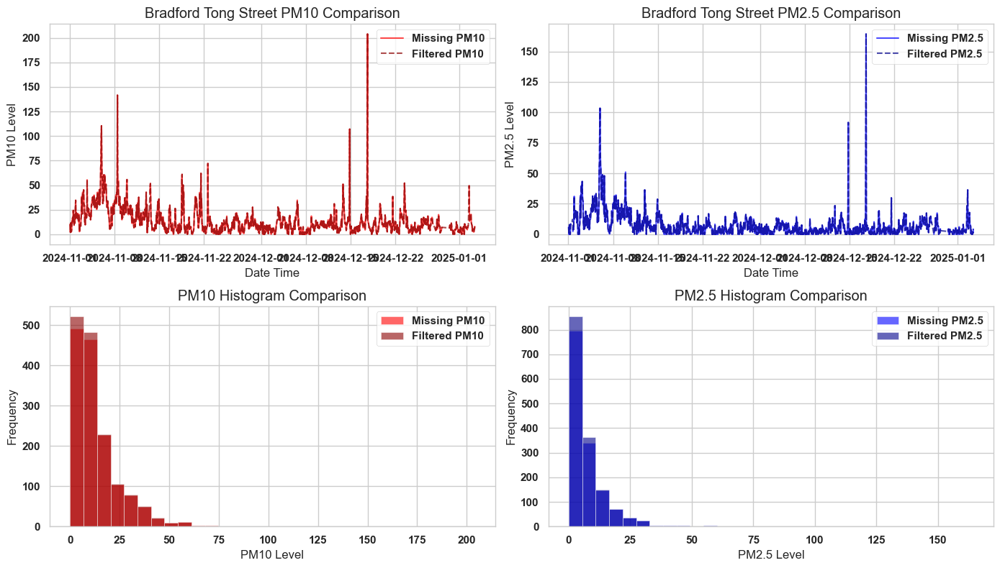

In [ ]:
# Purpose:
# This code compares the air quality data for PM10 and PM2.5 levels recorded at Bradford Tong Street.
# It first calculates the statistical summary (mean, median, standard deviation, etc.) for both pollutants
# (PM10 and PM2.5) in two datasets: one containing missing values and the other containing filtered (imputed) values.
# After calculating the statistics, the code then generates visual comparisons between these datasets,
# including line plots for time series and histograms to show the distribution of pollutant levels.
# The goal is to visually and statistically evaluate the differences between the original data with missing values
# and the filtered (imputed) data.

# Statistical comparison of missing and filtered data for PM10 and PM2.5 pollutants
# Calculate summary statistics for both pollutants in the missing data
pm10_stats_missing = bradford_missing_values['Bradford Tong Street PM10'].describe()
pm2_5_stats_missing = bradford_missing_values['Bradford Tong Street PM2.5'].describe()

# Calculate summary statistics for both pollutants in the filtered (imputed) data
pm10_stats_filtered = bradford_missing_filtered['Bradford Tong Street PM10'].describe()
pm2_5_stats_filtered = bradford_missing_filtered['Bradford Tong Street PM2.5'].describe()

# Print statistical summaries for both datasets (missing and filtered) for PM10 and PM2.5
print("Bradford Tong Street PM10 - Missing Stats:")
print(pm10_stats_missing)
print("\nBradford Tong Street PM2.5 - Missing Stats:")
print(pm2_5_stats_missing)

print("\nBradford Tong Street PM10 - Filtered Stats:")
print(pm10_stats_filtered)
print("\nBradford Tong Street PM2.5 - Filtered Stats:")
print(pm2_5_stats_filtered)

# Plot comparison for Bradford Tong Street PM10 and PM2.5
# Create a figure for displaying multiple plots
plt.figure(figsize=(14, 8))

# Plot the time series comparison for PM10 levels
plt.subplot(2, 2, 1)
plt.plot(bradford_missing_values['Date Time'], bradford_missing_values['Bradford Tong Street PM10'],
         label='Missing PM10', color='red', alpha=0.7)  # Original data (missing values) for PM10
plt.plot(bradford_missing_filtered['Date Time'], bradford_missing_filtered['Bradford Tong Street PM10'],
         label='Filtered PM10', color='darkred', linestyle='--', alpha=0.7)  # Imputed data for PM10
plt.title("Bradford Tong Street PM10 Comparison")
plt.xlabel("Date Time")
plt.ylabel("PM10 Level")
plt.legend()

# Plot the time series comparison for PM2.5 levels
plt.subplot(2, 2, 2)
plt.plot(bradford_missing_values['Date Time'], bradford_missing_values['Bradford Tong Street PM2.5'],
         label='Missing PM2.5', color='blue', alpha=0.7)  # Original data (missing values) for PM2.5
plt.plot(bradford_missing_filtered['Date Time'], bradford_missing_filtered['Bradford Tong Street PM2.5'],
         label='Filtered PM2.5', color='darkblue', linestyle='--', alpha=0.7)  # Imputed data for PM2.5
plt.title("Bradford Tong Street PM2.5 Comparison")
plt.xlabel("Date Time")
plt.ylabel("PM2.5 Level")
plt.legend()

# Plot histograms comparing the distribution of PM10 levels in both datasets
plt.subplot(2, 2, 3)
plt.hist(bradford_missing_values['Bradford Tong Street PM10'], bins=30, alpha=0.6, label='Missing PM10', color='red')
plt.hist(bradford_missing_filtered['Bradford Tong Street PM10'], bins=30, alpha=0.6, label='Filtered PM10', color='darkred')
plt.title("PM10 Histogram Comparison")
plt.xlabel("PM10 Level")
plt.ylabel("Frequency")
plt.legend()

# Plot histograms comparing the distribution of PM2.5 levels in both datasets
plt.subplot(2, 2, 4)
plt.hist(bradford_missing_values['Bradford Tong Street PM2.5'], bins=30, alpha=0.6, label='Missing PM2.5', color='blue')
plt.hist(bradford_missing_filtered['Bradford Tong Street PM2.5'], bins=30, alpha=0.6, label='Filtered PM2.5', color='darkblue')
plt.title("PM2.5 Histogram Comparison")
plt.xlabel("PM2.5 Level")
plt.ylabel("Frequency")
plt.legend()

# Adjust layout to make sure all subplots fit well
plt.tight_layout()
# Display the plots
plt.show()


In [ ]:
# Step 23 # Purpose:
# This code is part of the data analysis process for the Bradford Treadwell Mills air quality data.
# After handling the missing values in the Keighley and Tong Street datasets, we now focus on the
# Bradford Treadwell Mills dataset to:
# 1. Compute the summary statistics (mean, median, standard deviation, etc.) for PM10 and PM2.5 levels
#    after missing values have been filtered (imputed).
# 2. Check for any remaining missing values in the filtered data.
# The goal is to ensure that the data is clean, provide insights into the air quality data for Bradford Treadwell Mills,
# and confirm that no further missing values exist after imputation.

# 1. Summary statistics for Bradford Treadwell Mills PM10 and PM2.5 from the bradford_missing_filtered dataset
# The describe() method computes and returns various summary statistics for PM10 and PM2.5 pollutants in the filtered data
pm10_stats_filtered = bradford_missing_filtered['Bradford Treadwell Mills PM10'].describe()  # PM10 stats
pm2_5_stats_filtered = bradford_missing_filtered['Bradford Treadwell Mills PM2.5'].describe()  # PM2.5 stats

# Printing the statistical summaries for PM10 and PM2.5 for Bradford Treadwell Mills
print("Bradford Treadwell Mills PM10 - Filtered Stats:")
print(pm10_stats_filtered)  # Display the stats for PM10

print("\nBradford Treadwell Mills PM2.5 - Filtered Stats:")
print(pm2_5_stats_filtered)  # Display the stats for PM2.5

# 2. Checking for any remaining missing values in Bradford Treadwell Mills PM10 and PM2.5 in the filtered data
# The isna().sum() method checks for missing (NaN) values in both PM10 and PM2.5 and sums them up to count how many are missing
missing_pm10 = bradford_missing_filtered['Bradford Treadwell Mills PM10'].isna().sum()  # Count missing PM10
missing_pm2_5 = bradford_missing_filtered['Bradford Treadwell Mills PM2.5'].isna().sum()  # Count missing PM2.5

# Printing the number of missing values for both PM10 and PM2.5
print(f"Missing values in Bradford Treadwell Mills PM10: {missing_pm10}")  # Show how many missing PM10
print(f"Missing values in Bradford Treadwell Mills PM2.5: {missing_pm2_5}")  # Show how many missing PM2.5


Bradford Treadwell Mills PM10 - Filtered Stats:
count    648.000000
mean      15.077623
std       25.076011
min        0.300000
25%        4.700000
50%        8.900000
75%       16.800000
max      329.200000
Name: Bradford Treadwell Mills PM10, dtype: float64

Bradford Treadwell Mills PM2.5 - Filtered Stats:
count    648.000000
mean       8.868827
std        9.482111
min        0.300000
25%        2.800000
50%        5.400000
75%       10.800000
max       65.700000
Name: Bradford Treadwell Mills PM2.5, dtype: float64
Missing values in Bradford Treadwell Mills PM10: 1200
Missing values in Bradford Treadwell Mills PM2.5: 1200


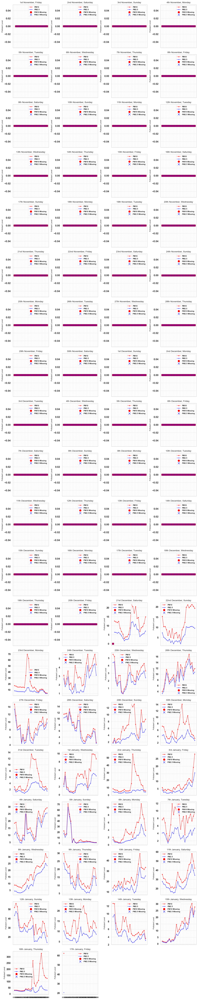

In [ ]:
# To understand the missing values better in Treadwell Mills

# Function to get the ordinal suffix for the day of the month (e.g., 1st, 2nd, 3rd, 4th)
def get_ordinal_suffix(day):
    if 10 <= day <= 20:  # For days 10-20, the suffix is always "th"
        suffix = 'th'
    else:
        suffix = {1: 'st', 2: 'nd', 3: 'rd'}.get(day % 10, 'th')
    return suffix

# Define the start and end dates for filtering the data
start_date = pd.to_datetime('2024-11-01')  # Starting from November 1, 2024
end_date = pd.to_datetime('2025-01-17')   # Ending on January 16, 2025

# Filter data for the required date range based on the 'Date Time' column
filtered_data = bradford_missing_filtered[
    (bradford_missing_filtered['Date Time'] >= start_date) &
    (bradford_missing_filtered['Date Time'] <= end_date)
]

# Check if there's data available for the selected months
if filtered_data.empty:
    print("Warning: No data available for the selected date range")
else:
    # Get unique days in the selected months to plot each day individually
    unique_days = sorted(filtered_data['Date Time'].dt.date.unique())

    # Calculate number of rows needed to fit all graphs (4 columns per row)
    num_columns = 4
    num_rows = (len(unique_days) + num_columns - 1) // num_columns  # Round up to ensure all plots fit

    # Create subplots (adjust for 4 columns per row)
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(12, num_rows * 3), sharex=True)

    # Flatten the axes array for easier indexing (since it’s a grid, we want to treat it like a 1D array)
    axes = axes.flatten()

    # Iterate through each unique day and plot data for that day
    for i, day in enumerate(unique_days):
        ax = axes[i]  # Get the current subplot

        # Filter data for the current day
        day_data = filtered_data[filtered_data['Date Time'].dt.date == day]
        hours = day_data['Date Time'].dt.hour  # Extract hour from the 'Date Time' column

        # Plot PM10 and PM2.5 levels, handling missing values by displaying NaN as flat lines
        ax.plot(hours, day_data['Bradford Treadwell Mills PM10'], label='PM10', color='red', marker='o', markersize=3, alpha=0.6)
        ax.plot(hours, day_data['Bradford Treadwell Mills PM2.5'], label='PM2.5', color='blue', marker='x', markersize=3, alpha=0.6)

        # Mark missing values with distinct markers and a horizontal line
        pm10_missing = day_data['Bradford Treadwell Mills PM10'].isna()  # Detect missing values in PM10
        pm2_5_missing = day_data['Bradford Treadwell Mills PM2.5'].isna()  # Detect missing values in PM2.5

        # Plot missing data as flat lines to indicate missing values
        ax.plot(hours[pm10_missing], [0] * pm10_missing.sum(), color='red', marker='o', markersize=8, linestyle='None', label='PM10 Missing', alpha=1)
        ax.plot(hours[pm2_5_missing], [0] * pm2_5_missing.sum(), color='blue', marker='x', markersize=8, linestyle='None', label='PM2.5 Missing', alpha=1)

        # Format the day into a readable date with ordinal suffix and day of the week (e.g., "1st December, Monday")
        day_num = day.day
        month_name = day.strftime('%B')  # Get the full month name (e.g., "December")
        weekday_name = day.strftime('%A')  # Get the full weekday name (e.g., "Monday")

        # Create the formatted title (e.g., "1st December, Monday")
        title = f"{day_num}{get_ordinal_suffix(day_num)} {month_name}, {weekday_name}"

        # Set titles and labels with the exact formatted day and date
        ax.set_title(title, fontsize=10)  # Title now includes the formatted date
        ax.set_ylabel("Pollutant Level", fontsize=8)
        ax.legend(fontsize=8)
        ax.grid(True, linestyle='--', alpha=0.5)

        # Set x-axis ticks for hours (though we're not showing time, it's kept for the visual layout)
        ax.set_xticks(range(0, 24, 1))  # Set ticks for every hour
        ax.set_xticklabels([f"{hour}:00" for hour in range(0, 24, 1)], fontsize=8)

    # Hide any empty subplots (if there are fewer days than available subplots)
    for i in range(len(unique_days), len(axes)):
        axes[i].axis('off')  # Hide the unused subplots

    # Set the overall x-axis label and adjust layout
    plt.xlabel("Hour of the Day", fontsize=8)
    plt.tight_layout(pad=1.0)  # Adjust the layout to prevent overlap
    plt.show()


In [ ]:
import pandas as pd

# Purpose: The following code filters data from the specified start date (21st December 2024) and checks for missing values in the pollutant data.
# We noticed that pollutant readings started from 21st December 2024 after reviewing other data. Upon further investigation, we confirmed
# that the site had been closed for a long period prior to this date, and the readings resumed from that day onward. Therefore, we decided to focus on this data range.

# Define the start date and time for filtering the data
start_datetime = pd.to_datetime('2024-12-21 01:00:00')  # Set the start date to 21st December 2024 at 01:00 AM.

# Filter the dataset to include data from 21st December 2024 01:00:00 onwards
# This step excludes data prior to the specified start date, which corresponds to when the site resumed operation.
filtered_data = bradford_missing_filtered[bradford_missing_filtered['Date Time'] >= start_datetime]

# Check for missing values in the filtered data to identify any gaps or issues in the dataset after the site resumed operation
# We will count the number of missing values for both the PM10 and PM2.5 pollutant columns (Bradford Treadwell Mills PM10 and PM2.5).
missing_values = filtered_data.isna().sum()

# Display the missing values for Bradford Treadwell Mills PM10 and PM2.5 pollutants
# This will show how many missing values exist for each pollutant column, giving us insight into the quality of the data post-resumption.
missing_values_for_pollutants = missing_values[['Bradford Treadwell Mills PM10', 'Bradford Treadwell Mills PM2.5']]

# Print out the results, which will indicate how many missing values exist for PM10 and PM2.5 from 21st December 2024 onwards
print("Missing Values for Bradford Treadwell Mills PM10 and PM2.5 from 21/12/2024 01:00:00 onwards:")
print(missing_values_for_pollutants)


Missing Values for Bradford Treadwell Mills PM10 and PM2.5 from 21/12/2024 01:00:00 onwards:
Bradford Treadwell Mills PM10     0
Bradford Treadwell Mills PM2.5    0
dtype: int64


In [ ]:
# Save the filtered data to a CSV file
# Purpose: Before starting any further analysis, we are saving the final cleaned and filtered dataset to a CSV file. This ensures that the current version of the dataset is saved in a stable, reusable format. This step allows us to avoid having to re-run the filtering process in the future and provides a checkpoint for the dataset at this stage.
bradford_missing_filtered.to_csv('bradford_final.csv', index=False)

# Load the CSV file into a DataFrame
# Purpose: After saving the dataset to a CSV file, we are loading it back into a new DataFrame (`bradford_final`) for further analysis. This ensures that we are working with the final version of the cleaned data. Loading it from the CSV file also ensures that any previous transformations or filtering steps are preserved and can be easily referenced for subsequent operations.
bradford_final = pd.read_csv("bradford_final.csv")


In [ ]:
bradford_final

,Date Time,Bradford Keighley PM10,Bradford Keighley PM2.5,Bradford Tong Street PM10,Bradford Tong Street PM2.5,Bradford Treadwell Mills PM10,Bradford Treadwell Mills PM2.5
0,2024-11-01 01:00:00,6.2,5.2,10.2,5.8,NaN,NaN
1,2024-11-01 02:00:00,1.0,0.0,2.1,0.0,NaN,NaN
2,2024-11-01 03:00:00,6.1,4.6,7.3,4.3,NaN,NaN
3,2024-11-01 04:00:00,5.8,4.2,11.6,7.8,NaN,NaN
4,2024-11-01 05:00:00,2.8,1.0,2.4,0.0,NaN,NaN
...,...,...,...,...,...,...,...
1843,2025-01-16 20:00:00,199.5,30.4,NaN,NaN,209.0,45.5
1844,2025-01-16 21:00:00,261.0,36.8,NaN,NaN,148.8,34.3
1845,2025-01-16 22:00:00,167.5,36.9,NaN,NaN,132.3,32.4
1846,2025-01-16 23:00:00,57.0,25.3,NaN,NaN,126.0,31.1


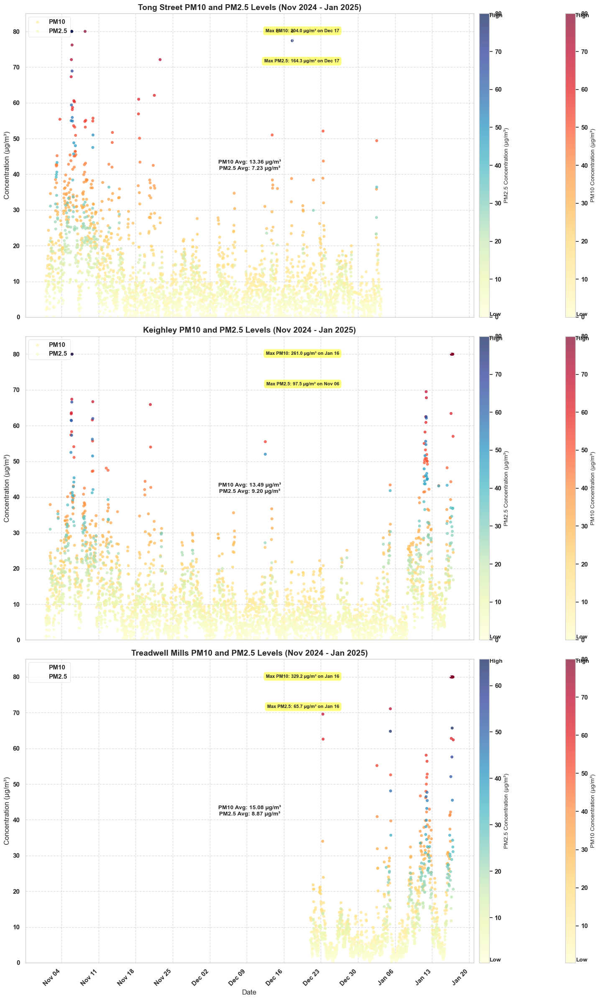

In [ ]:
# Purpose: The goal of this section of the code is to filter the dataset for specific locations (Tong Street, Keighley, and Treadwell Mills) between November 2024 and January 2025, and visualize the concentration of pollutants (PM10 and PM2.5) at these locations over time. The data is plotted with color-coded scatter points, highlighting extreme values and average concentrations. A color map is used to show the variation in pollutant levels and a plot with annotations is generated for better interpretation.

# Filter data for all three places for November, December, and January
# Purpose: We are filtering the dataset to focus only on the period between November 2024 and January 2025. The locations of interest are Tong Street, Keighley, and Treadwell Mills. This will allow us to focus the analysis on these specific areas during the given time range.
date_range = (bradford_final['Date Time'] >= '2024-11-01') & (bradford_final['Date Time'] <= '2025-01-31')

# Define the locations we want to analyze
locations = ['Tong Street', 'Keighley', 'Treadwell Mills']

# Initialize a dictionary to store filtered data for each location
filtered_data = {}

# Iterate over each location and filter the data for the defined date range
for location in locations:
    # Filter the data for the current location and set the 'Date Time' column as the index
    filtered_data[location] = bradford_final[date_range][[
        'Date Time',
        f'Bradford {location} PM10',
        f'Bradford {location} PM2.5'
    ]].set_index('Date Time')

    # Convert the index (Date Time) to datetime format
    filtered_data[location].index = pd.to_datetime(filtered_data[location].index)

# Create the plot
# Purpose: This section sets up the plot, creating a separate subplot for each location. It also specifies the color scheme for PM10 and PM2.5 pollutants and the function for capping data at 80 to prevent outlier influence on the visualization.
fig, axes = plt.subplots(3, 1, figsize=(16, 24), sharex=True)

# Define color maps for PM10 and PM2.5 to represent different pollutant levels visually
pm10_cmap = mpl.colormaps['YlOrRd']  # Color map for PM10
pm25_cmap = mpl.colormaps['YlGnBu']  # Color map for PM2.5

# Define a function to cap the pollutant values at 80 for better visualization
def cap_at_80(x):
    return np.minimum(x, 80)

# Iterate over the filtered data for each location
for idx, (location, data) in enumerate(filtered_data.items()):
    # Access the subplot for the current location
    ax = axes[idx]

    # For both pollutants PM10 and PM2.5, create a scatter plot
    for column, cmap in [(f'Bradford {location} PM10', pm10_cmap), (f'Bradford {location} PM2.5', pm25_cmap)]:
        # Cap the pollutant values at 80
        capped_data = cap_at_80(data[column])

        # Plot the data as a scatter plot, color-coded by pollutant concentration
        points = ax.scatter(data.index, capped_data, c=capped_data, cmap=cmap,
                            alpha=0.7, s=20, label=column.split()[-1])

        # Add a colorbar to indicate pollutant concentration levels
        cbar = plt.colorbar(points, ax=ax, pad=0.01, aspect=30)
        cbar.set_label(f'{column.split()[-1]} Concentration (µg/m³)', fontsize=10)
        cbar.ax.text(1.05, 0.0, 'Low', transform=cbar.ax.transAxes, va='bottom', ha='left')
        cbar.ax.text(1.05, 1.0, 'High', transform=cbar.ax.transAxes, va='top', ha='left')

    # Find and annotate extreme values (max pollutant levels) on the plot
    for column in [f'Bradford {location} PM10', f'Bradford {location} PM2.5']:
        max_val = data[column].max()  # Find the maximum concentration value
        max_date = data[column].idxmax()  # Get the date of the maximum value

        # Annotate the maximum value with an arrow pointing to the maximum date
        ax.annotate(f'Max {column.split()[-1]}: {max_val:.1f} µg/m³ on {max_date.strftime("%b %d")}',
                    xy=(max_date, 80), xytext=(0.7, 0.95 - 0.1 * (column.endswith('PM2.5'))),
                    textcoords='axes fraction',
                    bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                    arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=-0.2'),
                    ha='right', va='top', fontsize=8)

    # Set axis labels and title for the current location plot
    ax.set_ylabel('Concentration (µg/m³)', fontsize=12)
    ax.set_title(f'{location} PM10 and PM2.5 Levels (Nov 2024 - Jan 2025)', fontsize=14, fontweight='bold')
    ax.set_ylim(0, 85)  # Set y-axis limits to improve visualization
    ax.legend(loc='upper left')  # Add a legend
    ax.grid(True, linestyle='--', alpha=0.7)  # Add gridlines to the plot

    # Add average values for PM10 and PM2.5 to the plot
    ax.text(0.5, 0.5, f"PM10 Avg: {data[f'Bradford {location} PM10'].mean():.2f} µg/m³\nPM2.5 Avg: {data[f'Bradford {location} PM2.5'].mean():.2f} µg/m³",
            transform=ax.transAxes, fontsize=10, ha='center', va='center',
            bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

# X-axis formatting
# Purpose: Here, we are formatting the x-axis to display dates in a readable format with weekly intervals and rotated labels for clarity.
axes[-1].xaxis.set_major_locator(mdates.WeekdayLocator(byweekday=mdates.MO))  # Set weekly ticks starting from Monday
axes[-1].xaxis.set_major_formatter(mdates.DateFormatter('%b %d'))  # Format date labels as month and day
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
axes[-1].set_xlabel('Date', fontsize=12)  # Label for the x-axis

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()  # Display the plot


In [ ]:
# Purpose:
# The goal of this code is to evaluate air quality in Bradford, focusing on PM10 and PM2.5 pollutant levels at three different locations: Keighley (urban background), Tong Street, and Treadwell Mills (roadside).
# The code checks if the average concentrations of PM10 and PM2.5 meet air quality standards, with particular attention to whether the levels are within permissible limits for the given time period (November 2024 - January 2025).
# This analysis helps assess the air quality in urban and roadside settings and identify any exceedances of air quality standards.

# Select relevant columns for analysis
# These columns represent the PM10 and PM2.5 concentrations from the three locations
columns = [
    'Bradford Keighley PM10',  # PM10 concentration in Keighley (urban background)
    'Bradford Keighley PM2.5',  # PM2.5 concentration in Keighley (urban background)
    'Bradford Tong Street PM10',  # PM10 concentration in Tong Street (roadside)
    'Bradford Tong Street PM2.5',  # PM2.5 concentration in Tong Street (roadside)
    'Bradford Treadwell Mills PM10',  # PM10 concentration in Treadwell Mills (roadside)
    'Bradford Treadwell Mills PM2.5'  # PM2.5 concentration in Treadwell Mills (roadside)
]

# Calculate the mean for each pollutant at each location
# We compute the mean pollutant concentration for each of the six columns selected above
means = bradford_final[columns].mean()

# Define air quality standards for comparison
# The standards define the maximum allowable concentrations for PM10 and PM2.5 pollutants:
# - PM10 annual average should not exceed 40 µg/m³
# - PM10 24-hour average should not exceed 50 µg/m³ (with a maximum of 35 exceedances per year)
# - PM2.5 annual average should not exceed 20 µg/m³ (target by 2040: 10 µg/m³)
standards = {
    'PM10 Annual Average': 40,  # µg/m3
    'PM10 24-hour Average (max 35 exceedances/year)': 50,  # µg/m3
    'PM2.5 Annual Average (2010)': 20,  # µg/m3
    'PM2.5 Annual Average (2040 Target)': 10  # µg/m3
}

# Compare the mean pollutant concentrations with the standards
# This function checks if the mean concentration exceeds the specified standard
def compare_to_standards(mean, standard):
    return 'Exceeds' if mean > standard else 'Within Limit'

# Prepare a dictionary to store comparison results for each pollutant
comparison_results = {}
# Loop through each pollutant and compare its mean concentration to the appropriate standard
for pollutant in means.index:
    if 'PM10' in pollutant:  # For PM10 pollutants
        comparison_results[pollutant] = compare_to_standards(means[pollutant], standards['PM10 Annual Average'])
    elif 'PM2.5' in pollutant:  # For PM2.5 pollutants
        comparison_results[pollutant] = compare_to_standards(means[pollutant], standards['PM2.5 Annual Average (2040 Target)'])

# Display the average concentrations and comparison results
print("Average PM Concentrations:")
print(means)  # Print the mean concentration values for each pollutant
print("\nComparison with Air Quality Standards:")
# Print the comparison results indicating whether each pollutant is within the limits or exceeds the standards
for key, value in comparison_results.items():
    print(f"{key}: {value}")

# Additional analysis to compare the mean PM10 concentration between urban background (Keighley) and roadside locations (Tong Street and Treadwell Mills)
# Select columns related to PM10 concentrations at Keighley (urban background) and roadside locations (Tong Street and Treadwell Mills)
columns = [
    'Bradford Keighley PM10',  # Keighley (urban background) PM10 concentration
    'Bradford Tong Street PM10',  # Tong Street (roadside) PM10 concentration
    'Bradford Treadwell Mills PM10'  # Treadwell Mills (roadside) PM10 concentration
]

# Calculate the mean concentration of PM10 at each location
mean_values = bradford_final[columns].mean()

# Define air quality standards for PM10 pollutants
standards = {
    'PM10_annual': 40,   # µg/m3, annual average limit
    'PM10_24_hour': 50,  # µg/m3, 24-hour average limit (with up to 35 exceedances per year)
}

# Prepare a dictionary to store comparison results for PM10
comparison = {}
# Loop through each PM10 pollutant and compare its mean concentration to the standards
for col in columns:
    if 'PM10' in col:
        comparison[col] = {
            'mean': mean_values[col],  # Store the mean concentration for the given pollutant
            'exceeds_annual_standard': mean_values[col] > standards['PM10_annual']  # Check if the annual standard is exceeded
        }

# Calculate the mean concentration of PM10 for Keighley (urban background) and the average of Tong Street and Treadwell Mills (roadside)
urban_background_pm10 = mean_values['Bradford Keighley PM10']  # Average PM10 concentration for urban background (Keighley)
roadside_pm10 = bradford_final[['Bradford Tong Street PM10', 'Bradford Treadwell Mills PM10']].mean().mean()  # Average PM10 concentration for roadside locations (Tong Street & Treadwell Mills)

# Print the results for PM10 comparison
print("Mean Concentration of PM10:")
print(f"Urban Background (Keighley): {urban_background_pm10:.2f} µg/m3")  # PM10 concentration at Keighley
print(f"Roadside (Tong Street & Treadwell Mills): {roadside_pm10:.2f} µg/m3")  # Average PM10 concentration at roadside locations


Average PM Concentrations:
Bradford Keighley PM10            13.486499
Bradford Keighley PM2.5            9.198782
Bradford Tong Street PM10         13.359691
Bradford Tong Street PM2.5         7.232162
Bradford Treadwell Mills PM10     15.077623
Bradford Treadwell Mills PM2.5     8.868827
dtype: float64

Comparison with Air Quality Standards:
Bradford Keighley PM10: Within Limit
Bradford Keighley PM2.5: Within Limit
Bradford Tong Street PM10: Within Limit
Bradford Tong Street PM2.5: Within Limit
Bradford Treadwell Mills PM10: Within Limit
Bradford Treadwell Mills PM2.5: Within Limit
Mean Concentration of PM10:
Urban Background (Keighley): 13.49 µg/m3
Roadside (Tong Street & Treadwell Mills): 14.22 µg/m3


In [ ]:
# Purpose: The purpose of this code is to filter the PM10 data for a specific date range (01/11/2024 to 16/01/2025),
# clean the data by handling missing values, resample the data to calculate daily averages,
# and then check how many days exceed the 50 µg/m³ limit for PM10 at different monitoring locations: Keighley, Tong Street, and Treadwell Mills.
# Convert the 'Date Time' column to datetime
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'], errors='coerce')
# Step 1: Filter data for the given date range (01/11/2024 to 16/01/2025, up to 23:00 on 16th January)
start_date = '2024-11-01'
end_date = '2025-01-16 23:00:00'

# Filter the rows in the dataframe based on the 'Date Time' column falling within the specified range
filtered_data = bradford_final[(bradford_final['Date Time'] >= start_date) & (bradford_final['Date Time'] <= end_date)]

# Step 2: Replace missing PM10 values with NaN for clarity
# This ensures any non-numeric or missing values are handled as NaN, making it easier to analyze the data.
filtered_data['Bradford Keighley PM10'] = pd.to_numeric(filtered_data['Bradford Keighley PM10'], errors='coerce')
filtered_data['Bradford Tong Street PM10'] = pd.to_numeric(filtered_data['Bradford Tong Street PM10'], errors='coerce')
filtered_data['Bradford Treadwell Mills PM10'] = pd.to_numeric(filtered_data['Bradford Treadwell Mills PM10'], errors='coerce')

# Step 3: Resample the data to daily averages
# Resampling groups the data by day and calculates the average PM10 concentration for each day at each location.
daily_data_keighley = filtered_data.resample('D', on='Date Time')['Bradford Keighley PM10'].mean()
daily_data_tong_street = filtered_data.resample('D', on='Date Time')['Bradford Tong Street PM10'].mean()
daily_data_treadwell_mills = filtered_data.resample('D', on='Date Time')['Bradford Treadwell Mills PM10'].mean()

# Step 4: Identify the dates where the daily average exceeds 50 µg/m³
# Here, we filter out the dates where the PM10 concentration is above the 50 µg/m³ threshold for each location.
exceed_50_keighley_dates = daily_data_keighley[daily_data_keighley > 50].index
exceed_50_tong_street_dates = daily_data_tong_street[daily_data_tong_street > 50].index
exceed_50_treadwell_mills_dates = daily_data_treadwell_mills[daily_data_treadwell_mills > 50].index

# Step 5: Count the number of days where the daily average exceeds 50 µg/m³
# We count how many dates had a PM10 value above the 50 µg/m³ limit for each location.
exceed_50_keighley = exceed_50_keighley_dates.size
exceed_50_tong_street = exceed_50_tong_street_dates.size
exceed_50_treadwell_mills = exceed_50_treadwell_mills_dates.size

# Step 6: Display the results
# This displays the total number of days exceeding the 50 µg/m³ threshold for each location.
print(f"Number of days with a 24-hour average above 50 µg/m³ for Keighley: {exceed_50_keighley}")
print(f"Number of days with a 24-hour average above 50 µg/m³ for Tong Street: {exceed_50_tong_street}")
print(f"Number of days with a 24-hour average above 50 µg/m³ for Treadwell Mills: {exceed_50_treadwell_mills}")

# Step 7: Print the exact dates where PM10 exceeded 50 µg/m³
# This prints the exact dates where the daily PM10 concentration exceeded 50 µg/m³ at each monitoring location.
print("\nDates where the daily PM10 average exceeded 50 µg/m³:")
print(f"Keighley: {exceed_50_keighley_dates}")
print(f"Tong Street: {exceed_50_tong_street_dates}")
print(f"Treadwell Mills: {exceed_50_treadwell_mills_dates}")


Number of days with a 24-hour average above 50 µg/m³ for Keighley: 1
Number of days with a 24-hour average above 50 µg/m³ for Tong Street: 0
Number of days with a 24-hour average above 50 µg/m³ for Treadwell Mills: 1

Dates where the daily PM10 average exceeded 50 µg/m³:
Keighley: DatetimeIndex(['2025-01-16'], dtype='datetime64[ns]', name='Date Time', freq='D')
Tong Street: DatetimeIndex([], dtype='datetime64[ns]', name='Date Time', freq='D')
Treadwell Mills: DatetimeIndex(['2025-01-16'], dtype='datetime64[ns]', name='Date Time', freq='D')


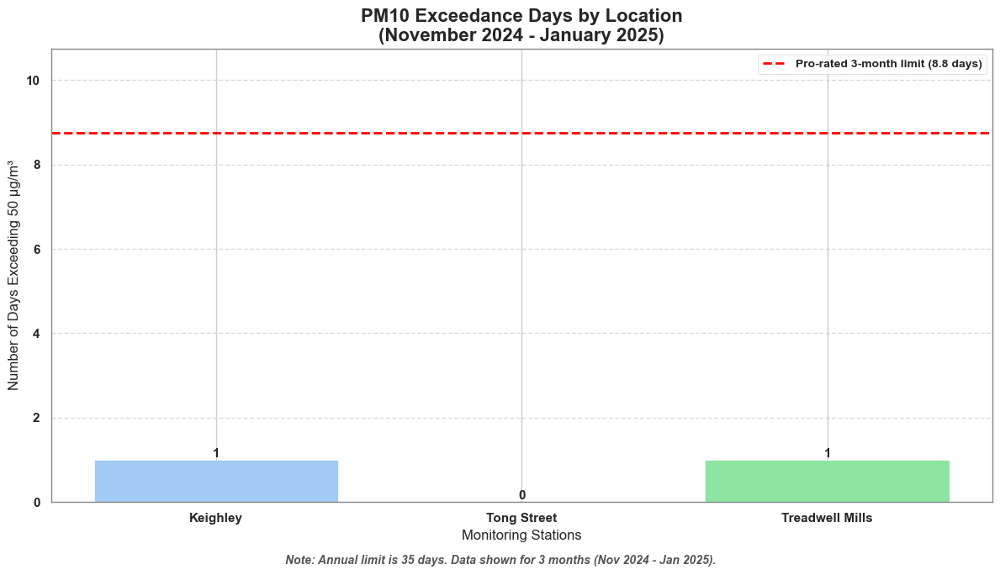

In [ ]:
# Purpose: The purpose of this code is to create a bar plot that visualizes the number of days
# where the 24-hour average PM10 concentration exceeded 50 µg/m³ at three different monitoring stations.
# Additionally, the code includes a red line indicating the pro-rated PM10 exceedance limit for the 3-month period (Nov 2024 - Jan 2025)
# and provides further insights into the comparison across monitoring stations (Keighley, Tong Street, and Treadwell Mills).

# Set the style using Seaborn's function
sns.set_style("whitegrid")  # Sets a clean background grid style for the plot.
sns.set_palette("deep")  # Uses a 'deep' color palette to set a cohesive color scheme for the plot.

# Step 1: Define the data
locations = ['Keighley', 'Tong Street', 'Treadwell Mills']  # List of locations being compared.
days_above_50 = [1, 0, 1]  # The number of days where the daily average PM10 exceeded 50 µg/m³ for each location.
months_monitored = 3  # The total number of months monitored, which is November 2024 to January 2025.
annual_limit = 35  # The annual limit for the number of days exceeding 50 µg/m³ is set to 35 days.

# Step 2: Create the figure and axis for the plot
fig, ax = plt.subplots(figsize=(12, 7))  # Create a figure and axis for the bar plot with a specified size.

# Step 3: Create the bar plot
bars = ax.bar(locations, days_above_50, color=sns.color_palette("pastel")[0:3])
# Creates a bar plot where:
# - 'locations' represents the names of the monitoring stations (Keighley, Tong Street, Treadwell Mills)
# - 'days_above_50' represents the number of days exceeding the 50 µg/m³ threshold
# - The 'color' argument uses a pastel color palette for the bars.

# Step 4: Add a line for the pro-rated 3-month limit
prorated_limit = annual_limit * (months_monitored / 12)  # Calculates the pro-rated limit for the 3-month period.
ax.axhline(y=prorated_limit, color='red', linestyle='--', linewidth=2,
           label=f'Pro-rated 3-month limit ({prorated_limit:.1f} days)')
# Adds a red dashed line at the height of the pro-rated 3-month limit on the plot.
# The label provides an explanation of the line's meaning.

# Step 5: Customize the plot's appearance
ax.set_title('PM10 Exceedance Days by Location\n(November 2024 - January 2025)', fontsize=16, fontweight='bold')
# Sets the title of the plot, describing the data being shown, and applies bold formatting.
ax.set_xlabel('Monitoring Stations', fontsize=12)  # Labels the x-axis with the name 'Monitoring Stations'.
ax.set_ylabel('Number of Days Exceeding 50 µg/m³', fontsize=12)  # Labels the y-axis.

# Step 6: Add value labels on the bars
for bar in bars:
    height = bar.get_height()  # Gets the height of each bar (i.e., the number of days exceeding 50 µg/m³).
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{height}',  # Adds the height (value) of the bar as a text label above it.
            ha='center', va='bottom', fontsize=11, fontweight='bold')  # Positions the label centered above each bar.

# Step 7: Set y-axis limit and ticks
ax.set_ylim(0, max(max(days_above_50) + 2, prorated_limit + 2))
# Sets the y-axis limit so that it extends slightly beyond the maximum value to provide space for the labels.
ax.set_yticks(np.arange(0, ax.get_ylim()[1], 2))  # Sets the ticks on the y-axis at intervals of 2 units.

# Step 8: Enhance grid, legend, and spines
ax.grid(axis='y', linestyle='--', alpha=0.7)  # Adds a grid for the y-axis with a dashed line style and partial transparency.
ax.legend(fontsize=10, loc='upper right')  # Adds a legend to the plot, placed in the upper right corner.
for spine in ax.spines.values():  # Iterates over the plot's border (spines) to change their appearance.
    spine.set_edgecolor('#888888')  # Sets the border color to a soft grey.

# Step 9: Add text explanation
fig.text(0.5, 0.02,
         f"Note: Annual limit is 35 days. Data shown for {months_monitored} months (Nov 2024 - Jan 2025).",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')
# Adds a note at the bottom of the plot providing additional context and explanation of the data presented.
# The text is italicized, and its color is set to a soft grey.

# Step 10: Adjust layout and display the plot
plt.tight_layout(rect=[0, 0.03, 1, 0.98])  # Adjusts the plot layout to ensure it fits within the figure area.
plt.show()  # Displays the plot.


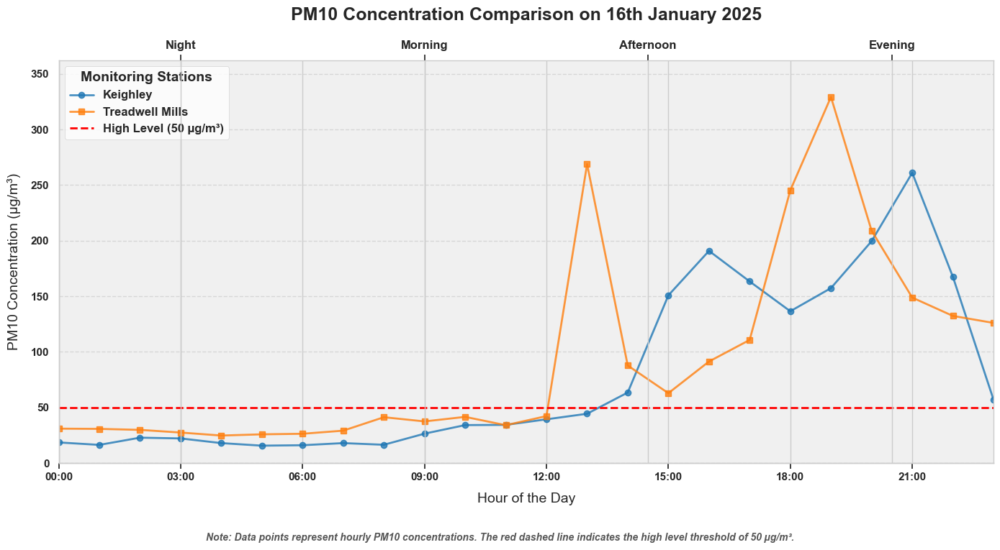

In [ ]:
# Convert the 'Date Time' column into pandas datetime format to allow time-based operations
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'])

# Filter the data to only include entries from January 16th, 2025 for analysis
filtered_data = bradford_final[bradford_final['Date Time'].dt.date == pd.to_datetime('2025-01-16').date()]

# Extract the 'Hour' from the 'Date Time' column to allow hourly analysis of PM10 concentrations
filtered_data['Hour'] = filtered_data['Date Time'].dt.hour

# Define a function to categorize hours of the day into parts (Morning, Afternoon, Evening, Night)
# This helps in associating the time with general parts of the day to interpret the trend better
def get_day_period(hour):
    if 6 <= hour < 12:
        return 'Morning'  # Morning: 6 AM to 12 PM
    elif 12 <= hour < 17:
        return 'Afternoon'  # Afternoon: 12 PM to 5 PM
    elif 17 <= hour < 20:
        return 'Evening'  # Evening: 5 PM to 8 PM
    else:
        return 'Night'  # Night: 8 PM to 6 AM

# Apply the function to the 'Hour' column to categorize each hour into parts of the day
filtered_data['Part of Day'] = filtered_data['Hour'].apply(get_day_period)

# Set the Seaborn style to 'whitegrid' for better aesthetics
sns.set_style("whitegrid")

# Ensure the font used in the plot is Arial for a professional appearance
plt.rcParams['font.family'] = 'Arial'

# Create the plot with specific figure size to accommodate all elements clearly
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the PM10 concentration data for the Keighley location
# The plot uses blue color, circle markers, and solid line to represent the Keighley station data
ax.plot(filtered_data['Hour'], filtered_data['Bradford Keighley PM10'],
        label='Keighley', color='#1f77b4', marker='o', markersize=6, linewidth=2, alpha=0.8)

# Plot the PM10 concentration data for the Treadwell Mills location
# The plot uses orange color, square markers, and solid line for Treadwell Mills data
ax.plot(filtered_data['Hour'], filtered_data['Bradford Treadwell Mills PM10'],
        label='Treadwell Mills', color='#ff7f0e', marker='s', markersize=6, linewidth=2, alpha=0.8)

# Add a horizontal line at PM10 concentration of 50 µg/m³ to indicate a high level threshold
# This line helps to highlight when PM10 levels exceed safe concentrations
ax.axhline(y=50, color='red', linestyle='--', linewidth=2, label='High Level (50 µg/m³)')

# Set the title of the plot with bold text and sufficient padding
ax.set_title('PM10 Concentration Comparison on 16th January 2025', fontsize=18, fontweight='bold', pad=20)

# Label the x-axis (hour of the day) and y-axis (PM10 concentration in µg/m³)
ax.set_xlabel('Hour of the Day', fontsize=14, labelpad=10)
ax.set_ylabel('PM10 Concentration (µg/m³)', fontsize=14, labelpad=10)

# Customize the x-axis to show the hours of the day from 0 to 23, with tick marks every 3 hours
ax.set_xlim(0, 23)
ax.set_xticks(range(0, 24, 3))
ax.set_xticklabels([f'{h:02d}:00' for h in range(0, 24, 3)], rotation=0)

# Create a secondary x-axis at the top of the plot to label parts of the day (Night, Morning, Afternoon, Evening)
# This adds an additional level of interpretation by associating the hours with the respective part of the day
ax2 = ax.twiny()  # Create a secondary x-axis
ax2.set_xlim(ax.get_xlim())  # Set the limits of the secondary x-axis to match the primary one
ax2.set_xticks([3, 9, 14.5, 20.5])  # Set tick positions for parts of the day
ax2.set_xticklabels(['Night', 'Morning', 'Afternoon', 'Evening'], fontsize=12)  # Assign part-of-day labels

# Customize the y-axis by ensuring the upper limit is extended slightly above the max PM10 value
# This ensures the plot doesn't cut off any data points and provides some breathing room at the top
ax.set_ylim(0, max(filtered_data['Bradford Keighley PM10'].max(),
                   filtered_data['Bradford Treadwell Mills PM10'].max(), 50) * 1.1)

# Add gridlines to the y-axis for better readability of the PM10 values
ax.yaxis.grid(True, linestyle='--', alpha=0.7)

# Remove the top and right spines to give the plot a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add a legend in the upper left to differentiate the two monitoring stations and the high-level threshold line
ax.legend(title='Monitoring Stations', fontsize=12, title_fontsize=14, loc='upper left')

# Add a text annotation at the bottom of the plot explaining the red dashed line as the high-level PM10 threshold
fig.text(0.5, 0.02,
         "Note: Data points represent hourly PM10 concentrations. The red dashed line indicates the high level threshold of 50 µg/m³.",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Set a light gray background color for the plot to enhance visual clarity
ax.set_facecolor('#f0f0f0')

# Adjust layout to ensure there is no clipping of labels or plot elements
plt.tight_layout()

# Adjust the subplot margins to give the title and annotations enough space
fig.subplots_adjust(top=0.85, bottom=0.15)

# Finally, display the plot
plt.show()


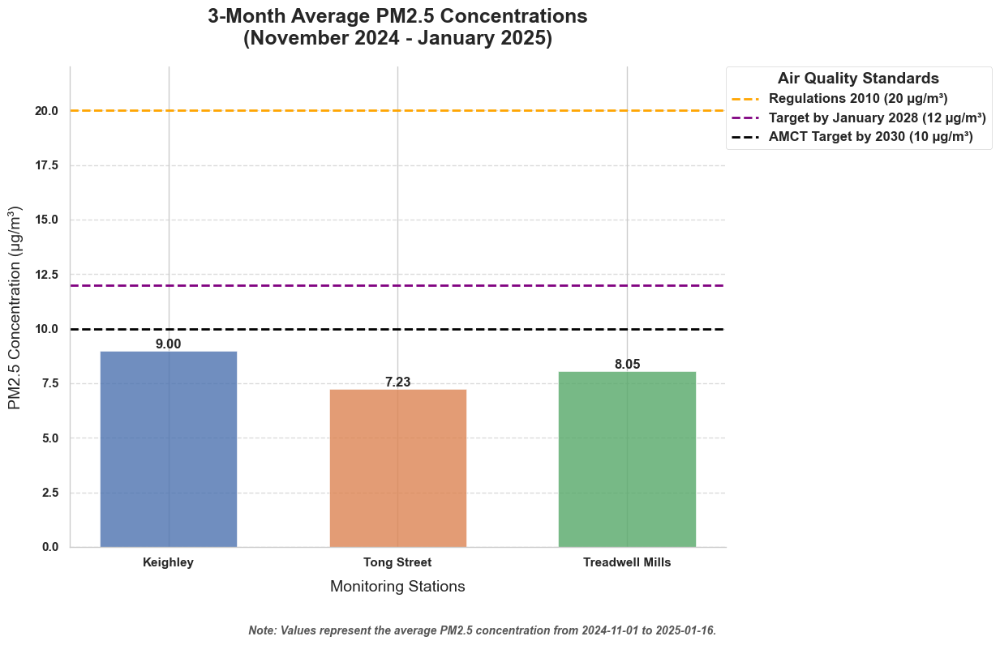

In [ ]:
# Set the style for the plot to make it look more professional and easier to interpret
# White grid style gives the plot a clean, minimalistic look, which enhances readability
sns.set_style("whitegrid")
sns.set_palette("deep")  # Using a "deep" color palette for better color contrast
plt.rcParams['font.family'] = 'Arial'  # Set the font family to Arial for the plot text for a modern look

# Filter the data to only include entries between November 1st, 2024 and January 16th, 2025
# This limits the analysis to a specific period of time for PM2.5 concentration comparison
start_date = '2024-11-01'  # Define the start date for the filtering period
end_date = '2025-01-16'  # Define the end date for the filtering period
# Filtering the 'bradford_final' DataFrame to include only data within the specified date range
filtered_data = bradford_final[(bradford_final['Date Time'] >= start_date) & (bradford_final['Date Time'] <= end_date)]

# Calculate the 3-month average PM2.5 concentration for each station within the filtered data
# This will help to compare the air quality across different monitoring stations over the defined period
keighley_avg = filtered_data['Bradford Keighley PM2.5'].mean()  # Calculate the average PM2.5 for Keighley station
tong_street_avg = filtered_data['Bradford Tong Street PM2.5'].mean()  # Calculate the average PM2.5 for Tong Street station
treadwell_mills_avg = filtered_data['Bradford Treadwell Mills PM2.5'].mean()  # Calculate the average PM2.5 for Treadwell Mills station

# Prepare the data for plotting by creating lists of station names and their corresponding average PM2.5 values
stations = ['Keighley', 'Tong Street', 'Treadwell Mills']  # List of station names for the x-axis labels
avg_pm25 = [keighley_avg, tong_street_avg, treadwell_mills_avg]  # List of average PM2.5 concentrations for the bars

# Create a bar plot to visualize the average PM2.5 concentrations for each station
# A bar chart is chosen to show a clear comparison between the three stations
fig, ax = plt.subplots(figsize=(12, 8))  # Create a figure with a specific size for better visibility

# Plot the bar chart, specifying colors, transparency, and width of the bars
bars = ax.bar(stations, avg_pm25, color=sns.color_palette("deep"), alpha=0.8, width=0.6)

# Add horizontal lines to the plot to represent the various air quality standards for PM2.5 concentration
# These horizontal lines provide context for comparing the measured values against regulatory targets
ax.axhline(y=20, color='#FFA500', linestyle='--', linewidth=2, label='Regulations 2010 (20 µg/m³)')  # Line for 20 µg/m³ threshold
ax.axhline(y=12, color='#800080', linestyle='--', linewidth=2, label='Target by January 2028 (12 µg/m³)')  # Line for 12 µg/m³ target
ax.axhline(y=10, color='#000000', linestyle='--', linewidth=2, label='AMCT Target by 2030 (10 µg/m³)')  # Line for 10 µg/m³ target

# Enhance the plot with a title and axis labels
ax.set_title('3-Month Average PM2.5 Concentrations\n(November 2024 - January 2025)', fontsize=18, fontweight='bold', pad=20)
ax.set_xlabel('Monitoring Stations', fontsize=14, labelpad=10)  # Label for the x-axis (stations)
ax.set_ylabel('PM2.5 Concentration (µg/m³)', fontsize=14, labelpad=10)  # Label for the y-axis (PM2.5 concentration)

# Customize the y-axis to ensure it's scaled appropriately for the data
# The y-axis limit is set to 110% of the maximum PM2.5 value or 20, whichever is greater, ensuring no data is clipped
ax.set_ylim(0, max(max(avg_pm25), 20) * 1.1)
ax.yaxis.grid(True, linestyle='--', alpha=0.7)  # Add gridlines to the y-axis for easier readability of values

# Remove the top and right spines for a cleaner, less cluttered plot appearance
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add value labels on top of the bars to show the exact PM2.5 concentration values for each station
# This provides more precise information for the viewer
for bar in bars:
    height = bar.get_height()  # Get the height of each bar (i.e., the PM2.5 value)
    ax.text(bar.get_x() + bar.get_width()/2., height,  # Position the label in the middle of the bar
            f'{height:.2f}',  # Format the value with two decimal places
            ha='center', va='bottom', fontsize=12)  # Set alignment and font size for readability

# Customize the legend to explain the horizontal lines representing the air quality standards
ax.legend(title='Air Quality Standards', fontsize=12, title_fontsize=14, loc='upper left',
          bbox_to_anchor=(1, 1), borderaxespad=0)  # Position the legend outside the plot for better clarity

# Add a text note at the bottom of the figure explaining the time period of the data used
fig.text(0.5, 0.02,
         f"Note: Values represent the average PM2.5 concentration from {start_date} to {end_date}.",  # Time period note
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Adjust layout to make sure the plot fits properly and all elements are clearly visible
plt.tight_layout()  # Adjust plot parameters to prevent clipping
fig.subplots_adjust(right=0.75, bottom=0.15)  # Adjust the space on the right and bottom for the legend and text

# Show the plot on the screen
plt.show()


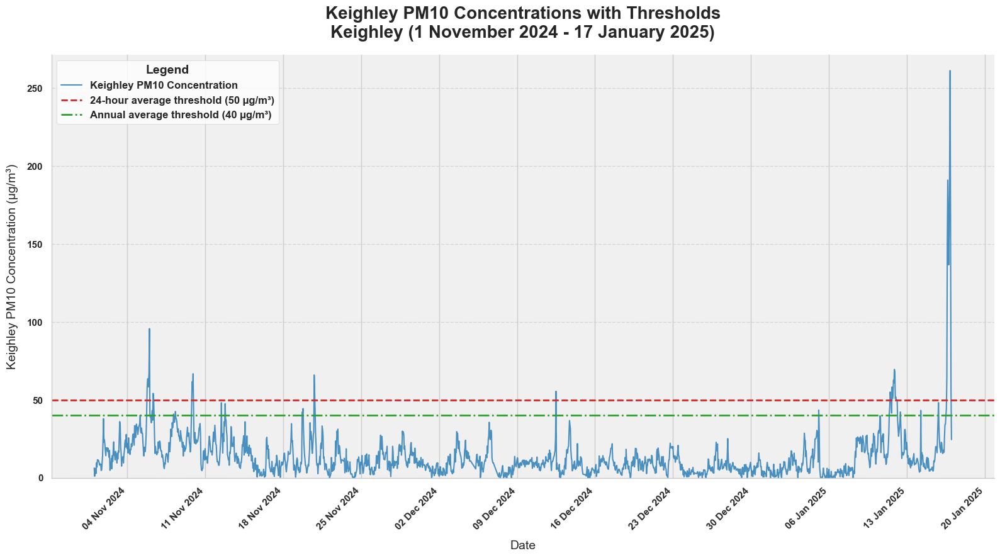

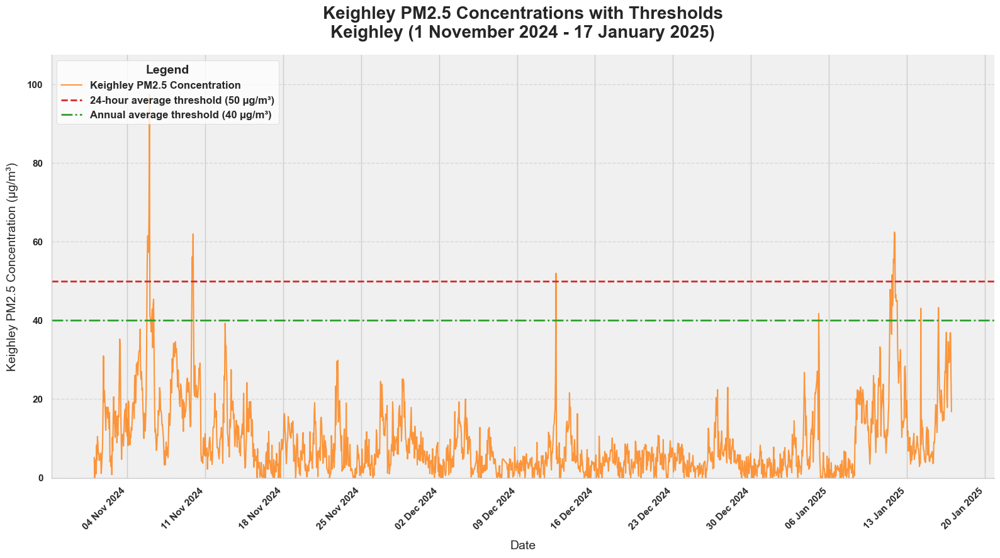

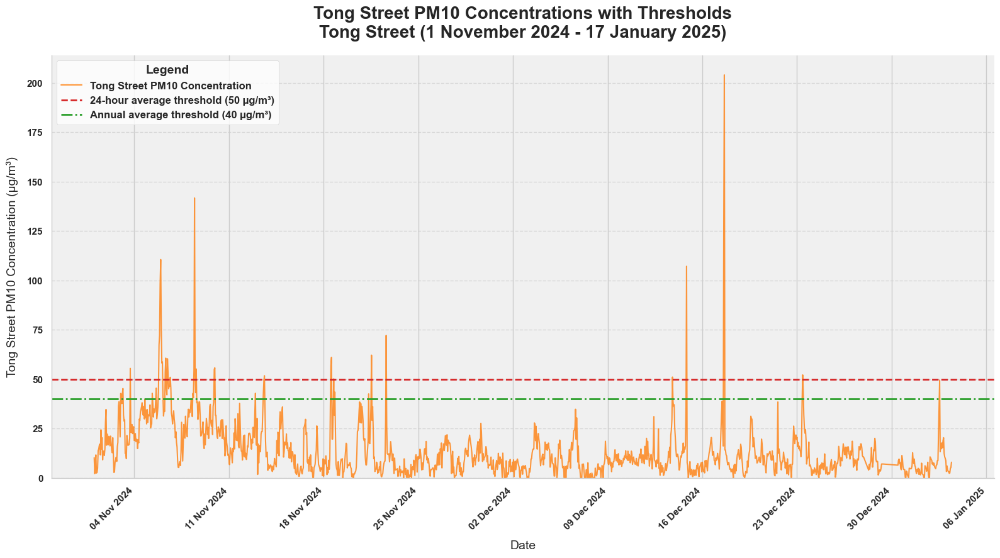

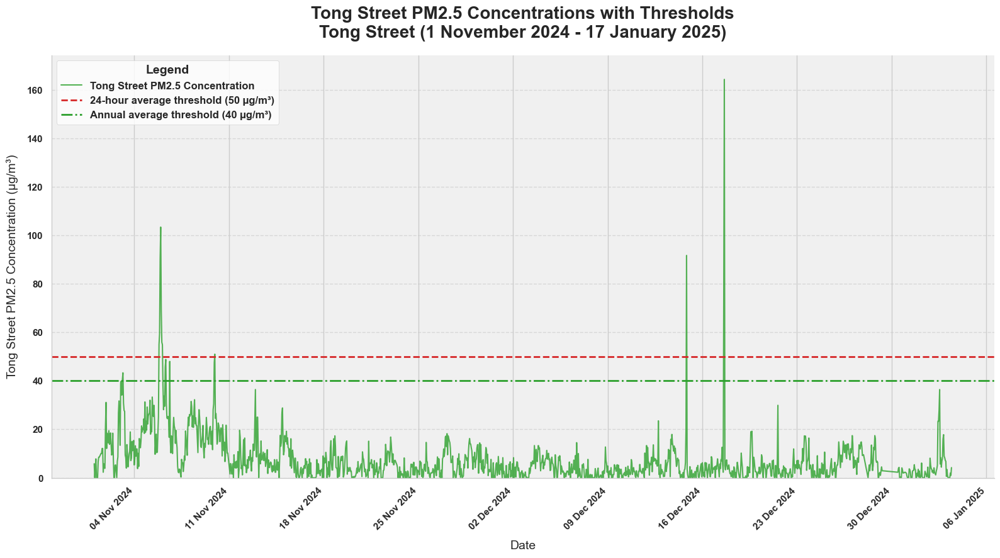

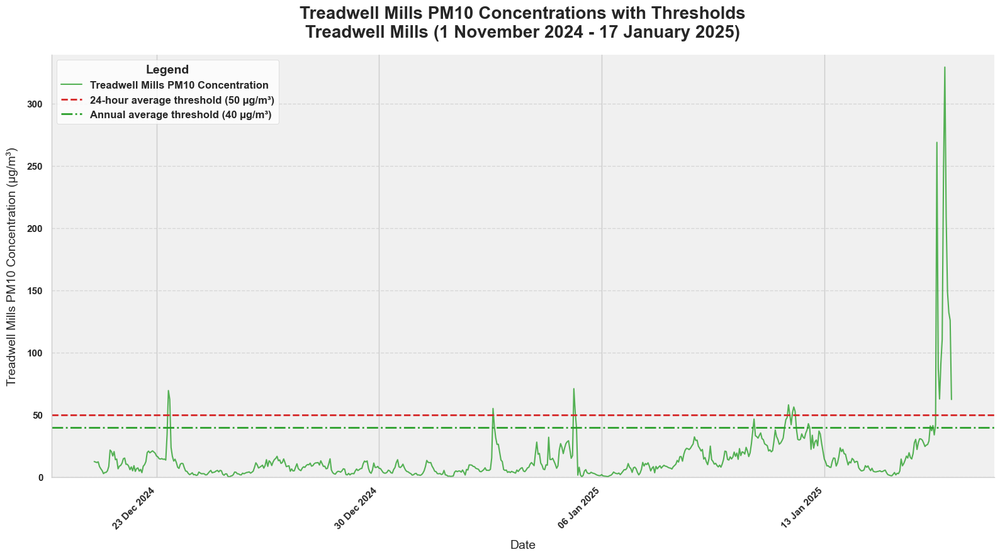

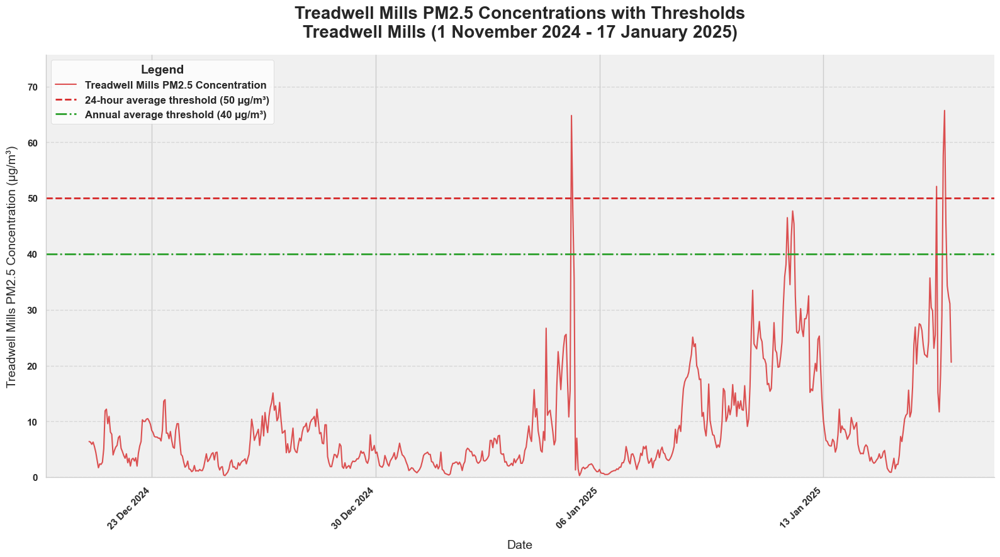

In [ ]:
# This code visualizes the concentration of PM10 and PM2.5 pollutants in Bradford, UK, between November 1, 2024, and January 17, 2025.
# It ensures that the data is cleaned, filtered, and resampled for accurate plotting.
# The purpose is to visualize pollutant levels across three locations: Keighley, Tong Street, and Treadwell Mills, and compare them against regulatory thresholds.

# Set the style for a more professional look
sns.set_style("whitegrid")  # Setting the background to white grid
plt.rcParams['font.family'] = 'Arial'  # Set the default font to Arial for clarity and consistency

# Assuming the 'bradford_final' DataFrame is already loaded
# Convert 'Date Time' column to pandas datetime format for easier manipulation
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'], errors='coerce')

# Filter data for the given date range (01/11/2024 to 17/01/2025)
start_date = '2024-11-01'  # Starting date of the data range
end_date = '2025-01-17'    # Ending date of the data range
# Filter the dataset based on the Date Time column
filtered_data = bradford_final[(bradford_final['Date Time'] >= start_date) & (bradford_final['Date Time'] <= end_date)]

# Replace missing PM10 and PM2.5 values with NaN for clarity
# Convert the PM10 and PM2.5 values to numeric, coercing errors into NaN if the conversion fails
filtered_data['Bradford Keighley PM10'] = pd.to_numeric(filtered_data['Bradford Keighley PM10'], errors='coerce')
filtered_data['Bradford Tong Street PM10'] = pd.to_numeric(filtered_data['Bradford Tong Street PM10'], errors='coerce')
filtered_data['Bradford Treadwell Mills PM10'] = pd.to_numeric(filtered_data['Bradford Treadwell Mills PM10'], errors='coerce')

filtered_data['Bradford Keighley PM2.5'] = pd.to_numeric(filtered_data['Bradford Keighley PM2.5'], errors='coerce')
filtered_data['Bradford Tong Street PM2.5'] = pd.to_numeric(filtered_data['Bradford Tong Street PM2.5'], errors='coerce')
filtered_data['Bradford Treadwell Mills PM2.5'] = pd.to_numeric(filtered_data['Bradford Treadwell Mills PM2.5'], errors='coerce')

# Resampling data to ensure continuity in the plot
# Create a date range covering every hour between the start and end dates
full_date_range = pd.date_range(start=start_date, end=end_date, freq='H')
# Reindex the filtered data to match this full date range, filling missing values
filtered_data_resampled = filtered_data.set_index('Date Time').reindex(full_date_range, method=None).reset_index()
filtered_data_resampled.rename(columns={'index': 'Date Time'}, inplace=True)  # Rename the 'index' to 'Date Time'

# Function to plot PM10 and PM2.5 for each location
def plot_pm_concentration(pm_column, pm_label, color, title_suffix):
    fig, ax = plt.subplots(figsize=(16, 9))  # Create a figure and axis for plotting
    # Plot the PM concentration data for the given location
    ax.plot(filtered_data_resampled['Date Time'], filtered_data_resampled[pm_column],
            label=f'{pm_label} Concentration', color=color, linewidth=1.5, alpha=0.8)

    # Add horizontal lines indicating regulatory threshold values for PM10
    ax.axhline(y=50, color='#d62728', linestyle='--', linewidth=2, label='24-hour average threshold (50 µg/m³)')
    ax.axhline(y=40, color='#2ca02c', linestyle='-.', linewidth=2, label='Annual average threshold (40 µg/m³)')

    # Dynamically set the y-axis limit based on max PM value, with a buffer of 10 µg/m³
    max_pm_value = filtered_data_resampled[pm_column].max()
    ax.set_ylim(0, max_pm_value + 10)  # Adding a buffer of 10 µg/m³

    # Customize the plot with a title, labels, and axis settings
    ax.set_title(f'{pm_label} Concentrations with Thresholds\n{title_suffix}', fontsize=20, fontweight='bold', pad=20)
    ax.set_xlabel('Date', fontsize=14, labelpad=10)  # X-axis label for Date
    ax.set_ylabel(f'{pm_label} Concentration (µg/m³)', fontsize=14, labelpad=10)  # Y-axis label for Concentration

    # Set the x-axis to show only the first day of the week (Monday) for each week
    ax.xaxis.set_major_locator(WeekdayLocator(byweekday=MO))
    ax.xaxis.set_major_formatter(DateFormatter('%d %b %Y'))  # Format the date as day-month-year
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=45, ha='right')  # Rotate x-axis labels for better visibility

    # Add a grid for the y-axis with dashed lines
    ax.yaxis.grid(True, linestyle='--', alpha=0.7)
    # Remove the top and right spines for a cleaner look
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    # Add a legend to the plot
    ax.legend(fontsize=12, title='Legend', title_fontsize=14, loc='upper left')
    ax.set_facecolor('#f0f0f0')  # Set the background color of the plot

    # Automatically adjust plot layout to prevent label clipping
    plt.tight_layout()
    fig.subplots_adjust(bottom=0.15)  # Adjust bottom margin for better label visibility
    plt.show()  # Display the plot

# Plot PM10 and PM2.5 for each location

# 1. Keighley PM10 and PM2.5
plot_pm_concentration('Bradford Keighley PM10', 'Keighley PM10', '#1f77b4', 'Keighley (1 November 2024 - 17 January 2025)')
plot_pm_concentration('Bradford Keighley PM2.5', 'Keighley PM2.5', '#ff7f0e', 'Keighley (1 November 2024 - 17 January 2025)')

# 2. Tong Street PM10 and PM2.5
plot_pm_concentration('Bradford Tong Street PM10', 'Tong Street PM10', '#ff7f0e', 'Tong Street (1 November 2024 - 17 January 2025)')
plot_pm_concentration('Bradford Tong Street PM2.5', 'Tong Street PM2.5', '#2ca02c', 'Tong Street (1 November 2024 - 17 January 2025)')

# 3. Treadwell Mills PM10 and PM2.5
plot_pm_concentration('Bradford Treadwell Mills PM10', 'Treadwell Mills PM10', '#2ca02c', 'Treadwell Mills (1 November 2024 - 17 January 2025)')
plot_pm_concentration('Bradford Treadwell Mills PM2.5', 'Treadwell Mills PM2.5', '#d62728', 'Treadwell Mills (1 November 2024 - 17 January 2025)')


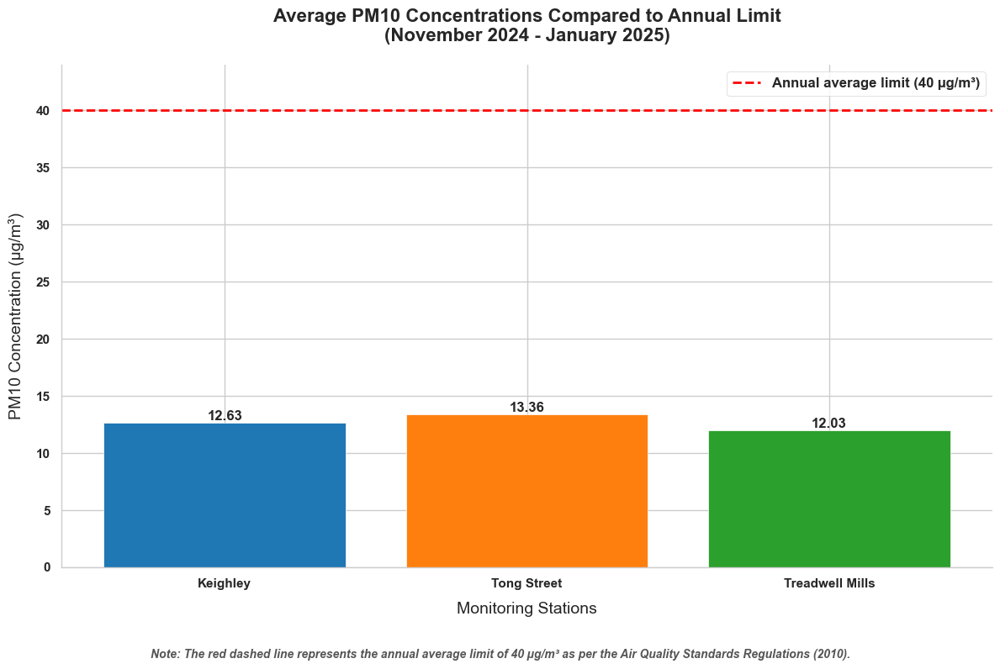

In [ ]:
# This code analyzes and visualizes the average PM10 (Particulate Matter 10) concentrations
# for three monitoring stations (Keighley, Tong Street, Treadwell Mills) over a specific period (November 2024 - January 2025).
# It compares these averages to the annual average limit for PM10 set by air quality standards and generates a bar plot
# with annotations and regulatory information. The plot helps in visually assessing air quality for these locations
# and evaluating if the concentrations are within acceptable limits.

# Assuming 'filtered_data' is already loaded and 'Date Time' is in datetime format

# Ensure 'Date Time' is in the correct format, converting it to datetime format if necessary
filtered_data['Date Time'] = pd.to_datetime(filtered_data['Date Time'], errors='coerce')

# Calculate the average PM10 concentration for each monitoring station.
# PM10 represents particulate matter with a diameter of 10 micrometers or smaller, which can have health impacts.

keighley_avg = filtered_data['Bradford Keighley PM10'].mean()  # Average PM10 concentration for Keighley
tong_avg = filtered_data['Bradford Tong Street PM10'].mean()   # Average PM10 concentration for Tong Street
bradford_avg = filtered_data['Bradford Treadwell Mills PM10'].mean()  # Average PM10 concentration for Treadwell Mills

# Store these averages in a dictionary for easy plotting
averages = {
    'Keighley': keighley_avg,
    'Tong Street': tong_avg,
    'Treadwell Mills': bradford_avg
}

# Set the plot style for a more professional appearance using Seaborn's whitegrid style.
# This adds a grid to the background of the plot, making it easier to read values from the graph.
sns.set_style("whitegrid")

# Set the font family for the plot labels to Arial for better readability.
plt.rcParams['font.family'] = 'Arial'

# Create a figure and axis for plotting the bar chart with a custom size.
fig, ax = plt.subplots(figsize=(12, 8))  # The plot size is 12 inches by 8 inches.

# Plot the average PM10 concentrations as a bar chart.
# The bars are colored using a custom color palette for better distinction between the stations.
bars = ax.bar(averages.keys(), averages.values(), color=['#1f77b4', '#ff7f0e', '#2ca02c'])

# Add a red dashed horizontal line to represent the annual average PM10 limit set by the Air Quality Standards Regulations (2010).
# This line serves as a reference to see if the station's average PM10 concentration exceeds the permissible limit of 40 µg/m³.
ax.axhline(y=40, color='red', linestyle='--', linewidth=2, label='Annual average limit (40 µg/m³)')

# Customize the title of the plot to explain the comparison with the annual limit.
ax.set_title('Average PM10 Concentrations Compared to Annual Limit\n(November 2024 - January 2025)',
             fontsize=16, fontweight='bold', pad=20)  # Title with larger font and padding for better appearance.

# Set labels for the x-axis and y-axis.
ax.set_xlabel('Monitoring Stations', fontsize=14, labelpad=10)  # X-axis label with appropriate font size and padding.
ax.set_ylabel('PM10 Concentration (µg/m³)', fontsize=14, labelpad=10)  # Y-axis label with appropriate font size and padding.

# Adjust the y-axis to ensure it starts from 0 and the maximum value is 10% higher than the highest value in averages or 40, whichever is greater.
ax.set_ylim(0, max(max(averages.values()), 40) * 1.1)

# Annotate the bars with their exact values (the average PM10 concentrations).
# This provides clear information on the chart about the PM10 levels at each station.
for bar in bars:
    height = bar.get_height()  # Get the height (value) of each bar.
    ax.text(bar.get_x() + bar.get_width()/2., height,  # Position the label at the top of the bar.
            f'{height:.2f}',  # Format the value to 2 decimal places.
            ha='center', va='bottom', fontsize=12)  # Label settings.

# Add a legend to the plot for the regulatory line, explaining what the red line represents.
ax.legend(fontsize=12, loc='upper right')  # Legend position in the upper-right corner.

# Remove the top and right spines (edges) of the plot for a cleaner look.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add a textual explanation at the bottom of the plot to clarify what the red dashed line represents.
fig.text(0.5, 0.02,
         "Note: The red dashed line represents the annual average limit of 40 µg/m³ as per the Air Quality Standards Regulations (2010).",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Adjust layout to ensure all plot elements fit neatly.
plt.tight_layout()

# Adjust the spacing for the plot to avoid overlap with the bottom of the figure.
fig.subplots_adjust(bottom=0.15)

# Display the plot with all the customizations applied.
plt.show()


          Date  Count of Instances Above 40 µg/m³
0   2024-11-03                                  5
1   2024-11-05                                  7
2   2024-11-06                                 15
3   2024-11-08                                  7
4   2024-11-09                                  2
5   2024-11-12                                  1
6   2024-11-13                                  3
7   2024-11-18                                  4
8   2024-11-21                                  2
9   2024-11-22                                  1
10  2024-12-13                                  1
11  2024-12-14                                  1
12  2024-12-17                                  2
13  2024-12-23                                  2
14  2025-01-02                                  1


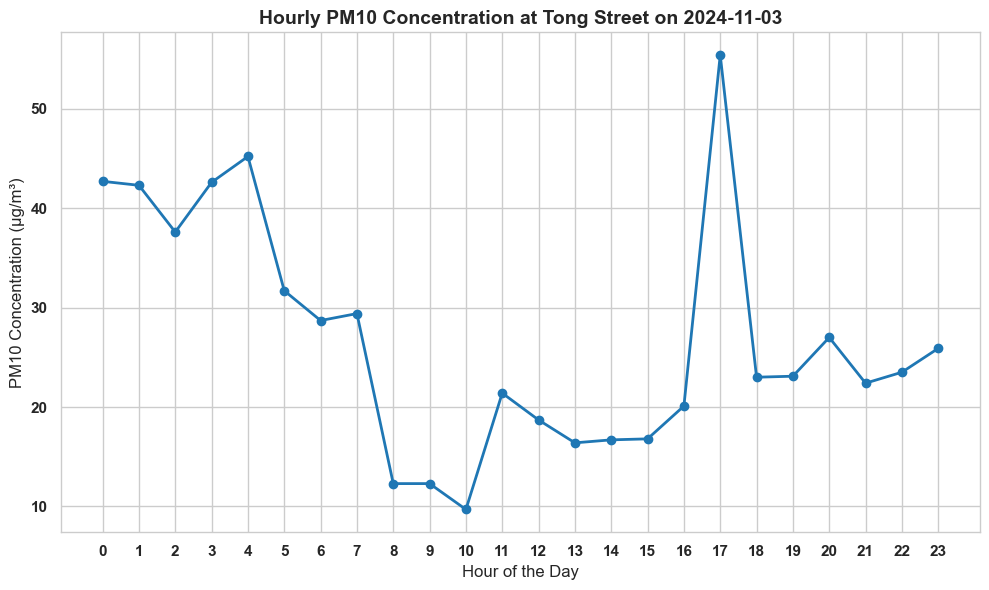

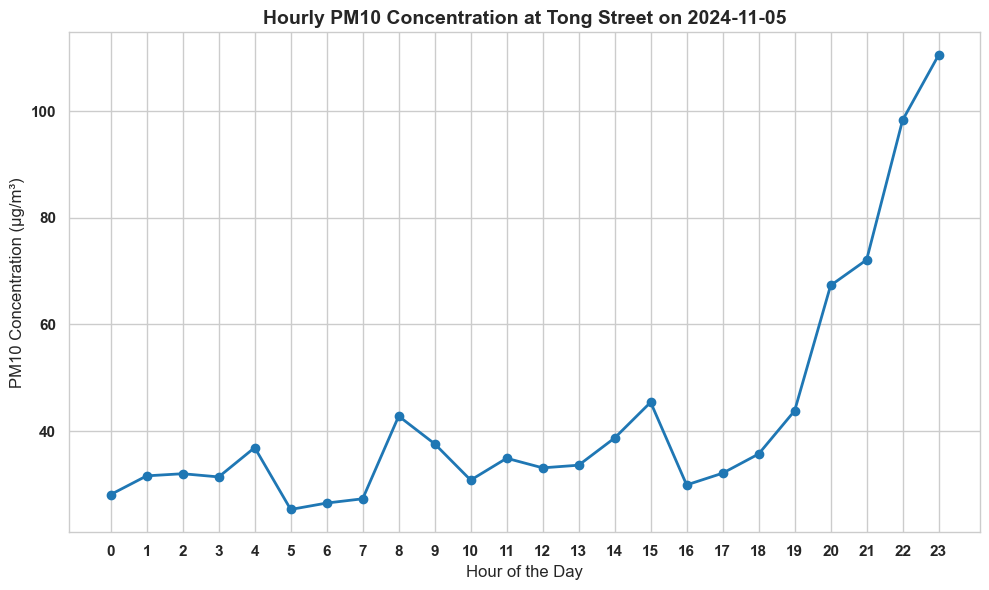

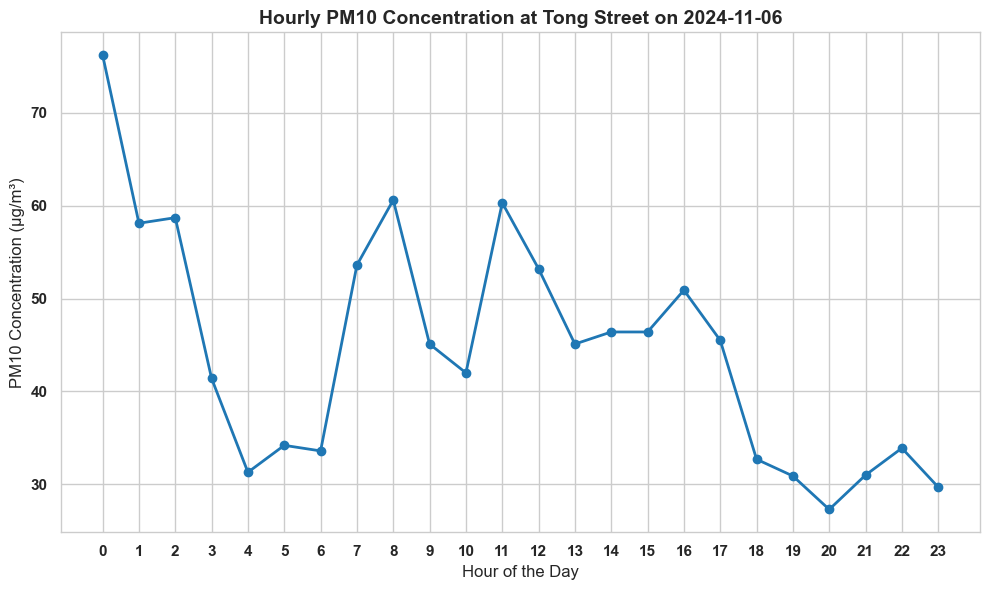

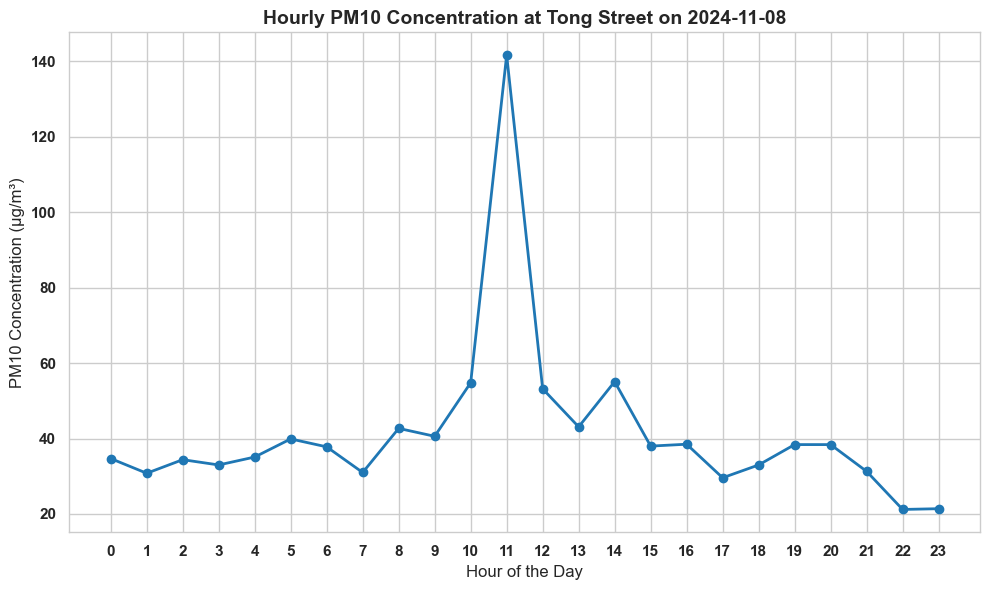

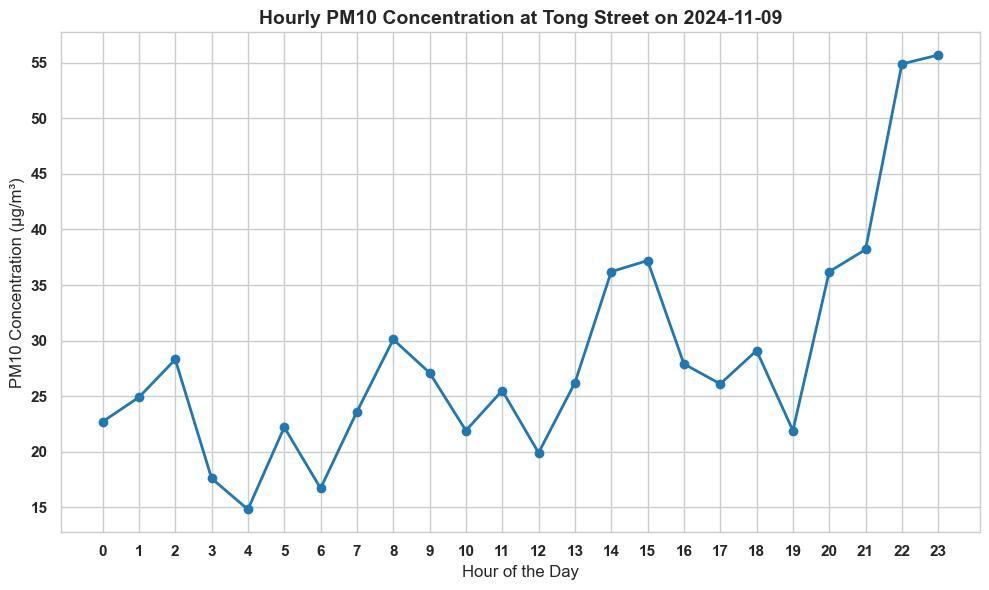

...

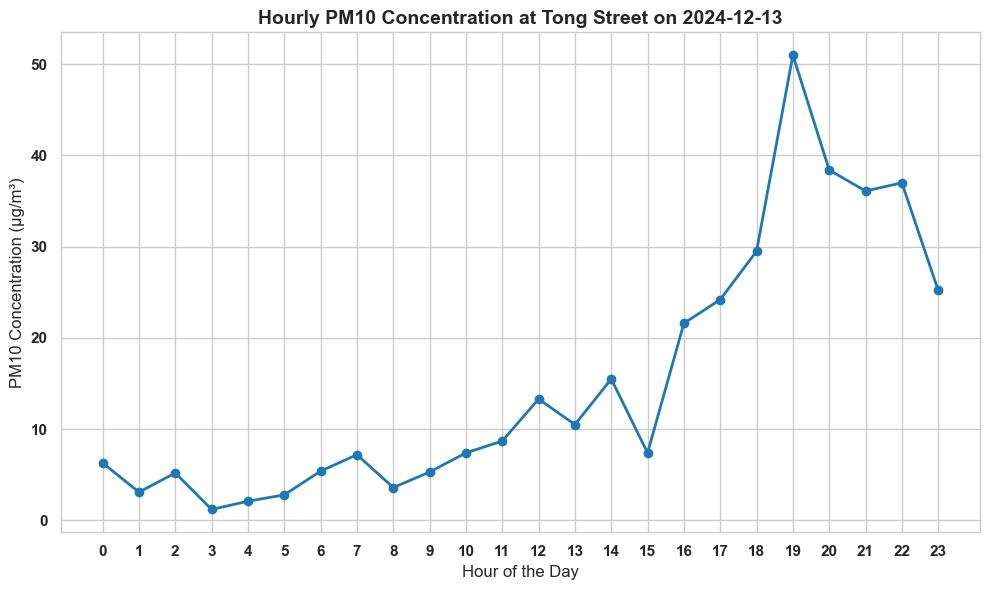

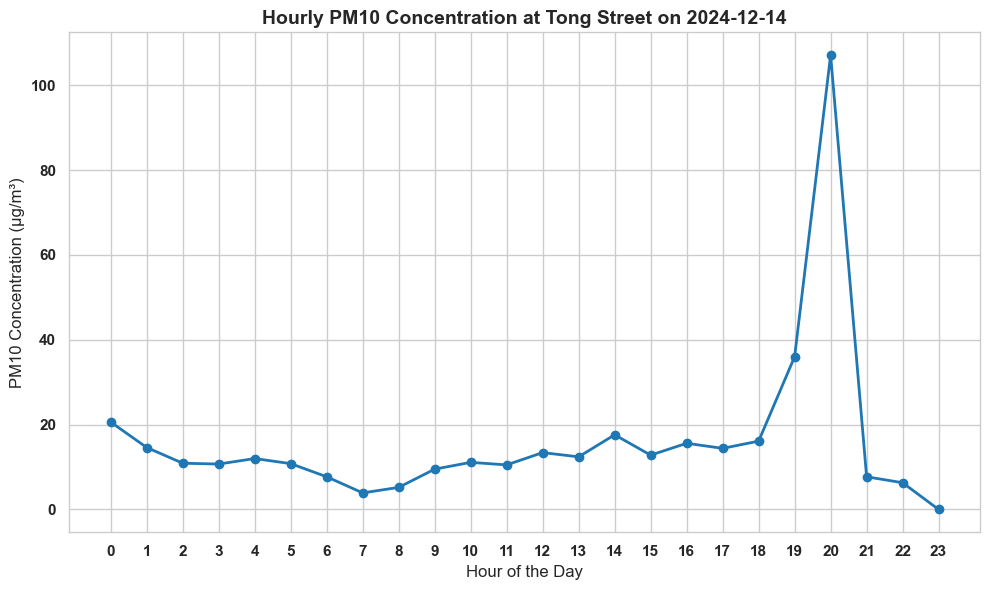

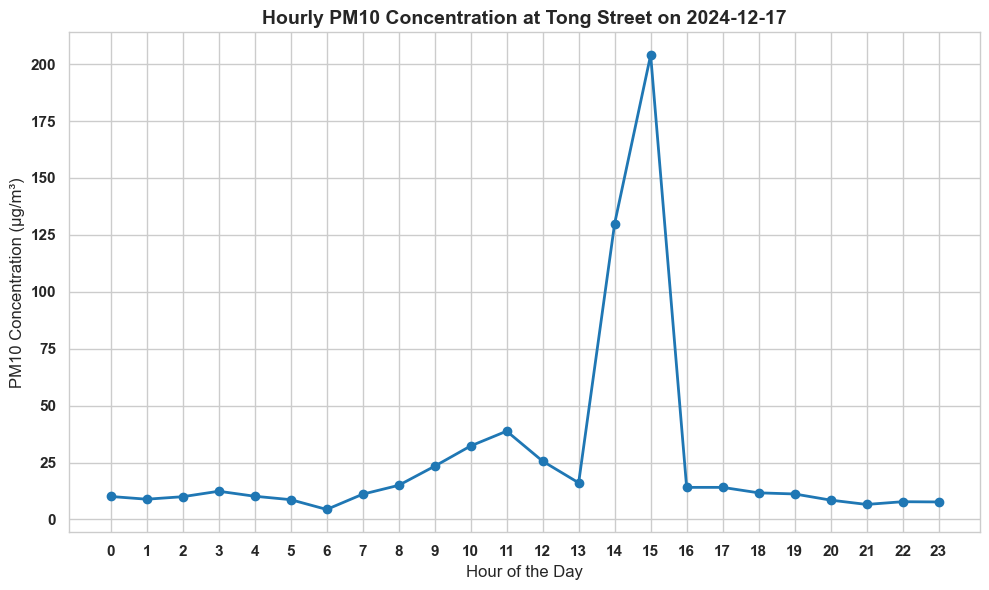

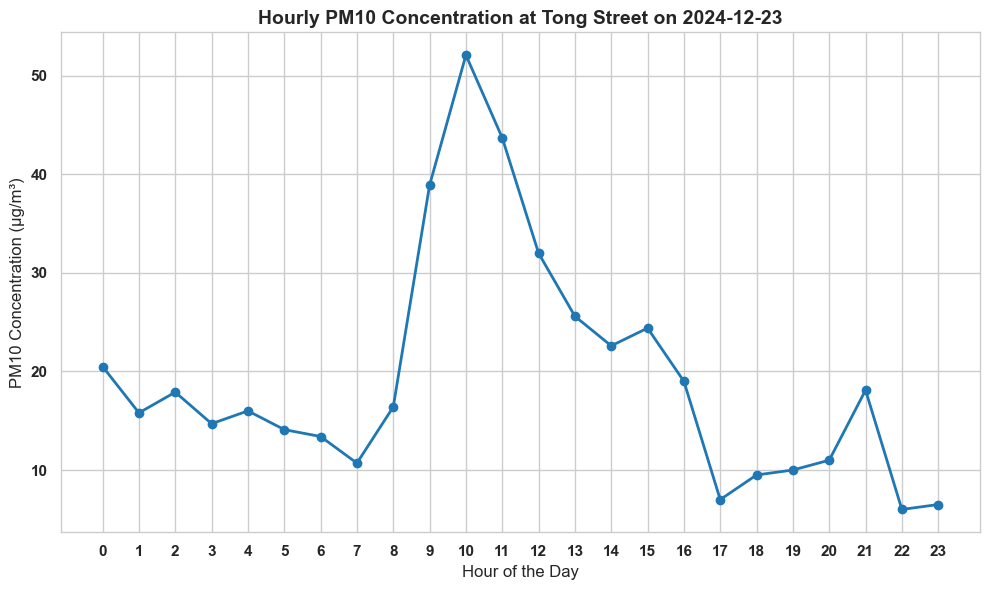

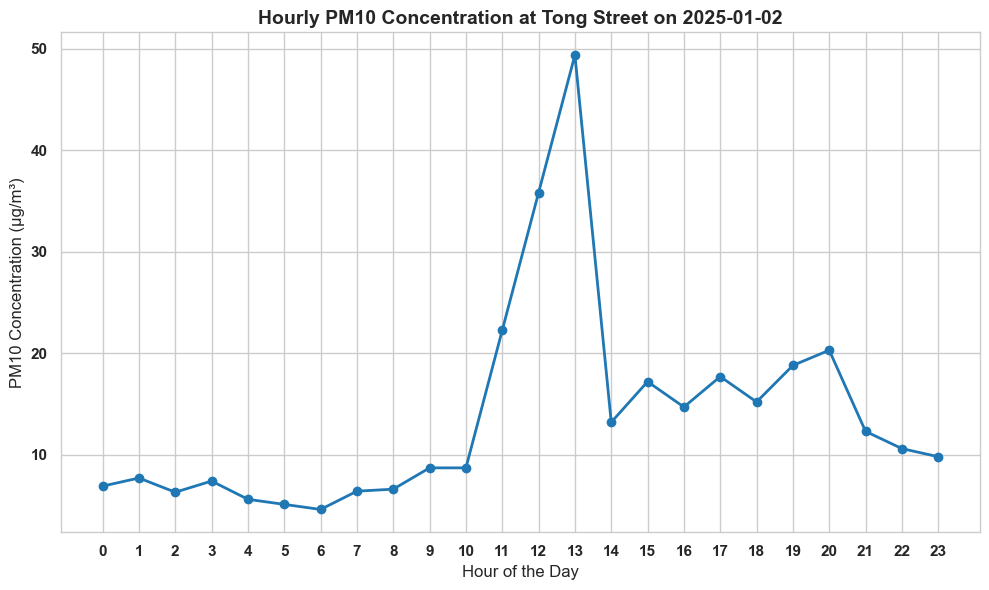

In [ ]:
# Filter data where PM10 levels at Tong Street are above 40 µg/m³
# The goal here is to extract the rows where PM10 concentrations at the 'Bradford Tong Street PM10'
# exceed the 40 µg/m³ threshold, which is considered a significant level of pollution.
high_pm10_data = filtered_data[filtered_data['Bradford Tong Street PM10'] > 40]

# Group by the 'Date Time' (date) and count how many times PM10 exceeded 40 for each day
# We are grouping the data by the date portion of the 'Date Time' and counting how many times
# the PM10 value exceeds 40 µg/m³ for each day. This will help us analyze the frequency of high pollution events per day.
high_pm10_counts = high_pm10_data.groupby(high_pm10_data['Date Time'].dt.date)['Bradford Tong Street PM10'].count().reset_index()

# Rename columns for clarity
# Rename the columns for easier understanding of the data: 'Date' for the date, and 'Count of Instances Above 40 µg/m³'
high_pm10_counts.columns = ['Date', 'Count of Instances Above 40 µg/m³']

# Print the result
# Print the final table that shows for each date, how many instances of high PM10 values (above 40 µg/m³) occurred
print(high_pm10_counts)

import matplotlib.pyplot as plt
import pandas as pd

# Assuming the filtered_data DataFrame is already available and contains the necessary columns

# List of the dates for which we want to plot the hourly trends
# Here, we're specifying the exact dates where we want to observe the hourly variations in PM10 levels.
dates_to_plot = [
    '2024-11-03', '2024-11-05', '2024-11-06', '2024-11-08', '2024-11-09',
    '2024-11-12', '2024-11-13', '2024-11-18', '2024-11-21', '2024-11-22',
    '2024-12-13', '2024-12-14', '2024-12-17', '2024-12-23', '2025-01-02'
]

# Filter data for the specific days
# This filters the 'filtered_data' DataFrame to only include rows where the date matches any of the specified dates in 'dates_to_plot'
filtered_data['Date'] = filtered_data['Date Time'].dt.date
plot_data = filtered_data[filtered_data['Date'].isin(pd.to_datetime(dates_to_plot).date)]

# Create the plot for each date
# We loop through the 'dates_to_plot' list and create an individual plot for each date.
# The plot shows the hourly variation in PM10 levels for Tong Street on each of the selected dates.
for date in dates_to_plot:
    # Filter data for the current date
    # Select data for each specific day to plot the hourly trend of PM10 on that date.
    day_data = plot_data[plot_data['Date'] == pd.to_datetime(date).date()]

    # Plot the hourly trend for PM10 at Tong Street for the specific date
    # For each day, we plot the PM10 concentration against the hour of the day to visualize trends over time.
    plt.figure(figsize=(10, 6))
    plt.plot(day_data['Date Time'].dt.hour, day_data['Bradford Tong Street PM10'], marker='o', color='tab:blue', linestyle='-', linewidth=2)

    # Add titles and labels
    # We add a title, x-axis label, and y-axis label to make the plot informative and clear.
    plt.title(f'Hourly PM10 Concentration at Tong Street on {date}', fontsize=14, fontweight='bold')
    plt.xlabel('Hour of the Day', fontsize=12)
    plt.ylabel('PM10 Concentration (µg/m³)', fontsize=12)

    # Format the x-axis to show hours (24-hour format)
    # We configure the x-axis ticks to represent hours of the day (0-23) for clarity.
    plt.xticks(range(24))
    plt.grid(True)
    plt.tight_layout()

    # Show the plot for this day
    # Display the plot for the current day and move to the next date in the loop.
    plt.show()


Number of days with a 24-hour average above 50 µg/m³ for Keighley: 1
Number of days with a 24-hour average above 50 µg/m³ for Tong Street: 0
Number of days with a 24-hour average above 50 µg/m³ for Treadwell Mills: 1

Dates where the daily PM10 average exceeded 50 µg/m³:
Keighley: DatetimeIndex(['2025-01-16'], dtype='datetime64[ns]', name='Date Time', freq='D')
Tong Street: DatetimeIndex([], dtype='datetime64[ns]', name='Date Time', freq='D')
Treadwell Mills: DatetimeIndex(['2025-01-16'], dtype='datetime64[ns]', name='Date Time', freq='D')


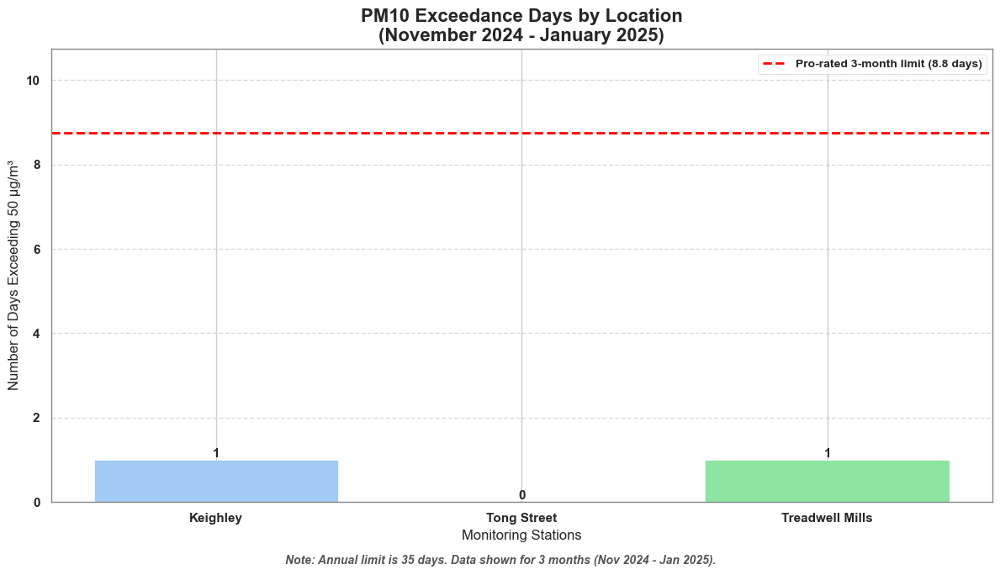

In [ ]:
# Assuming 'bradford_final' DataFrame is already loaded and 'Date Time' is in datetime format

# Convert 'Date Time' to datetime format if not already to ensure correct handling of the date-time column
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'], errors='coerce')

# Filter data for the given date range (01/11/2024 to 16/01/2025, up to 23:00 on 16th January)
# This ensures we are only working with data within the specified range
start_date = '2024-11-01'
end_date = '2025-01-16 23:00:00'
filtered_data = bradford_final[(bradford_final['Date Time'] >= start_date) & (bradford_final['Date Time'] <= end_date)]

# Replace missing PM10 values for each location with NaN for clarity
# Using pd.to_numeric with 'coerce' ensures that any invalid or non-numeric values are replaced with NaN
filtered_data.loc[:, 'Bradford Keighley PM10'] = pd.to_numeric(filtered_data['Bradford Keighley PM10'], errors='coerce')
filtered_data.loc[:, 'Bradford Tong Street PM10'] = pd.to_numeric(filtered_data['Bradford Tong Street PM10'], errors='coerce')
filtered_data.loc[:, 'Bradford Treadwell Mills PM10'] = pd.to_numeric(filtered_data['Bradford Treadwell Mills PM10'], errors='coerce')

# Resample the data to daily averages by grouping by date and calculating the mean PM10 concentration for each day
daily_data_keighley = filtered_data.resample('D', on='Date Time')['Bradford Keighley PM10'].mean()
daily_data_tong_street = filtered_data.resample('D', on='Date Time')['Bradford Tong Street PM10'].mean()
daily_data_treadwell_mills = filtered_data.resample('D', on='Date Time')['Bradford Treadwell Mills PM10'].mean()

# Get the dates where the daily average exceeds 50 µg/m³ for each location
# This identifies the days that have unhealthy PM10 levels at each monitoring station
exceed_50_keighley_dates = daily_data_keighley[daily_data_keighley > 50].index
exceed_50_tong_street_dates = daily_data_tong_street[daily_data_tong_street > 50].index
exceed_50_treadwell_mills_dates = daily_data_treadwell_mills[daily_data_treadwell_mills > 50].index

# Count the number of days where the daily average exceeds 50 µg/m³
# This gives us the count of exceedances for each location
exceed_50_keighley = exceed_50_keighley_dates.size
exceed_50_tong_street = exceed_50_tong_street_dates.size
exceed_50_treadwell_mills = exceed_50_treadwell_mills_dates.size

# Display the number of days where PM10 levels exceeded 50 µg/m³ for each location
print(f"Number of days with a 24-hour average above 50 µg/m³ for Keighley: {exceed_50_keighley}")
print(f"Number of days with a 24-hour average above 50 µg/m³ for Tong Street: {exceed_50_tong_street}")
print(f"Number of days with a 24-hour average above 50 µg/m³ for Treadwell Mills: {exceed_50_treadwell_mills}")

# Print the exact dates where PM10 exceeded 50 µg/m³
# This provides a clear list of dates for each station where the PM10 levels were unhealthy
print("\nDates where the daily PM10 average exceeded 50 µg/m³:")
print(f"Keighley: {exceed_50_keighley_dates}")
print(f"Tong Street: {exceed_50_tong_street_dates}")
print(f"Treadwell Mills: {exceed_50_treadwell_mills_dates}")

# Set the style for the plot using Seaborn's pre-configured themes
sns.set_style("whitegrid")
sns.set_palette("deep")

# Define the locations and the count of days exceeding 50 µg/m³
locations = ['Keighley', 'Tong Street', 'Treadwell Mills']
days_above_50 = [1, 0, 1]  # These numbers should be based on the previous analysis
months_monitored = 3  # The number of months being considered for this analysis
annual_limit = 35  # The annual limit for PM10 exceedance days

# Create the figure and axis for the plot
fig, ax = plt.subplots(figsize=(12, 7))

# Create the bar plot to visualize the number of days PM10 exceeded 50 µg/m³ at each location
# Using a pastel color palette for a softer visual appearance
bars = ax.bar(locations, days_above_50, color=sns.color_palette("pastel")[0:3])

# Add a red dashed line to indicate the pro-rated annual limit for 3 months
# This shows how many exceedance days are acceptable for the given period
prorated_limit = annual_limit * (months_monitored / 12)
ax.axhline(y=prorated_limit, color='red', linestyle='--', linewidth=2,
           label=f'Pro-rated 3-month limit ({prorated_limit:.1f} days)')

# Customize the plot with titles and labels
ax.set_title('PM10 Exceedance Days by Location\n(November 2024 - January 2025)', fontsize=16, fontweight='bold')
ax.set_xlabel('Monitoring Stations', fontsize=12)
ax.set_ylabel('Number of Days Exceeding 50 µg/m³', fontsize=12)

# Add value labels above each bar to display the exact number of exceedance days
for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{height}',  # Display the height of the bar (number of exceedance days)
            ha='center', va='bottom', fontsize=11, fontweight='bold')

# Set y-axis limit and ticks for better readability of the plot
ax.set_ylim(0, max(max(days_above_50) + 2, prorated_limit + 2))  # Ensure the limit accommodates the highest data
ax.set_yticks(np.arange(0, ax.get_ylim()[1], 2))

# Enhance the grid, legend, and plot borders (spines) for better aesthetics
ax.grid(axis='y', linestyle='--', alpha=0.7)
ax.legend(fontsize=10, loc='upper right')
for spine in ax.spines.values():
    spine.set_edgecolor('#888888')

# Add explanatory text at the bottom of the plot to clarify the analysis period and limits
fig.text(0.5, 0.02,
         f"Note: Annual limit is 35 days. Data shown for {months_monitored} months (Nov 2024 - Jan 2025).",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Adjust layout for a neat presentation
plt.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.show()  # Display the plot


Average PM2.5 for Keighley: 9.19 µg/m³
Average PM2.5 for Tong Street: 7.23 µg/m³
Average PM2.5 for Treadwell Mills: 8.85 µg/m³


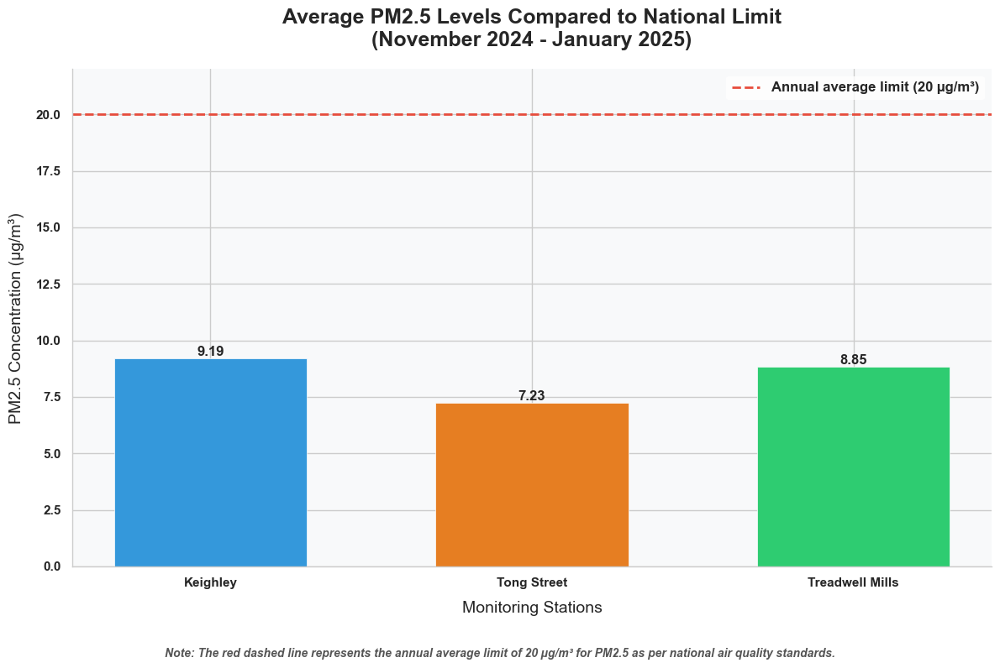

In [ ]:
# Convert 'Date Time' to datetime format if not already
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'], errors='coerce')

# Filter data for the given date range (01/11/2024 to 16/01/2025, up to 23:00 on 16th January)
start_date = '2024-11-01'
end_date = '2025-01-16 23:00:00'
filtered_data = bradford_final[(bradford_final['Date Time'] >= start_date) & (bradford_final['Date Time'] <= end_date)]

# Replace missing PM2.5 values for each location with NaN for clarity using .loc to avoid SettingWithCopyWarning
filtered_data.loc[:, 'Bradford Keighley PM2.5'] = pd.to_numeric(filtered_data['Bradford Keighley PM2.5'], errors='coerce')
filtered_data.loc[:, 'Bradford Tong Street PM2.5'] = pd.to_numeric(filtered_data['Bradford Tong Street PM2.5'], errors='coerce')
filtered_data.loc[:, 'Bradford Treadwell Mills PM2.5'] = pd.to_numeric(filtered_data['Bradford Treadwell Mills PM2.5'], errors='coerce')

# Calculate the average PM2.5 for each location
avg_keighley_pm25 = filtered_data['Bradford Keighley PM2.5'].mean()
avg_tong_street_pm25 = filtered_data['Bradford Tong Street PM2.5'].mean()
avg_treadwell_mills_pm25 = filtered_data['Bradford Treadwell Mills PM2.5'].mean()

# Display the average PM2.5 for each location
print(f"Average PM2.5 for Keighley: {avg_keighley_pm25:.2f} µg/m³")
print(f"Average PM2.5 for Tong Street: {avg_tong_street_pm25:.2f} µg/m³")
print(f"Average PM2.5 for Treadwell Mills: {avg_treadwell_mills_pm25:.2f} µg/m³")

# Set the style for a more professional look
# This will apply a white grid background to the plot for a clean, professional appearance.
sns.set_style("whitegrid")

# Set the default font to Arial for a consistent and readable font across the plot.
plt.rcParams['font.family'] = 'Arial'

# Data for plotting:
locations = ['Keighley', 'Tong Street', 'Treadwell Mills']  # Locations where PM2.5 data was collected
averages = [avg_keighley_pm25, avg_tong_street_pm25, avg_treadwell_mills_pm25]  # Average PM2.5 concentrations for each location
colors = ['#3498db', '#e67e22', '#2ecc71']  # Color palette for the bars (blue, orange, green)

# Create the plot with a specified size (12x8 inches)
fig, ax = plt.subplots(figsize=(12, 8))

# Plot the bars for each location with the corresponding average PM2.5 levels and colors
bars = ax.bar(locations, averages, color=colors, width=0.6)  # Bar width is set to 0.6 for better visual appeal

# Add a horizontal line representing the national annual average PM2.5 limit of 20 µg/m³
# This line helps to compare the monitored locations' averages to the national standard.
ax.axhline(y=20, color='#e74c3c', linestyle='--', linewidth=2, label='Annual average limit (20 µg/m³)')

# Customize the plot's appearance
ax.set_title('Average PM2.5 Levels Compared to National Limit\n(November 2024 - January 2025)',
             fontsize=18, fontweight='bold', pad=20)  # Set title with font size 18 and bold weight
ax.set_xlabel('Monitoring Stations', fontsize=14, labelpad=10)  # Set x-axis label
ax.set_ylabel('PM2.5 Concentration (µg/m³)', fontsize=14, labelpad=10)  # Set y-axis label

# Set y-axis limits from 0 to 10% above the maximum value or 20, whichever is higher
ax.set_ylim(0, max(max(averages), 20) * 1.1)

# Add value labels on top of each bar to show the exact PM2.5 concentration
# This makes it easier for viewers to interpret the exact values.
for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{height:.2f}',  # Format to show 2 decimal places
            ha='center', va='bottom', fontsize=12, fontweight='bold')  # Position the label above each bar

# Customize the legend to make it more readable
# The red dashed line represents the annual average limit, and the legend explains that.
ax.legend(fontsize=12, loc='upper right', frameon=True, facecolor='white', edgecolor='none')

# Remove the top and right spines (the borders of the plot) for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add a text explanation at the bottom of the plot to clarify the meaning of the red dashed line
# This note provides context for viewers, explaining that the line represents the annual limit for PM2.5.
fig.text(0.5, 0.02,
         "Note: The red dashed line represents the annual average limit of 20 µg/m³ for PM2.5 as per national air quality standards.",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Add a subtle background color to the plot area to make it visually appealing and soften the contrast
ax.set_facecolor('#f8f9fa')

# Adjust layout to ensure everything fits well within the figure area
plt.tight_layout()

# Adjust the bottom margin to prevent clipping of the text explanation
fig.subplots_adjust(bottom=0.15)

# Display the plot
plt.show()


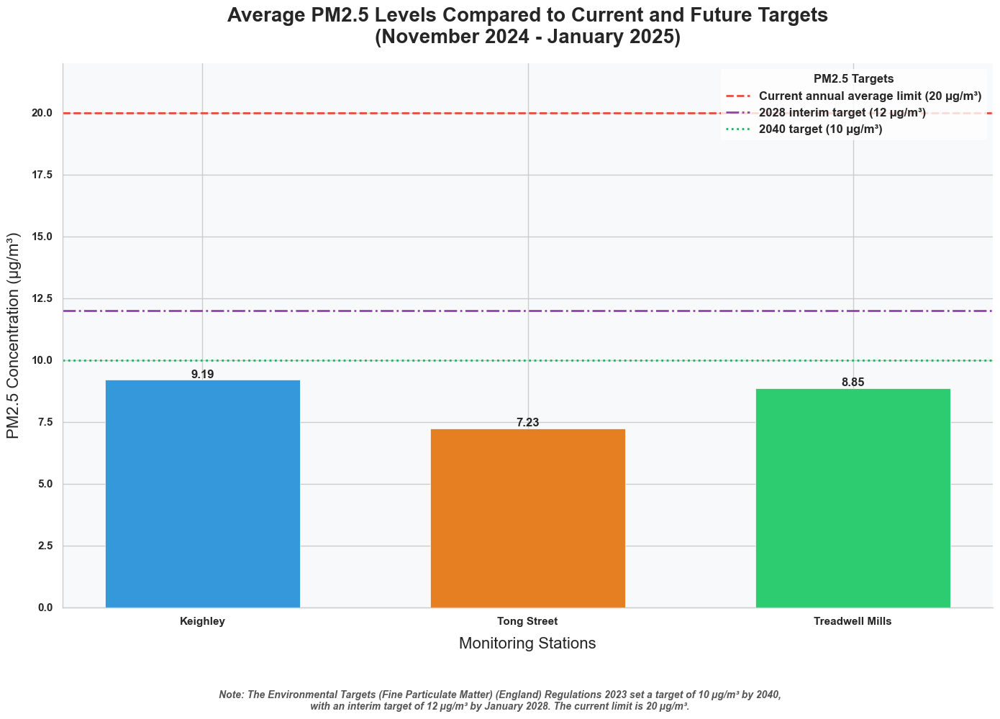

In [ ]:
# Import necessary libraries for plotting and data handling
import matplotlib.pyplot as plt  # For creating the plot
import seaborn as sns  # For setting the style of the plot (visual aesthetics)
import numpy as np  # For handling numerical data (though not used in this snippet, it's imported for potential use)

# Set the style for a more professional look
# Seaborn style is set to "whitegrid", which applies a white background with gridlines to the plot for better readability.
sns.set_style("whitegrid")

# Set the default font to Arial to maintain a consistent and clear font style across the plot.
plt.rcParams['font.family'] = 'Arial'

# Data for plotting
# The 'locations' list contains the names of the monitoring stations that are being analyzed.
locations = ['Keighley', 'Tong Street', 'Treadwell Mills']

# The 'averages' list holds the average PM2.5 concentrations (in µg/m³) for each of these locations.
# The actual values (e.g., avg_keighley_pm25) would be predefined earlier in the code or dataset.
averages = [avg_keighley_pm25, avg_tong_street_pm25, avg_treadwell_mills_pm25]

# The 'colors' list defines the color scheme for the bars, providing visual differentiation between the stations.
colors = ['#3498db', '#e67e22', '#2ecc71']  # Blue, Orange, Green

# Create the plot with specific figure size (14 inches by 10 inches)
fig, ax = plt.subplots(figsize=(14, 10))

# Plot the bars with the defined locations, averages, colors, and width
# The bar width is set to 0.6, making the bars moderately wide and spaced.
bars = ax.bar(locations, averages, color=colors, width=0.6)

# Add the target lines for different regulatory limits:
# 1. The current annual average limit (20 µg/m³) is represented by a red dashed line.
ax.axhline(y=20, color='#e74c3c', linestyle='--', linewidth=2, label='Current annual average limit (20 µg/m³)')

# 2. The 2028 interim target (12 µg/m³) is represented by a purple dash-dot line.
ax.axhline(y=12, color='#8e44ad', linestyle='-.', linewidth=2, label='2028 interim target (12 µg/m³)')

# 3. The 2040 target (10 µg/m³) is represented by a green dotted line.
ax.axhline(y=10, color='#27ae60', linestyle=':', linewidth=2, label='2040 target (10 µg/m³)')

# Customize the plot:
# Set the title of the plot with a bold font and large size for visibility.
# 'pad=20' ensures there's some space between the title and the plot area.
ax.set_title('Average PM2.5 Levels Compared to Current and Future Targets\n(November 2024 - January 2025)',
             fontsize=20, fontweight='bold', pad=20)

# Set the x-axis label with larger font size for clarity.
ax.set_xlabel('Monitoring Stations', fontsize=16, labelpad=10)

# Set the y-axis label with appropriate font size for clarity.
ax.set_ylabel('PM2.5 Concentration (µg/m³)', fontsize=16, labelpad=10)

# Set y-axis limits to ensure the graph starts from 0 and has enough room above the highest average (plus 10% for space).
ax.set_ylim(0, max(max(averages), 20) * 1.1)

# Add value labels on the bars:
# The loop iterates through each bar in the plot to place its exact value above it.
# The height of each bar (PM2.5 level) is extracted and formatted to 2 decimal places for display.
for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{height:.2f}',  # Format height to two decimal places
            ha='center', va='bottom', fontsize=12, fontweight='bold')  # Position the label at the top of the bar

# Customize the legend:
# The legend explains the color and style of the lines representing the targets (current and future PM2.5 limits).
ax.legend(fontsize=12, loc='best', frameon=True, facecolor='white', edgecolor='none', title='PM2.5 Targets')

# Remove the top and right spines (borders of the plot) to make the plot visually cleaner.
# This is a common styling choice to focus on the data.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Add a text explanation below the plot to explain the PM2.5 targets set by regulations.
# This annotation helps contextualize the plot and provide additional details to the viewers.
fig.text(0.5, 0.02,
         "Note: The Environmental Targets (Fine Particulate Matter) (England) Regulations 2023 set a target of 10 µg/m³ by 2040,\n"
         "with an interim target of 12 µg/m³ by January 2028. The current limit is 20 µg/m³.",
         ha='center', va='center', fontsize=10, style='italic', color='#555555')

# Set a subtle background color for the plot area to provide a visually soft contrast with the bars and lines.
ax.set_facecolor('#f8f9fa')

# Adjust the layout so that all plot elements (including labels and legends) fit within the figure area.
plt.tight_layout()

# Adjust the bottom margin to ensure the explanatory text at the bottom is not clipped.
fig.subplots_adjust(bottom=0.15)

# Show the plot on the screen
plt.show()



PM10 exposure in Bradford Keighley:
- High: 9 hours (0.49%)
- Low: 1,812 hours (98.05%)
- Moderate: 27 hours (1.46%)

PM2.5 exposure in Bradford Keighley:
- High: 10 hours (0.54%)
- Low: 1,773 hours (95.94%)
- Moderate: 65 hours (3.52%)

PM10 exposure in Bradford Tong Street:
- High: 6 hours (0.39%)
- Low: 1,492 hours (98.03%)
- Moderate: 24 hours (1.58%)

PM2.5 exposure in Bradford Tong Street:
- High: 8 hours (0.53%)
- Low: 1,488 hours (97.77%)
- Moderate: 26 hours (1.71%)

PM10 exposure in Bradford Treadwell Mills:
- High: 9 hours (1.39%)
- Low: 627 hours (96.76%)
- Moderate: 12 hours (1.85%)

PM2.5 exposure in Bradford Treadwell Mills:
- High: 3 hours (0.46%)
- Low: 623 hours (96.14%)
- Moderate: 22 hours (3.4%)


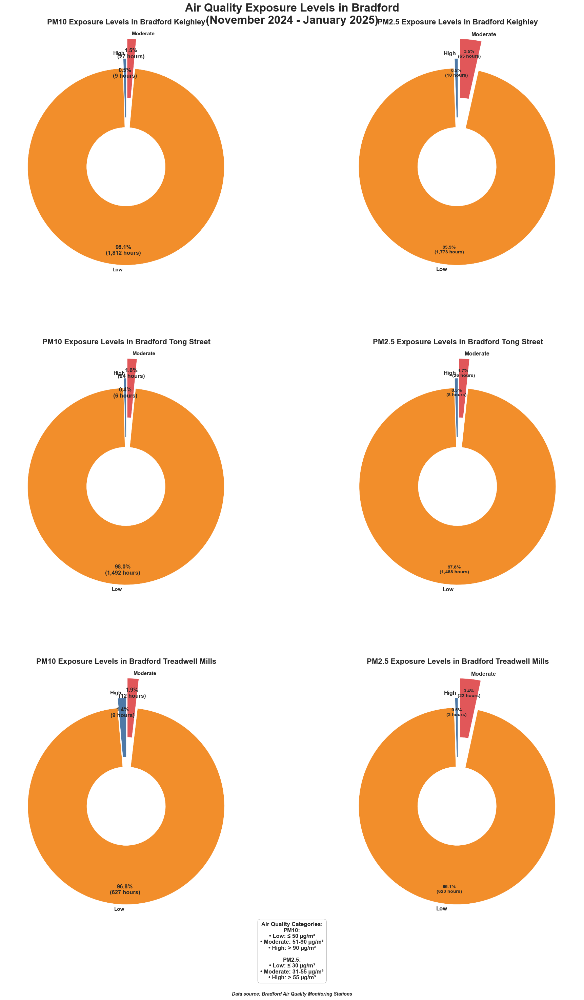

In [ ]:
# Ensure 'Date Time' is in datetime format
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'])

# Function to categorize PM levels
def categorize_pm10(value):
    if value <= 50:
        return 'Low'
    elif value <= 90:
        return 'Moderate'
    else:
        return 'High'

def categorize_pm25(value):
    if value <= 30:
        return 'Low'
    elif value <= 55:
        return 'Moderate'
    else:
        return 'High'

# List of locations and their corresponding column names
locations = [
    ('Bradford Keighley', 'Bradford Keighley PM10', 'Bradford Keighley PM2.5'),
    ('Bradford Tong Street', 'Bradford Tong Street PM10', 'Bradford Tong Street PM2.5'),
    ('Bradford Treadwell Mills', 'Bradford Treadwell Mills PM10', 'Bradford Treadwell Mills PM2.5')
]

# Set up the plot style for a professional look
sns.set_style("whitegrid")
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']
plt.rcParams['font.size'] = 12
plt.rcParams['font.weight'] = 'bold'

# Create subplots
fig, axes = plt.subplots(3, 2, figsize=(20, 30))

# Define professional colors for the chart
colors = ['#4e79a7', '#f28e2b', '#e15759']

# Function to make labels for pie chart
def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct * total / 100.0))
        return f'{pct:.1f}%\n({val:,d} hours)'
    return my_autopct

for i, (location, pm10_col, pm25_col) in enumerate(locations):
    # Apply categorization (exclude rows with missing data in PM10 or PM2.5 columns)
    bradford_final[f'{location} PM10 Category'] = bradford_final[pm10_col].apply(categorize_pm10)
    bradford_final[f'{location} PM2.5 Category'] = bradford_final[pm25_col].apply(categorize_pm25)

    # Filter out rows with missing PM10 or PM2.5 data
    valid_data = bradford_final.dropna(subset=[pm10_col, pm25_col])

    # Count hours for each category
    pm10_exposure = valid_data[f'{location} PM10 Category'].value_counts().sort_index()
    pm25_exposure = valid_data[f'{location} PM2.5 Category'].value_counts().sort_index()

    # Calculate total hours and percentages
    total_hours = len(valid_data)  # Total valid data points (rows)
    pm10_exposure_percent = (pm10_exposure / total_hours * 100).round(2)
    pm25_exposure_percent = (pm25_exposure / total_hours * 100).round(2)

    # PM10 Chart
    explode = (0, 0.1, 0.2)  # explode Moderate and High slices
    wedges, texts, autotexts = axes[i, 0].pie(pm10_exposure, labels=pm10_exposure.index, colors=colors,
                   autopct=make_autopct(pm10_exposure), startangle=90,
                   wedgeprops=dict(width=0.6, edgecolor='white'),
                   explode=explode, pctdistance=0.85, labeldistance=1.05)
    axes[i, 0].set_title(f'PM10 Exposure Levels in {location}', fontsize=16, fontweight='bold', pad=20)

    # PM2.5 Chart
    wedges, texts, autotexts = axes[i, 1].pie(pm25_exposure, labels=pm25_exposure.index, colors=colors,
                   autopct=make_autopct(pm25_exposure), startangle=90,
                   wedgeprops=dict(width=0.6, edgecolor='white'),
                   explode=explode, pctdistance=0.85, labeldistance=1.05)
    axes[i, 1].set_title(f'PM2.5 Exposure Levels in {location}', fontsize=16, fontweight='bold', pad=20)

    # Enhance text appearance
    for autotext in autotexts:
        autotext.set_fontsize(10)
        autotext.set_fontweight('bold')

    for text in texts:
        text.set_fontsize(12)

    # Print results
    print(f"\nPM10 exposure in {location}:")
    for category, hours in pm10_exposure.items():
        print(f"- {category}: {hours:,d} hours ({pm10_exposure_percent[category]}%)")

    print(f"\nPM2.5 exposure in {location}:")
    for category, hours in pm25_exposure.items():
        print(f"- {category}: {hours:,d} hours ({pm25_exposure_percent[category]}%)")

# Add a title for the entire figure
fig.suptitle('Air Quality Exposure Levels in Bradford\n(November 2024 - January 2025)',
             fontsize=24, fontweight='bold', y=0.98)

# Add text box with additional information
text_box = (
    "Air Quality Categories:\n"
    "PM10:\n"
    "• Low: ≤ 50 µg/m³\n"
    "• Moderate: 51-90 µg/m³\n"
    "• High: > 90 µg/m³\n\n"
    "PM2.5:\n"
    "• Low: ≤ 30 µg/m³\n"
    "• Moderate: 31-55 µg/m³\n"
    "• High: > 55 µg/m³"
)

fig.text(0.5, 0.02, text_box, ha='center', va='bottom', fontsize=12,
         bbox=dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='gray', alpha=0.8))

# Add a footer with data source or additional information
fig.text(0.5, 0.005, "Data source: Bradford Air Quality Monitoring Stations", ha='center', fontsize=10, fontstyle='italic')

# Adjust layout and spacing
plt.tight_layout()
plt.subplots_adjust(top=0.95, bottom=0.08, hspace=0.3)
plt.show()


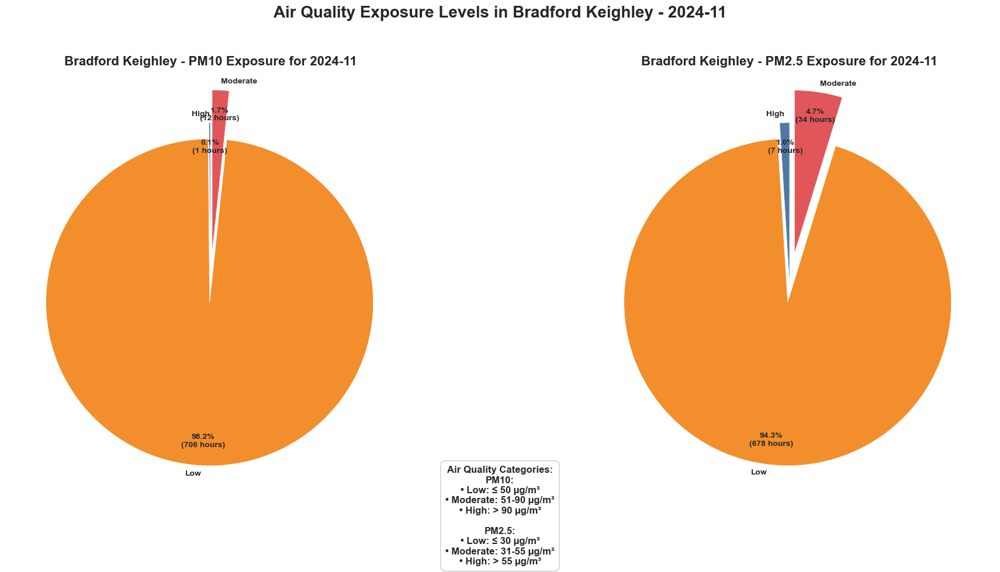

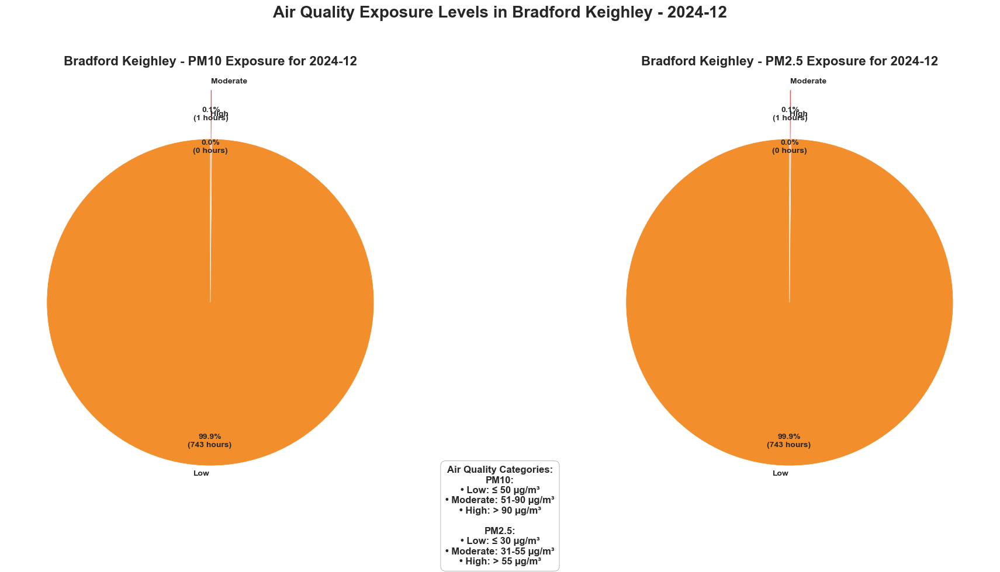

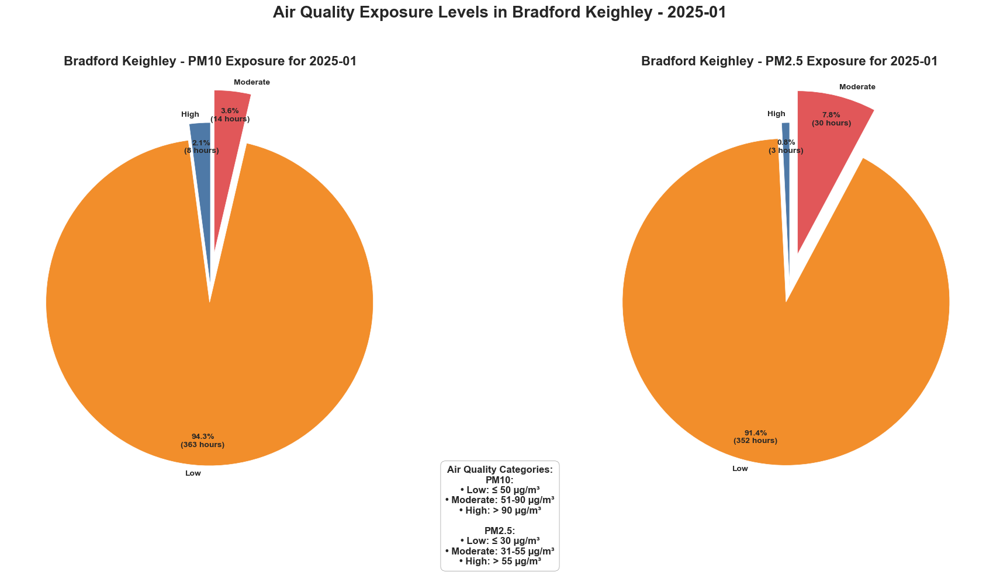


Exposure breakdown for Bradford Keighley:

PM10 Exposure (hours):
Bradford Keighley PM10 Category  High  Low  Moderate
Year-Month                                          
2024-11                             1  706        12
2024-12                             0  743         1
2025-01                             8  363        14

PM10 Percentage Exposure (%):
Bradford Keighley PM10 Category      High        Low  Moderate
Year-Month                                                    
2024-11                          0.139082  98.191933  1.668985
2024-12                          0.000000  99.865591  0.134409
2025-01                          2.077922  94.285714  3.636364

PM2.5 Exposure (hours):
Bradford Keighley PM2.5 Category  High  Low  Moderate
Year-Month                                           
2024-11                              7  678        34
2024-12                              0  743         1
2025-01                              3  352        30

PM2.5 Percentage Exposure 

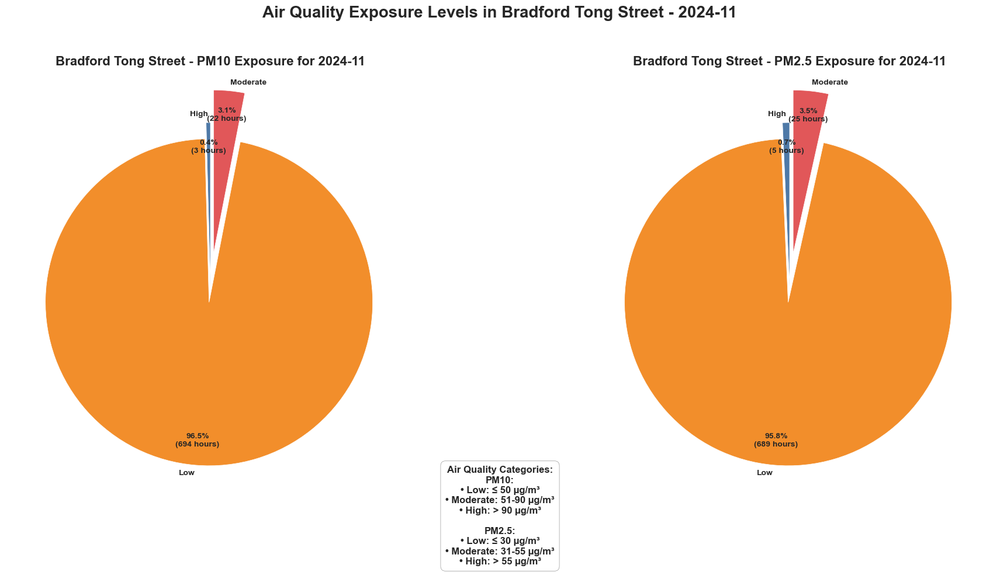

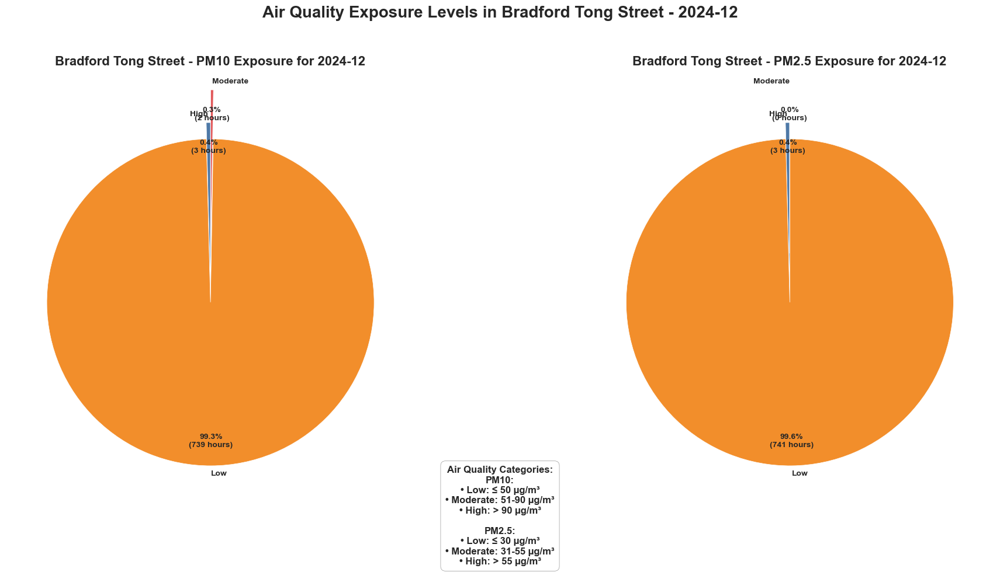

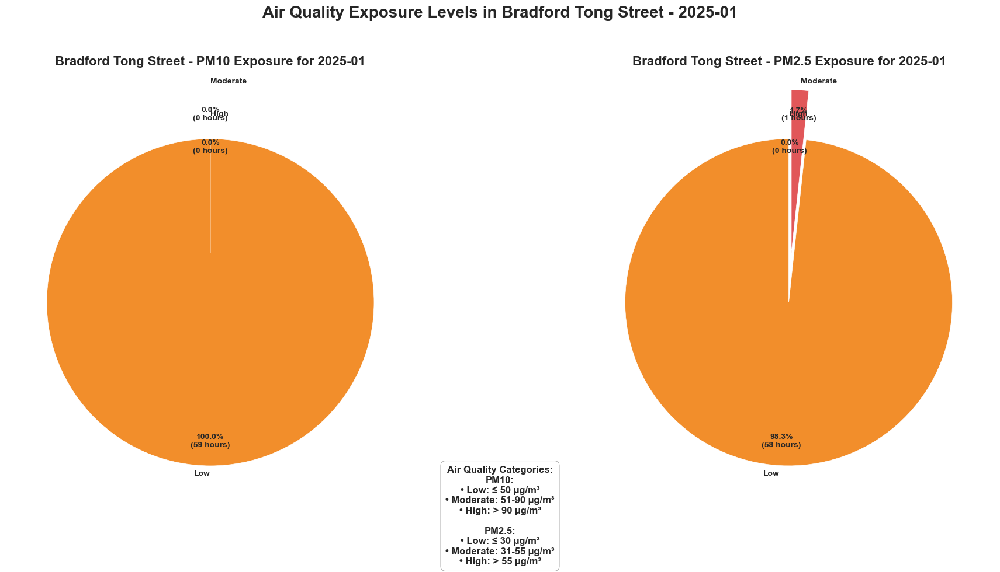


Exposure breakdown for Bradford Tong Street:

PM10 Exposure (hours):
Bradford Tong Street PM10 Category  High  Low  Moderate
Year-Month                                             
2024-11                                3  694        22
2024-12                                3  739         2
2025-01                                0   59         0

PM10 Percentage Exposure (%):
Bradford Tong Street PM10 Category      High         Low  Moderate
Year-Month                                                        
2024-11                             0.417246   96.522949  3.059805
2024-12                             0.403226   99.327957  0.268817
2025-01                             0.000000  100.000000  0.000000

PM2.5 Exposure (hours):
Bradford Tong Street PM2.5 Category  High  Low  Moderate
Year-Month                                              
2024-11                                 5  689        25
2024-12                                 3  741         0
2025-01                        

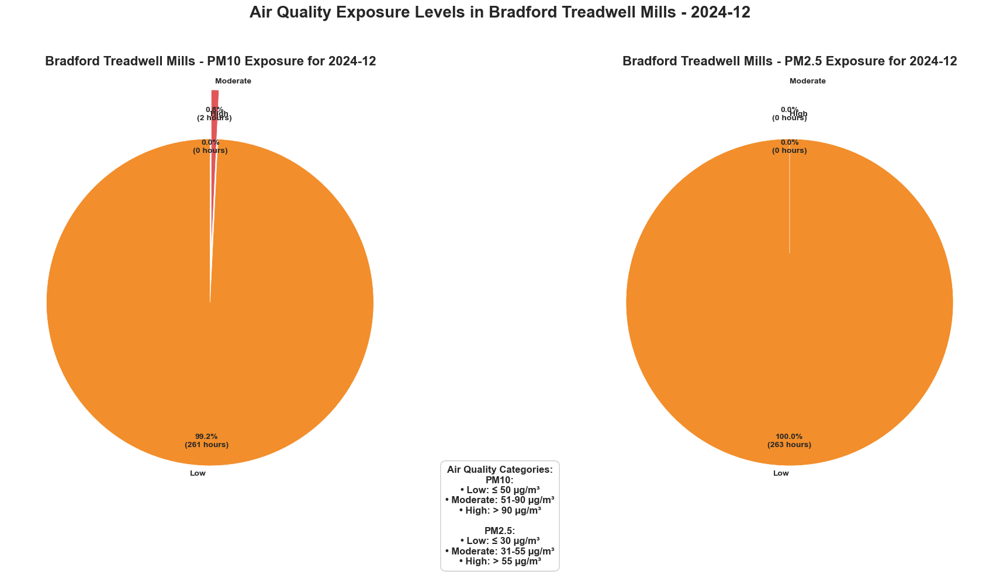

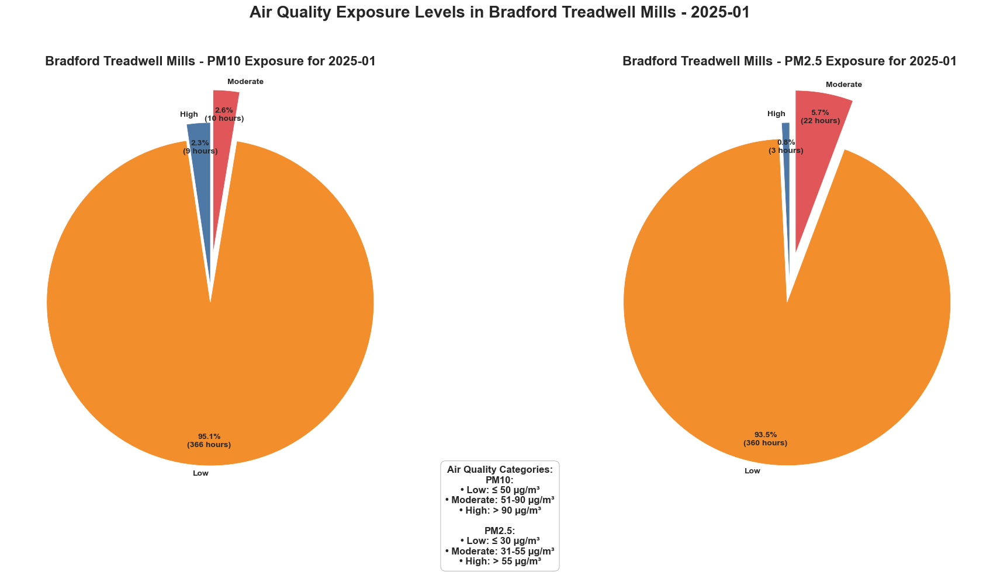


Exposure breakdown for Bradford Treadwell Mills:

PM10 Exposure (hours):
Bradford Treadwell Mills PM10 Category  High  Low  Moderate
Year-Month                                                 
2024-12                                    0  261         2
2025-01                                    9  366        10

PM10 Percentage Exposure (%):
Bradford Treadwell Mills PM10 Category      High        Low  Moderate
Year-Month                                                           
2024-12                                 0.000000  99.239544  0.760456
2025-01                                 2.337662  95.064935  2.597403

PM2.5 Exposure (hours):
Bradford Treadwell Mills PM2.5 Category  High  Low  Moderate
Year-Month                                                  
2024-12                                     0  263         0
2025-01                                     3  360        22

PM2.5 Percentage Exposure (%):
Bradford Treadwell Mills PM2.5 Category      High         Low  Moderate
Ye

In [ ]:
# Ensure 'Date Time' is in datetime format
bradford_final['Date Time'] = pd.to_datetime(bradford_final['Date Time'])

# Extract year and month for grouping
bradford_final['Year-Month'] = bradford_final['Date Time'].dt.to_period('M')

# Function to categorize PM levels
def categorize_pm10(value):
    if value <= 50:
        return 'Low'
    elif value <= 90:
        return 'Moderate'
    else:
        return 'High'

def categorize_pm25(value):
    if value <= 30:
        return 'Low'
    elif value <= 55:
        return 'Moderate'
    else:
        return 'High'

# List of locations and their corresponding column names
locations = [
    ('Bradford Keighley', 'Bradford Keighley PM10', 'Bradford Keighley PM2.5'),
    ('Bradford Tong Street', 'Bradford Tong Street PM10', 'Bradford Tong Street PM2.5'),
    ('Bradford Treadwell Mills', 'Bradford Treadwell Mills PM10', 'Bradford Treadwell Mills PM2.5')
]

# Set up the plot style for a professional look
sns.set_style("whitegrid")
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']
plt.rcParams['font.size'] = 12
plt.rcParams['font.weight'] = 'bold'

# Define professional colors for the chart
colors = ['#4e79a7', '#f28e2b', '#e15759']

# Function to make labels for pie chart
def make_autopct(values):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct * total / 100.0))
        return f'{pct:.1f}%\n({val:,d} hours)'
    return my_autopct

# Set up a dictionary to store the monthly breakdown for each location
monthly_breakdown = {}

# Loop over locations
for location, pm10_col, pm25_col in locations:
    # Apply categorization (exclude rows with missing data in PM10 or PM2.5 columns)
    bradford_final[f'{location} PM10 Category'] = bradford_final[pm10_col].apply(categorize_pm10)
    bradford_final[f'{location} PM2.5 Category'] = bradford_final[pm25_col].apply(categorize_pm25)

    # Filter out rows with missing PM10 or PM2.5 data
    valid_data = bradford_final.dropna(subset=[pm10_col, pm25_col])

    # Group by Year-Month and calculate the exposure per category
    pm10_exposure_monthly = valid_data.groupby(['Year-Month', f'{location} PM10 Category']).size().unstack(fill_value=0)
    pm25_exposure_monthly = valid_data.groupby(['Year-Month', f'{location} PM2.5 Category']).size().unstack(fill_value=0)

    # Calculate percentage exposure for each category
    pm10_percentage_monthly = pm10_exposure_monthly.div(pm10_exposure_monthly.sum(axis=1), axis=0) * 100
    pm25_percentage_monthly = pm25_exposure_monthly.div(pm25_exposure_monthly.sum(axis=1), axis=0) * 100

    # Store the results in the dictionary
    monthly_breakdown[location] = {
        'PM10 Exposure': pm10_exposure_monthly,
        'PM10 Percentage': pm10_percentage_monthly,
        'PM2.5 Exposure': pm25_exposure_monthly,
        'PM2.5 Percentage': pm25_percentage_monthly
    }

    # Plotting PM10 and PM2.5 Exposure categories using pie charts
    for month in valid_data['Year-Month'].unique():
        # Filter data for the specific month
        pm10_exposure_for_month = pm10_exposure_monthly.loc[month]
        pm25_exposure_for_month = pm25_exposure_monthly.loc[month]

        # Create subplots for PM10 and PM2.5 exposure for the month
        fig, axes = plt.subplots(1, 2, figsize=(20, 10))

        # Explode slices
        explode = (0, 0.1, 0.2)

        # PM10 Exposure Pie chart
        wedges, texts, autotexts = axes[0].pie(pm10_exposure_for_month, labels=pm10_exposure_for_month.index,
                                               colors=colors, autopct=make_autopct(pm10_exposure_for_month),
                                               startangle=90, explode=explode, pctdistance=0.85, labeldistance=1.05)
        axes[0].set_title(f'{location} - PM10 Exposure for {month}', fontsize=16, fontweight='bold', pad=20)

        # PM2.5 Exposure Pie chart
        wedges, texts, autotexts = axes[1].pie(pm25_exposure_for_month, labels=pm25_exposure_for_month.index,
                                               colors=colors, autopct=make_autopct(pm25_exposure_for_month),
                                               startangle=90, explode=explode, pctdistance=0.85, labeldistance=1.05)
        axes[1].set_title(f'{location} - PM2.5 Exposure for {month}', fontsize=16, fontweight='bold', pad=20)

        # Enhance text appearance
        for ax in axes:
            for autotext in ax.texts:
                autotext.set_fontsize(10)
                autotext.set_fontweight('bold')

        # Add a title for the entire figure
        fig.suptitle(f'Air Quality Exposure Levels in {location} - {month}',
                     fontsize=20, fontweight='bold', y=0.98)

        # Add text box with additional information
        text_box = (
            "Air Quality Categories:\n"
            "PM10:\n"
            "• Low: ≤ 50 µg/m³\n"
            "• Moderate: 51-90 µg/m³\n"
            "• High: > 90 µg/m³\n\n"
            "PM2.5:\n"
            "• Low: ≤ 30 µg/m³\n"
            "• Moderate: 31-55 µg/m³\n"
            "• High: > 55 µg/m³"
        )

        fig.text(0.5, 0.02, text_box, ha='center', va='bottom', fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', edgecolor='gray', alpha=0.8))

        plt.tight_layout()
        plt.subplots_adjust(top=0.85, bottom=0.15)
        plt.show()

    # Print the exposure breakdown for each month
    print(f"\nExposure breakdown for {location}:")
    print("\nPM10 Exposure (hours):")
    print(pm10_exposure_monthly)
    print("\nPM10 Percentage Exposure (%):")
    print(pm10_percentage_monthly)
    print("\nPM2.5 Exposure (hours):")
    print(pm25_exposure_monthly)
    print("\nPM2.5 Percentage Exposure (%):")
    print(pm25_percentage_monthly)

# Optionally, you can save the plots as images if needed


In [ ]:

# If more time was available, I would have focused on expanding the analysis and gaining deeper insights by addressing key areas in air quality investigation.

# I. Investigating the January 16th PM10 Spike:
# - PM10 spike at Keighley and Treadwell Mills on January 16th requires a deeper investigation. I would have taken the following steps:
#   1. Correlated PM10 data with meteorological data (temperature, wind speed, wind direction, precipitation) for the day and surrounding days.
#      - This would help to identify any weather patterns contributing to the spike.
#   2. Analyzed traffic data around the monitoring stations to see if increased traffic volume was a factor.
#   3. Explored the possibility of conducting a back trajectory analysis to trace the origin of the air mass affecting Bradford.
#   4. Researched local events on January 16th to investigate potential pollution sources (e.g., construction, industrial activity).

# II. Addressing Data Quality Issues:
# - To improve data quality, especially with negative PM2.5/PM10 values and PM2.5 > PM10 inconsistencies, I would have:
#   1. Contacted the equipment vendor or maintenance team to understand the errors and their possible causes.
#   2. Reviewed instrument calibration logs and maintenance records for potential issues with equipment.
#   3. Investigated the data logging system for possible errors or temperature-related issues.
#   4. Explored advanced imputation techniques (e.g., time series analysis, regression models) to handle missing data more accurately.
#   5. Implemented data validation checks to prevent future data quality issues.

# III. Enhancing Air Quality Analysis:
# - I would have expanded the air quality analysis to provide more detailed insights:
#   1. Conducted a more detailed time series analysis to identify trends, seasonality, and temporal patterns in PM2.5 and PM10 levels.
#   2. Performed correlation analysis to explore relationships between pollutant levels and other variables (e.g., weather data, traffic volume, time of day).
#   3. If available, included data from additional monitoring sites in Bradford to perform a spatial analysis of air quality across the district.

# IV. Deepening Exposure Analysis:
# - To refine the exposure analysis, I would have:
#   1. Used more granular exposure categories based on health guidelines for a detailed population exposure assessment.
#   2. Calculated population-weighted exposure estimates, if population data were available, to assess the impact of air pollution on different communities more accurately.

# V. Developing Predictive Models:
# - I would have explored predictive modeling techniques to forecast future PM2.5 and PM10 levels:
#   1. This could provide valuable tools for air quality management, alerting authorities to potential pollution spikes.

# VI. Creating Interactive Visualizations:
# - I would have developed interactive visualizations to present the air quality data:
#   1. Interactive visualizations would make the data more accessible and engaging for elected officials and the public.
#   2. They would allow stakeholders to explore the data and gain insights more easily.

